In [1]:
import pandas as pd
import yfinance as yf
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime
import statsmodels.api as sm
from scipy.signal import butter,filtfilt
from matplotlib import colors as mcolors
from sklearn.linear_model import LinearRegression
from random import sample
from tslearn.clustering import TimeSeriesKMeans
from tslearn.utils import to_time_series_dataset
from tslearn.shapelets import LearningShapelets
from collections import Counter

#### This notebook offers a walk-through to show how the market regime label works and offers Visualization of results to tune the parameters for your dataset.

#### Methods and Visulization included
1. Band-pass filter
2. Deterministic trend(linear model)
3. Cross-validation of 2 with clustering
4. TSNE plot of 2 and 3
5. Length-constrained deterministic trend
6. Stock clustering 

In [2]:
def preprocess(data):
    data=data['Adj Close']
    data=data.reset_index()
    data=data.rename(columns={ 'Date': 'date'})
    data_dict={}
    tics=[tic for tic in data.columns][1:]
    for tic in tics:
        temp=data.loc[:,['date',tic]]
        temp.rename(columns={tic:'adjcp'},inplace=True)
        temp=temp.assign(pct_return=temp['adjcp'].pct_change().fillna(0),log_rtn=(np.log(temp.adjcp) - np.log(temp.adjcp.shift(1))).fillna(0))
        data_dict[tic]=temp
    return data_dict,tics
def apply_to_all(tics,dataset,function):
    for tic in tics:
        function(dataset[tic])
def plot_ori(data,name,titile_suffix=''):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax.plot(date, data['adjcp'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'_adjcp'+str(titile_suffix),fontsize=20)
    ax.grid(True)
def plot_pct(data,name):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax.plot(date, data['pct_return'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'pct_return',fontsize=20)
    ax.grid(True)
def plot_feature(data,name,feature):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax.plot(date, data[feature])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'_'+feature,fontsize=20)
    ax.grid(True)
def plot_both(data,name):
    plot_ori(data,name)
    plot_pct(data,name)
def plot_filter(data,name,low=6, high=32, K=12):
    # see sm.tsa.filters.bkfilter for more detail, this method is not applied to the pipline for now
    filtered_data=sm.tsa.filters.bkfilter(data[['adjcp','pct_return']],low,high,K)
    if isinstance(data['date'][0],str):
        date=data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date'][K:-K]
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot(date,filtered_data['adjcp_cycle'],label='adjcp_cycle')
    ax[1].plot(date,filtered_data['pct_return_cycle'],label='pct_return_cycle')
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp_cycle',fontsize=20)
    ax[1].set_title(name+'_pct_return_cycle',fontsize=20)
    ax[0].grid(True)
    ax[1].grid(True)
def butter_lowpass_filter(data, Wn, order):
    # suppose the data is sample at 7Hz (7days / week) so fs=7 and fn=7/2, we would like to eliminate volatility on weekly scale, then we should have
    # Wn=1/(7/2)=2/7 
    b, a = butter(order, Wn, btype='low', analog=False)
    y = filtfilt(b, a, data)
    return y
def adjcp_apply_filter(data,Wn_adjcp,Wn_pct,order):
    data['adjcp_filtered']=butter_lowpass_filter(data['adjcp'], Wn_adjcp, order)
    data['pct_return_filtered']=butter_lowpass_filter(data['pct_return'], Wn_pct, order)
def plot_by_suffix(data,name,data_suffix,savefig):
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax[0].plot(date, data['adjcp'+data_suffix])
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp'+data_suffix,fontsize=20)
    ax[1].plot(date, data['pct_return'+data_suffix])
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].set_title(name+'_pct_return'+data_suffix,fontsize=20)
    if savefig:
        fig.savefig('res/'+name+data_suffix+'.png')
def find_index_of_turning(data):
    turning_points=[0]
    data=data.reset_index(drop=True)
    for i in range(data['pct_return_filtered'].size-1):
        if data['pct_return_filtered'][i]*data['pct_return_filtered'][i+1]<0:
            turning_points.append(i+1)
    if turning_points[-1]!=data['pct_return_filtered'].size:
        turning_points.append(data['pct_return_filtered'].size)
    return turning_points
def linear_regession_turning_points(data_ori,tic,length_constrain=0):
    data=data_ori.reset_index(drop=True)
    turning_points=find_index_of_turning(data)
    turning_points_new=[turning_points[0]]
    if length_constrain!=0:
        for i in range(1,len(turning_points)-1):
            if turning_points[i]-turning_points_new[-1]>=length_constrain:
                turning_points_new.append(turning_points[i])
        turning_points_new.append(turning_points[-1])
        turning_points=turning_points_new
    coef_list=[]
    normalized_coef_list=[]
    y_pred_list=[]
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
#         print(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        adj_cp_model = LinearRegression().fit(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        y_pred = adj_cp_model.predict(x_seg)
        normalized_coef_list.append(100*adj_cp_model.coef_/data['adjcp_filtered'].iloc[turning_points[i]])
        coef_list.append(adj_cp_model.coef_)
        y_pred_list.append(y_pred)
    return np.asarray(coef_list),np.asarray(turning_points),y_pred_list,normalized_coef_list
def regime_flag(regime_num,coef,parameters):
    seg1,seg2,seg3=parameters
    if regime_num==4:
        if coef<=seg1:
            flag=0
        elif coef>seg1 and coef<=seg2:
            flag=1
        elif coef>seg2 and coef<=seg3:
            flag=2
        elif coef>seg3:
            flag=3
    elif regime_num==3:
        if coef<=seg1:
            flag=0
        elif coef>seg1 and coef<=seg3:
            flag=1
        elif coef>seg3:
            flag=2
    else:
        raise Exception('This regime num is currently not supported')
    return flag
def linear_regession_label(data,y_pred_list,turning_points,low,high,normalized_coef_list,cluster_metric,tic,regime_num=4):
    data=data.reset_index(drop=True)[cluster_metric]
    data_seg=[]
    seg1,seg2,seg3=sorted([low,high,0])
    label=[]
    label_seg=[]
    index_seg=[]
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        coef=normalized_coef_list[i]
        flag=regime_flag(regime_num,coef,[seg1,seg2,seg3])
        label.extend([flag]*(turning_points[i+1]-turning_points[i]))
        if turning_points[i+1]-turning_points[i]>2:
            data_seg.append(data.iloc[turning_points[i]:turning_points[i+1]].to_list())
            label_seg.append(flag)
            index_seg.append(tic+'_'+str(i))
    return label,data_seg,label_seg,index_seg
def linear_regession_plot(data,tic,y_pred_list,turning_points,low,high,savefig,normalized_coef_list,regime_num=4):
    data=data.reset_index(drop=True)
    fig, ax = plt.subplots(3, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    seg1,seg2,seg3=sorted([low,high,0])
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y_pred = y_pred_list[i]
        coef=normalized_coef_list[i]
        flag=regime_flag(regime_num,coef,[seg1,seg2,seg3])
        ax[1].plot(x_seg,y_pred,color=colors[flag], label='cat'+str(flag))
        ax[2].plot(x_seg,data['adjcp'].iloc[turning_points[i]:turning_points[i+1]],color=colors[flag], label='cat'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    ax[0].set_title(tic+'_linear_regression_regime',fontsize=20)
    if savefig:
        fig.savefig('res/linear_model/'+tic+'.png')
def linear_regession_timewindow(data_ori,tic,adjcp_timewindow):
    data=data_ori.iloc[:adjcp_timewindow*(data_ori['adjcp_filtered'].size//adjcp_timewindow),:]
    adjcp_window_data=[data[['adjcp_filtered']][i*adjcp_timewindow:(i+1)*adjcp_timewindow].to_numpy().reshape(-1) for i in range(data['adjcp_filtered'].size//adjcp_timewindow)]
    coef_list=[]
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    for i,data_seg in enumerate(adjcp_window_data):
        x_seg=np.asarray([i*adjcp_timewindow+j for j in range(adjcp_timewindow)]).reshape(-1, 1)
        adj_cp_model = LinearRegression().fit(x_seg,data_seg)
        y_pred = adj_cp_model.predict(x_seg)
        ax[1].plot([i*adjcp_timewindow+j for j in range(adjcp_timewindow)],y_pred)
        coef_list.append(adj_cp_model.coef_)
    return coef_list
def validation_plot(data,tic,cluster_metic,turning_point,savefig,seg_list,label_list,color_list):
    data_cluster=data.reset_index(drop=True)[cluster_metic]
    data_ori=data.reset_index(drop=True)['adjcp']
    data_filtered=data.reset_index(drop=True)['adjcp_filtered']
    fig, ax = plt.subplots(3, 1, figsize=(20, 10),constrained_layout=True)
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y=data_cluster.iloc[turning_points[i]:turning_points[i+1]]
        y_1=data_ori.iloc[turning_points[i]:turning_points[i+1]]
        y_2=data_filtered.iloc[turning_points[i]:turning_points[i+1]]
        if turning_points[i+1]-turning_points[i]<=1 or tic+'_'+str(i) not in seg_list :
            continue
        flag=label_list[seg_list.index(tic+'_'+str(i))]
        if color_list[flag]:
            c=color_list[flag]
        else:
            c=flag+len(color_list)
        ax[0].plot(x_seg,y,color=colors[c], label='cluster'+str(flag))
        ax[1].plot(x_seg,y_1,color=colors[c], label='cluster'+str(flag))
        ax[2].plot(x_seg,y_2,color=colors[c], label='cluster'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    ax[0].set_title(tic+'_linear_regression_crossvalidation',fontsize=20)
    if savefig:
        fig.savefig('res/linear_model/'+tic+'_cross_validation.png')

# Data download and preprocessing

In [3]:
ticks=' '.join(list(pd.read_csv('../data/dj30/dj30.csv')['tic'].unique()))

In [4]:
nasdaq=yf.download (tickers = ticks, start = "2012-01-01",
                              end = "2022-01-01", interval = "1d").dropna(axis=1)

[*********************100%***********************]  29 of 29 completed


In [5]:
data_dict,tics=preprocess(nasdaq)

# Data descrption and Basic manipulation

In [6]:
display(data_dict[tics[0]].head())

,date,adjcp,pct_return,log_rtn
0,2012-01-03,12.519278,0.000000,0.000000
1,2012-01-04,12.586558,0.005374,0.005360
2,2012-01-05,12.726294,0.011102,0.011041
3,2012-01-06,12.859334,0.010454,0.010400
4,2012-01-09,12.838935,-0.001586,-0.001588


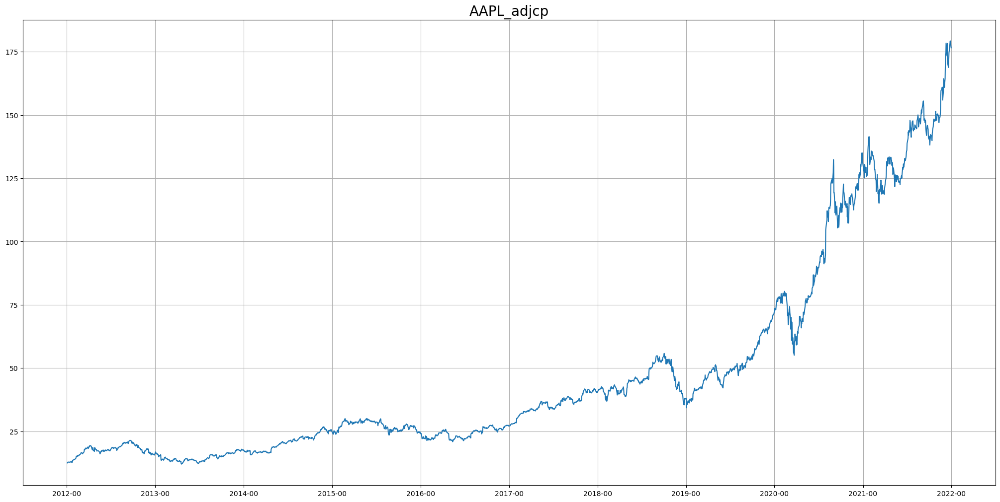

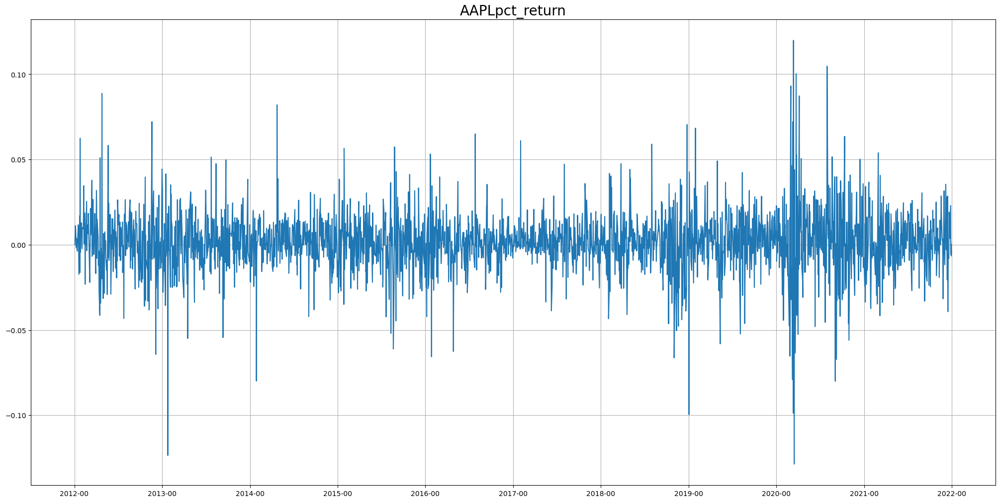

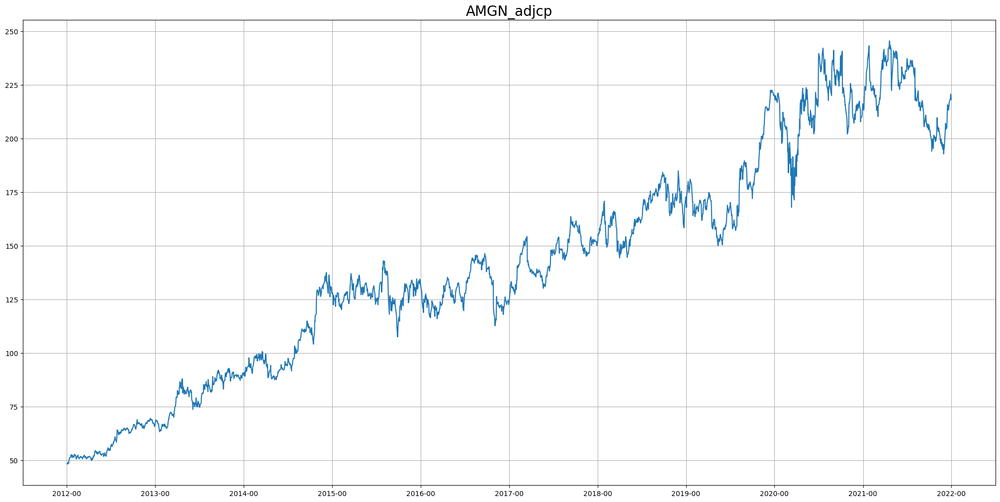

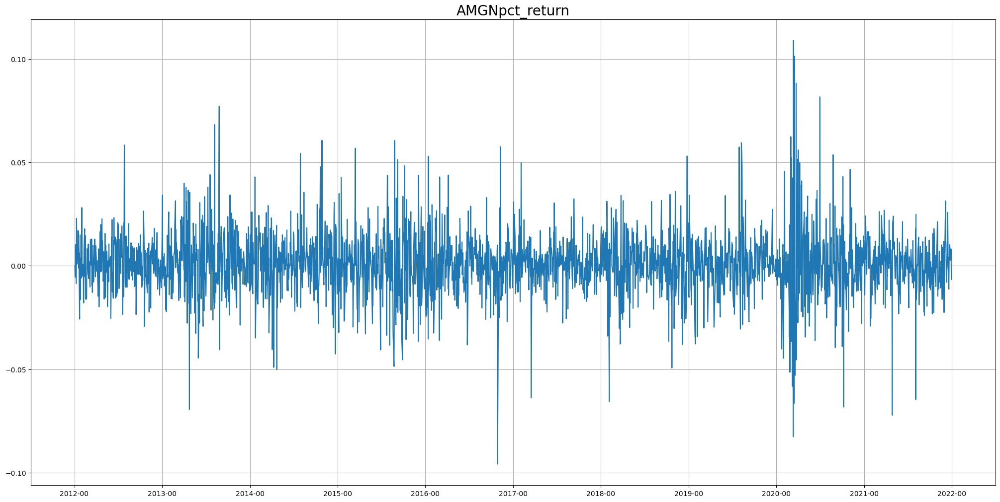

In [7]:
for i,tic in enumerate(tics):
    plot_both(data_dict[tic],tic)
    if i>0:
        break

# band-pass filter

In [8]:
for tic in tics:
    #It is strongly recommended to adjust the Wn based on different data. 
    #You can refer to https://en.wikipedia.org/wiki/Butterworth_filter for parameter setting 
    adjcp_apply_filter(data_dict[tic],Wn_adjcp=2/7,Wn_pct=2/14,order = 4)

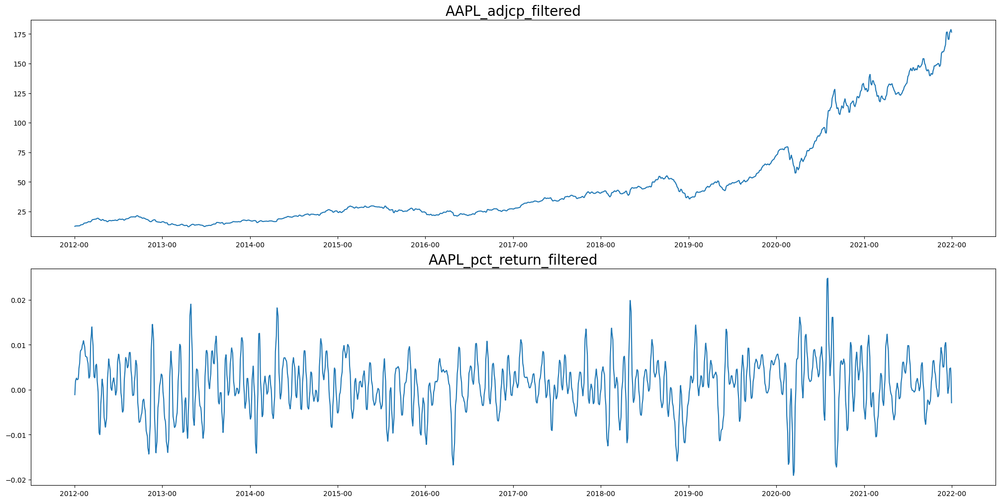

In [9]:
for i,tic in enumerate(tics):
    #It is strongly recommended to adjust the Wn based on different data. 
    #You can refer to https://en.wikipedia.org/wiki/Butterworth_filter for parameter setting 
    adjcp_apply_filter(data_dict[tic],Wn_adjcp=2/7,Wn_pct=2/14,order = 4)
    if i<1:
        plot_by_suffix(data_dict[tic],tic,'_filtered',savefig=False)
        plt.show()

# Min_Max normalization

In [10]:
def MinMaxScaler(data):
    numerator = data - np.min(data, 0)
    denominator = np.max(data, 0) - np.min(data, 0)
    norm_data = numerator / (denominator + 1e-7)
    return norm_data

In [11]:
for tic in tics:
    data_dict[tic]['adjcp_filtered_normalized']=MinMaxScaler(data_dict[tic]['adjcp_filtered'])
    data_dict[tic]['pct_return_filtered_normalized']=MinMaxScaler(data_dict[tic]['pct_return_filtered'])

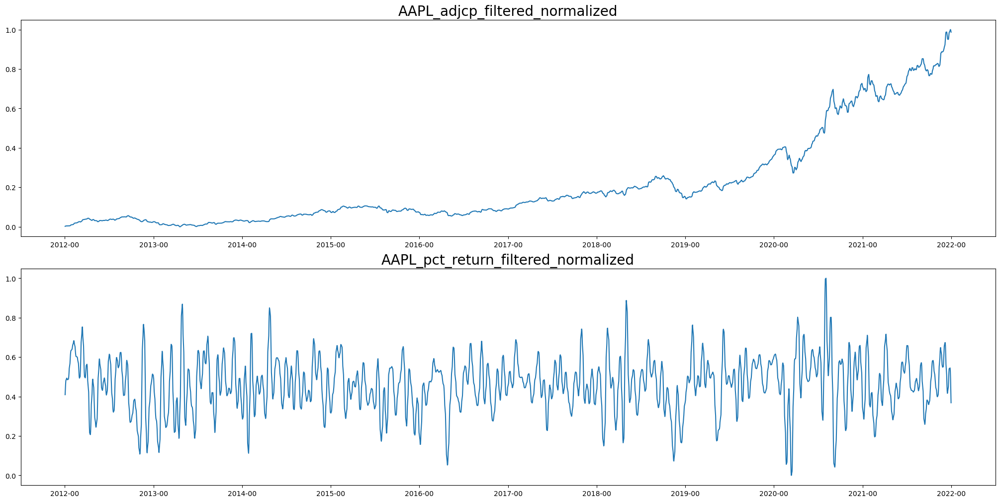

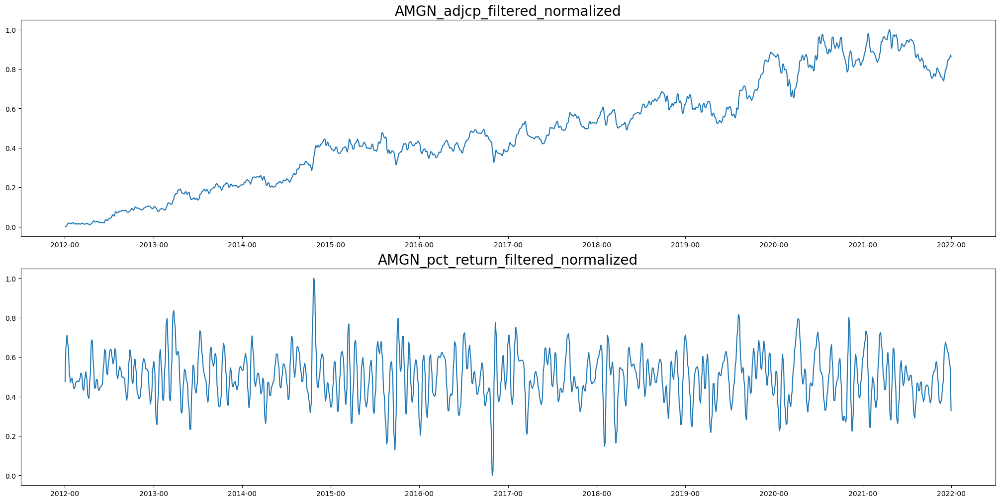

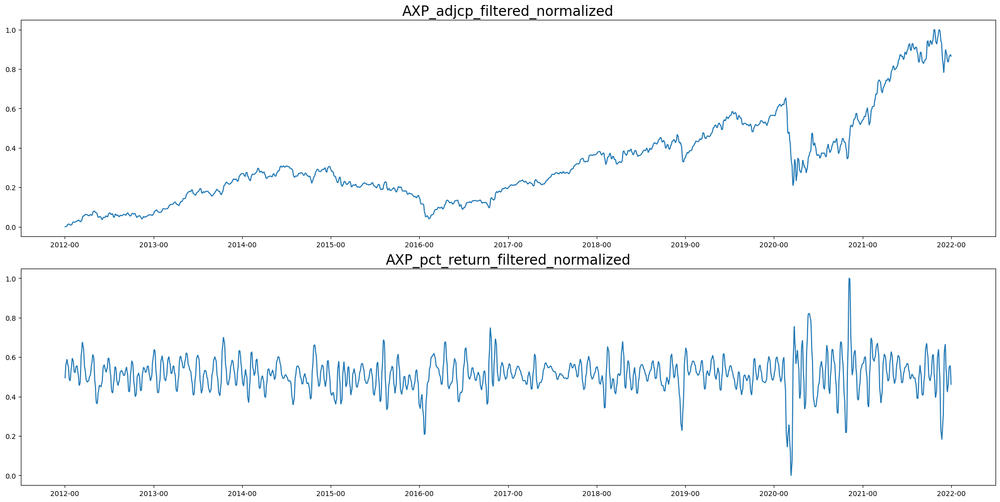

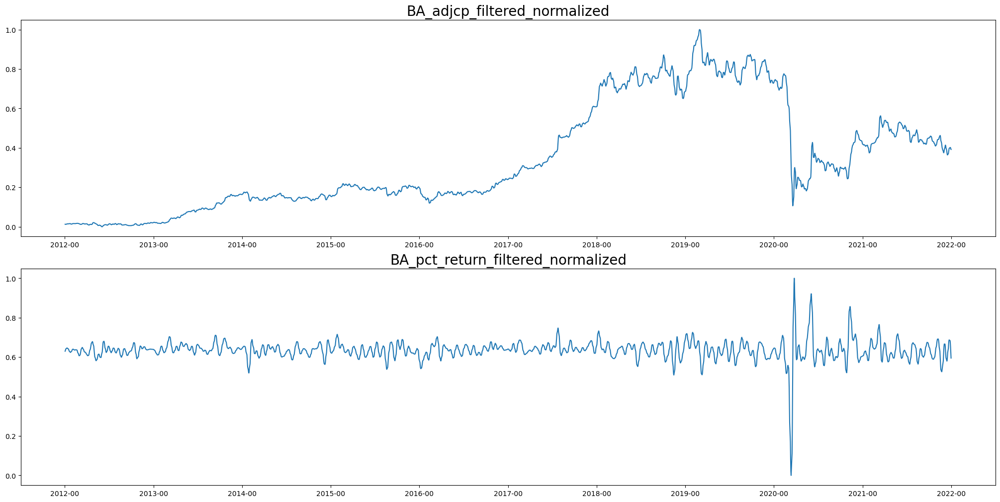

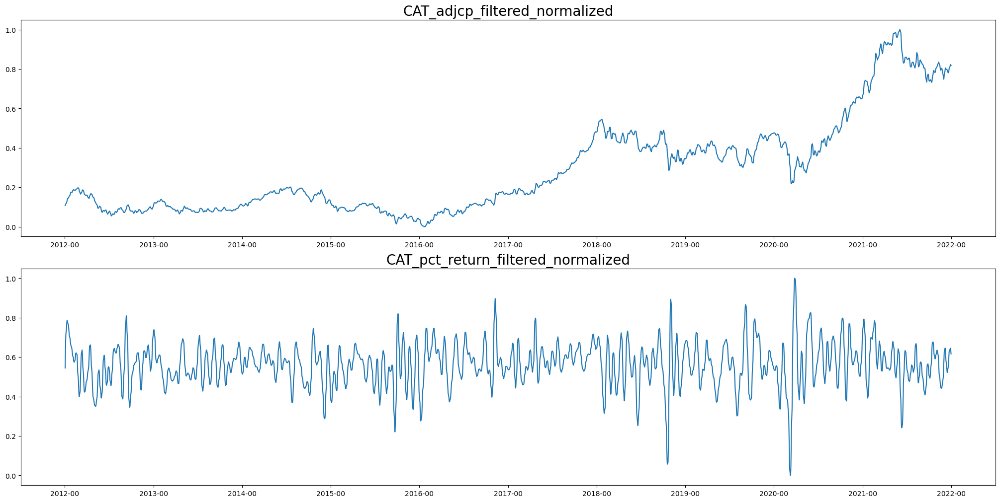

...

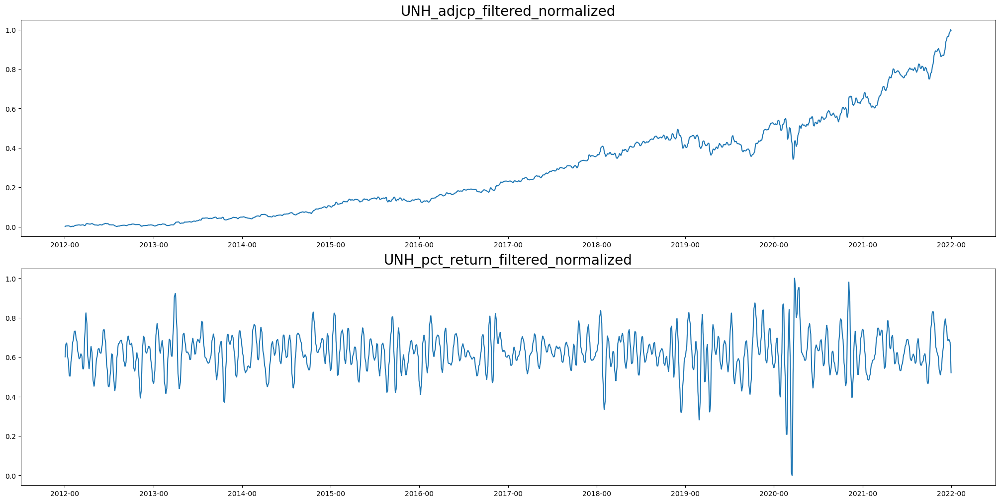

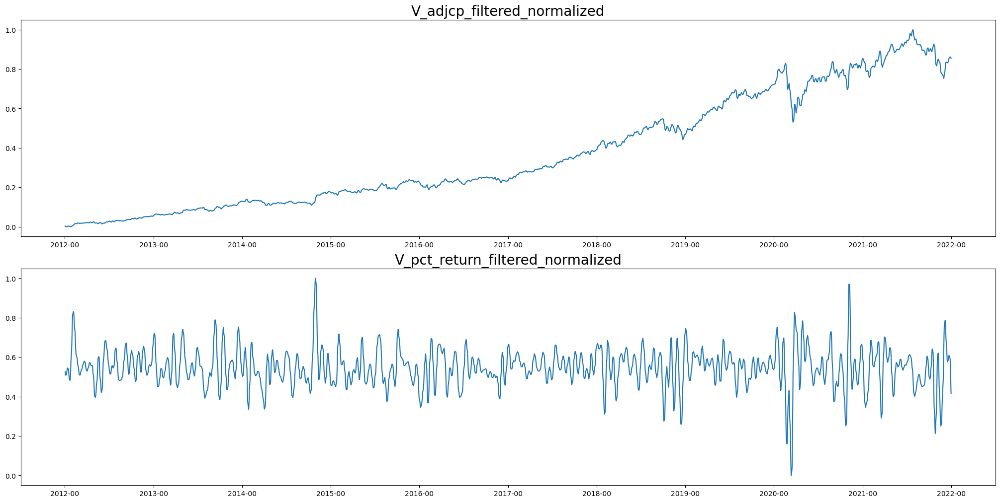

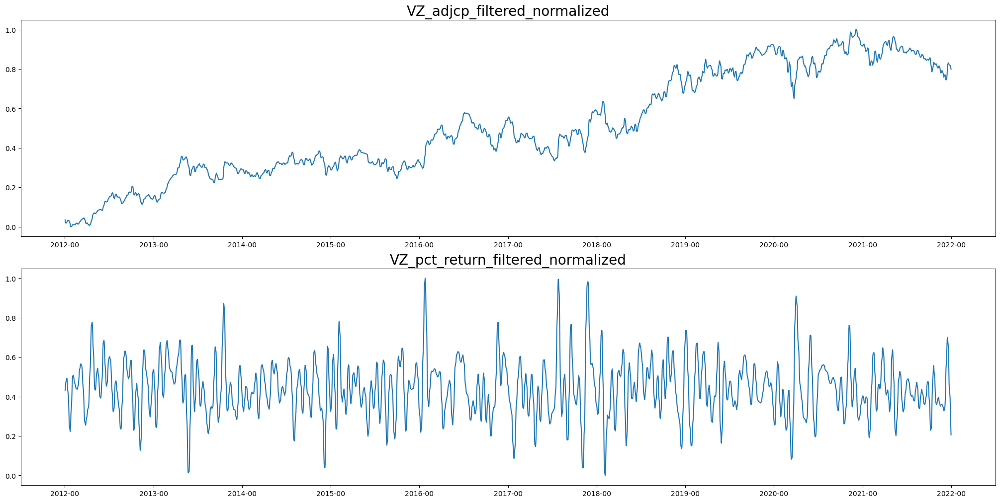

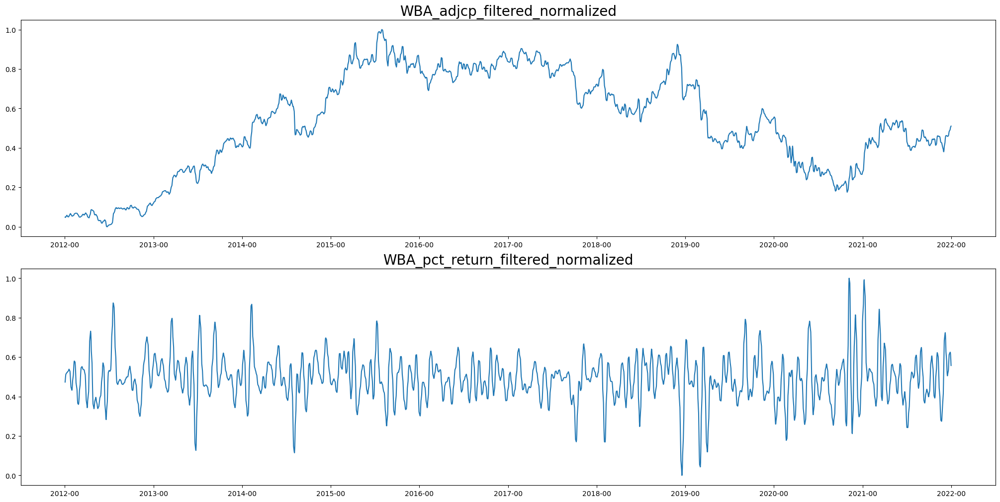

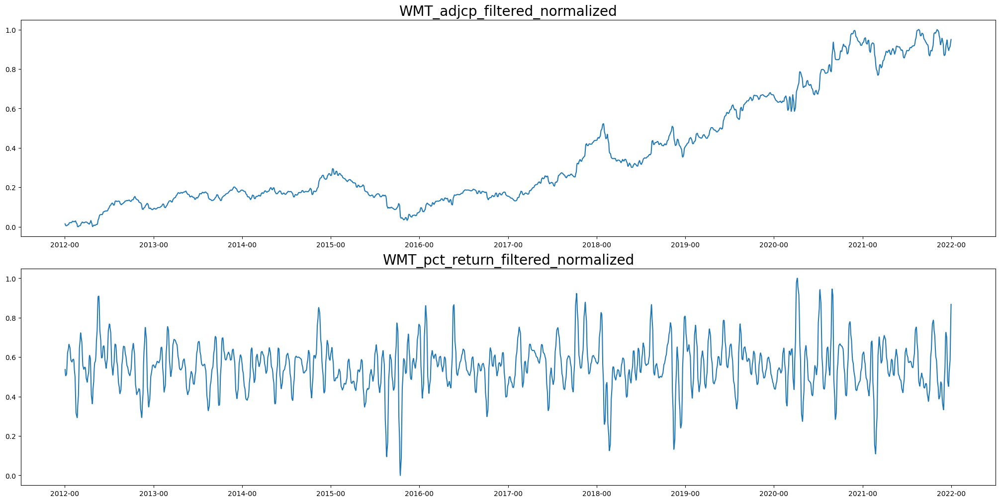

In [12]:
for tic in tics:
    plot_by_suffix(data_dict[tic],tic,'_filtered_normalized',savefig=False)
    plt.show()

# Deterministic Trends(linear model)

In [13]:
turning_points_dict={}
coef_list_dict={}
norm_coef_list_dict={}
y_pred_dict={}
for i,tic in enumerate(tics):
    coef_list,turning_points,y_pred_list,norm_coef_list=linear_regession_turning_points(data_ori=data_dict[tic],tic=tic)
    turning_points_dict[tic]=turning_points
    coef_list_dict[tic]=coef_list
    y_pred_dict[tic]=y_pred_list
    norm_coef_list_dict[tic]=norm_coef_list

In [14]:
all_coef_list=np.vstack([array for array in norm_coef_list_dict.values()])

In [15]:
coef_stats=pd.DataFrame(all_coef_list).describe()
display(coef_stats)
percent_25=coef_stats.loc['25%',0]
percent_75=coef_stats.loc['75%',0]

,0
count,5721.000000
mean,0.019139
std,0.571766
min,-3.152755
25%,-0.376463
50%,0.021413
75%,0.407457
max,5.085276


The low and high threshold for regime classification is adjustable.A value of -0.5 and 0.5 stand for -0.5% and 0.5% change per step.

In [50]:
def run_linear_model(metric,tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,plot,savefig,regime_num=4,low=-0.5,high=0.5):
    all_data_seg=[]
    all_label_seg=[]
    all_index_seg=[]
    for i,tic in enumerate(tics):
        turning_points=turning_points_dict[tic]
        coef_list=coef_list_dict[tic]
        y_pred_list=y_pred_dict[tic]
        norm_coef_list=norm_coef_list_dict[tic]
        label,data_seg,label_seg,index_seg=linear_regession_label(data_dict[tic],y_pred_list,turning_points,low,high,norm_coef_list,metric,tic,regime_num)
    #     display(data_seg[0])
        all_data_seg.extend(data_seg)
        all_label_seg.extend(label_seg)
        all_index_seg.extend(index_seg)
        data_dict[tic]['label']=label
        if plot and plot>i:
            linear_regession_plot(data_dict[tic],tic,y_pred_list,turning_points,low,high,savefig=savefig,normalized_coef_list=norm_coef_list,regime_num=regime_num)
    return all_data_seg,all_label_seg,all_index_seg

### The following sets of plots are (raw data, deterministic trend with regimes labeled, raw data with regimes labeled) of each stock

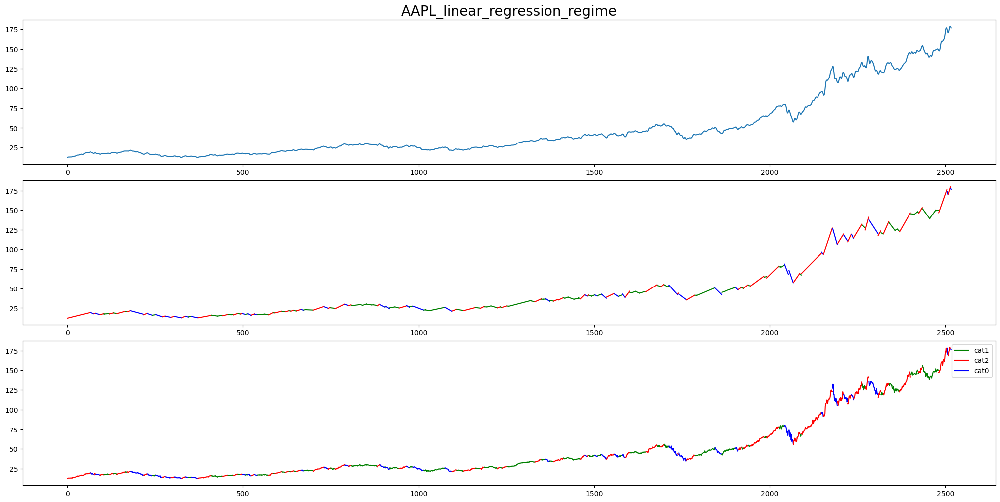

In [17]:
adjcp_data_seg,all_label_seg,all_index_seg=run_linear_model('adjcp_filtered_normalized',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,1,False)
pct_return_normalized_data_seg,all_label_seg,all_index_seg=run_linear_model('pct_return_filtered_normalized',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,False,False)
pct_return_data_seg,all_label_seg,all_index_seg=run_linear_model('pct_return_filtered',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,False,False)

#  Cross validation

We use multiple cluster methods to cross validate how our deterministic trend method

In [24]:
def cross_validate(label,model,number):
    c_list=[Counter() for _ in range(4)]
    c=Counter()
    for i in range(len(all_label_seg)):
        c_list[all_label_seg[i]][label[i]]+=1
        c[label[i]]+=1
    cluster_num_counter=Counter(label)
    color_list=[None for _ in range(model.n_clusters)]
    display(c,c_list)
    for i,c in enumerate(c_list):
        l,count=c.most_common(1)[0]
        color_list[l]=i
        total=c.total()
        percent=count/total
        print('The major cluster of regime '+str(i)+' is '+str(l)+'. '+str(round(percent,2))+' of this regime is in this cluster. '
             +str(round(count/cluster_num_counter[l],2))+' of this laebl is in this regime')
#     color_list=[i for i in range(model.n_clusters)]
    for i,tic in enumerate(tics):
        turning_points=turning_points_dict[tic]
        coef_list=coef_list_dict[tic]
        y_pred_list=y_pred_dict[tic]
        norm_coef_list=norm_coef_list_dict[tic]
#         linear_regession_plot(data_dict[tic],tic,y_pred_list,turning_points,-0.5,0.5,savefig=False,normalized_coef_list=norm_coef_list)
        if number>i:
            validation_plot(data_dict[tic],tic,'pct_return_filtered',turning_points,False,all_index_seg,label,color_list)

## dwt cluster

In [ ]:
fitting_data=to_time_series_dataset(pct_return_data_seg)
km=TimeSeriesKMeans(n_clusters=6, metric="dtw", max_iter=50,max_iter_barycenter=100,n_jobs=50,verbose=1).fit(fitting_data)

In [ ]:
label=km.predict(fitting_data)

Counter({1: 1158, 0: 1771, 2: 2362, 5: 155, 3: 101, 4: 8})

[Counter({0: 690, 5: 154, 2: 92, 4: 8}),
 Counter({2: 687, 0: 1071, 5: 1}),
 Counter({2: 1393, 1: 411, 0: 9}),
 Counter({1: 747, 2: 190, 3: 101, 0: 1})]

The major cluster of regime 0 is 0. 0.73 of this regime is in this cluster. 0.39 of this laebl is in this regime
The major cluster of regime 1 is 0. 0.61 of this regime is in this cluster. 0.6 of this laebl is in this regime
The major cluster of regime 2 is 2. 0.77 of this regime is in this cluster. 0.59 of this laebl is in this regime
The major cluster of regime 3 is 1. 0.72 of this regime is in this cluster. 0.65 of this laebl is in this regime


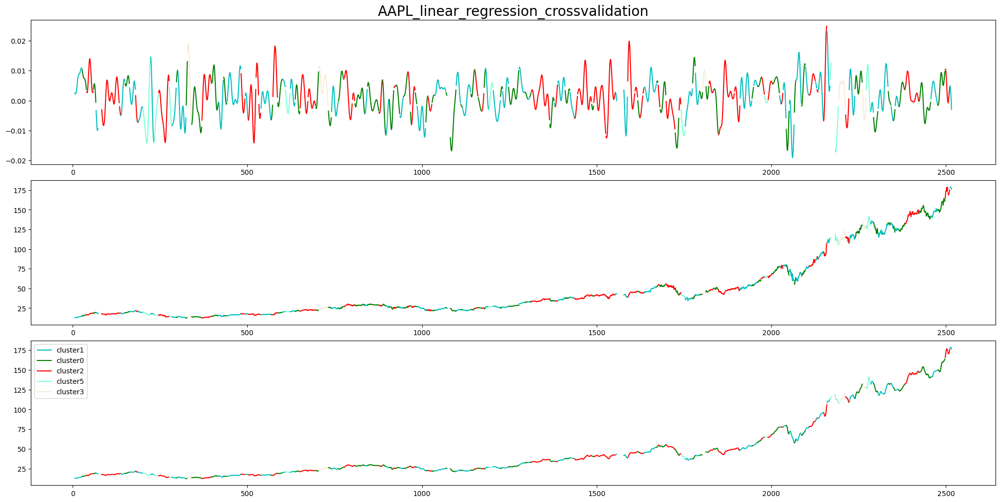

In [33]:
cross_validate(label,km,1)

## KNN

KNN is less convincing in this example, but you can try it on your dataset 

In [ ]:
from tslearn.clustering import KernelKMeans
gak_km = KernelKMeans(n_clusters=6, kernel="gak",verbose=2,n_jobs=50)
labels_gak = gak_km.fit_predict(fitting_data)

In [ ]:
cross_validate(labels_gak,gak_km,1)

# T-SNE

We regard each time-serie as an vector of a single dim and stack all vetors as multiple dims

In [64]:
from sklearn.manifold import TSNE

Interpolate the normalizaed adjcp/pct_return

In [149]:
def interpolation(data):
    max_len=max([len(d) for d in data])
    for i,d in enumerate(data):
        l=len(d)
        to_fill=max_len-l
        if to_fill!=0:
            interval=max_len//to_fill
            for j in range(to_fill):
                idx=(interval+1)*j+interval
                data[i].insert(min(idx,len(data[i])-1),float('nan'))
        data[i]=pd.Series(data[i]).interpolate(method='polynomial', order=2)
    return data

In [150]:
interpolated_pct_return_data_seg=np.array(interpolation(pct_return_data_seg))

In [ ]:
tsne = TSNE(n_components = 2, verbose = 1, perplexity = 40, n_iter = 300)
tsne_results = tsne.fit_transform(interpolated_pct_return_data_seg)

In [172]:
def TSNE_plot(data,label_list):
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    for i in range(len(data)-1):
        label=label_list[i]
        ax.scatter(data[i][0],data[i][1],color=colors[label], alpha = 0.2,label='cluster'+str(label))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    plt.title('TSNE',fontsize=20)

TSNE of linear model

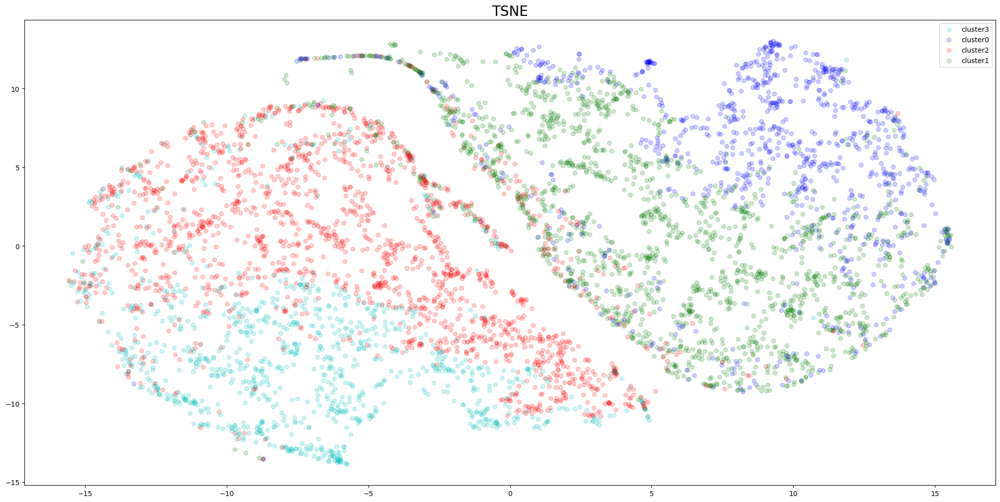

In [173]:
TSNE_plot(tsne_results,all_label_seg)

TSNE of DWT

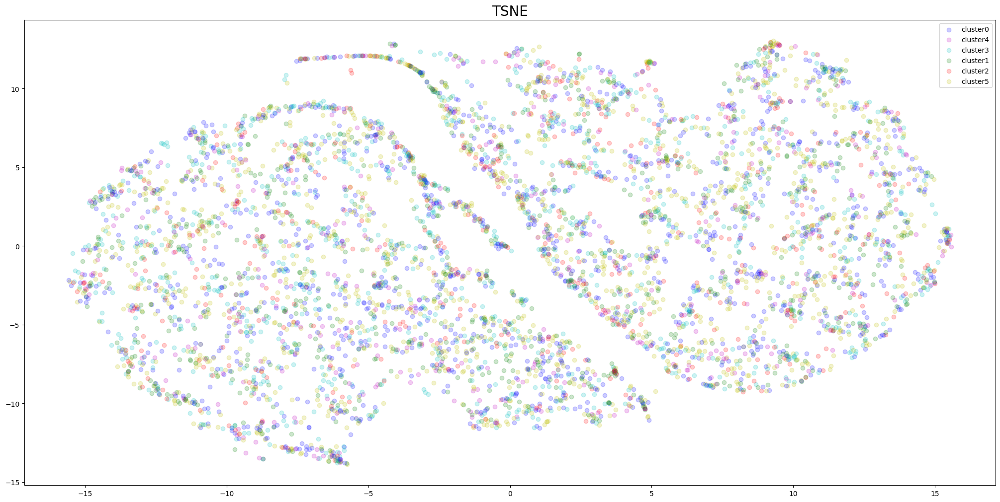

In [176]:
TSNE_plot(tsne_results,dwt_label)

TSNE of KNN

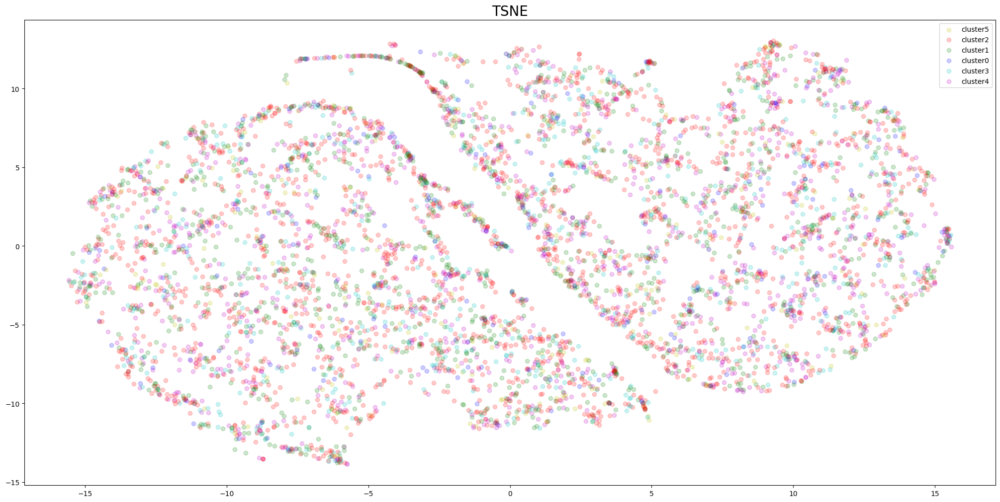

In [178]:
TSNE_plot(tsne_results,labels_gak)

# QQ_plot

In [18]:
import numbers

def qqplot(x, y, quantiles=None, interpolation='nearest', ax=None, rug=False,
           rug_length=0.05, rug_kwargs=None, **kwargs):
    """Draw a quantile-quantile plot for `x` versus `y`.

    Parameters
    ----------
    x, y : array-like
        One-dimensional numeric arrays.

    ax : matplotlib.axes.Axes, optional
        Axes on which to plot. If not provided, the current axes will be used.

    quantiles : int or array-like, optional
        Quantiles to include in the plot. This can be an array of quantiles, in
        which case only the specified quantiles of `x` and `y` will be plotted.
        If this is an int `n`, then the quantiles will be `n` evenly spaced
        points between 0 and 1. If this is None, then `min(len(x), len(y))`
        evenly spaced quantiles between 0 and 1 will be computed.

    interpolation : {‘linear’, ‘lower’, ‘higher’, ‘midpoint’, ‘nearest’}
        Specify the interpolation method used to find quantiles when `quantiles`
        is an int or None. See the documentation for numpy.quantile().

    rug : bool, optional
        If True, draw a rug plot representing both samples on the horizontal and
        vertical axes. If False, no rug plot is drawn.

    rug_length : float in [0, 1], optional
        Specifies the length of the rug plot lines as a fraction of the total
        vertical or horizontal length.

    rug_kwargs : dict of keyword arguments
        Keyword arguments to pass to matplotlib.axes.Axes.axvline() and
        matplotlib.axes.Axes.axhline() when drawing rug plots.

    kwargs : dict of keyword arguments
        Keyword arguments to pass to matplotlib.axes.Axes.scatter() when drawing
        the q-q plot.
    """
    # Get current axes if none are provided
    if ax is None:
        ax = plt.gca()

    if quantiles is None:
        quantiles = min(len(x), len(y))

    # Compute quantiles of the two samples
    if isinstance(quantiles, numbers.Integral):
        quantiles = np.linspace(start=0, stop=1, num=int(quantiles))
    else:
        quantiles = np.atleast_1d(np.sort(quantiles))
    x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
    y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)

    # Draw the rug plots if requested
    if rug:
        # Default rug plot settings
        rug_x_params = dict(ymin=0, ymax=rug_length, c='gray', alpha=0.5)
        rug_y_params = dict(xmin=0, xmax=rug_length, c='gray', alpha=0.5)

        # Override default setting by any user-specified settings
        if rug_kwargs is not None:
            rug_x_params.update(rug_kwargs)
            rug_y_params.update(rug_kwargs)

        # Draw the rug plots
        for point in x:
            ax.axvline(point, **rug_x_params)
        for point in y:
            ax.axhline(point, **rug_y_params)

    # Draw the q-q plot
    ax.scatter(x_quantiles, y_quantiles, **kwargs)

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


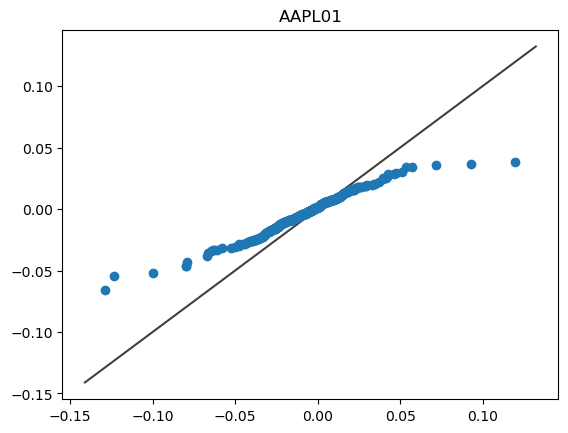

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


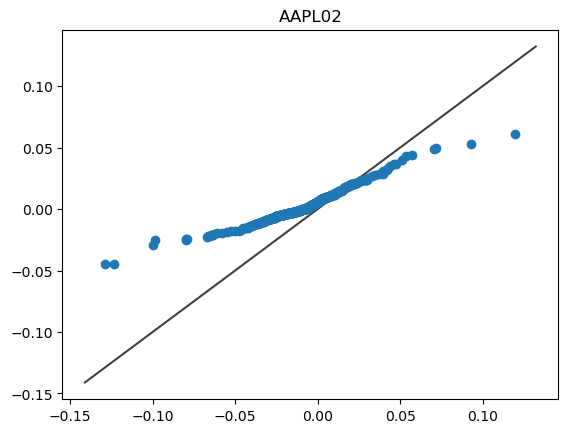

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


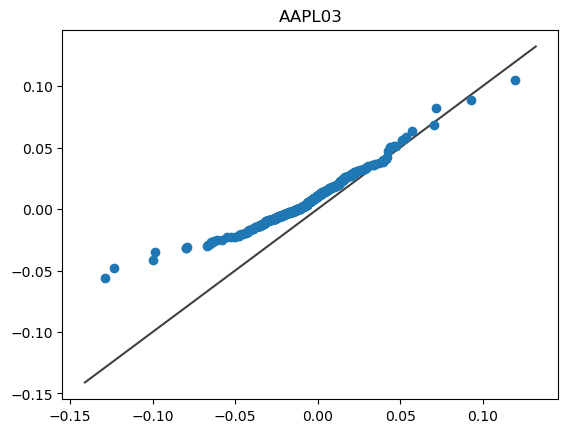

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


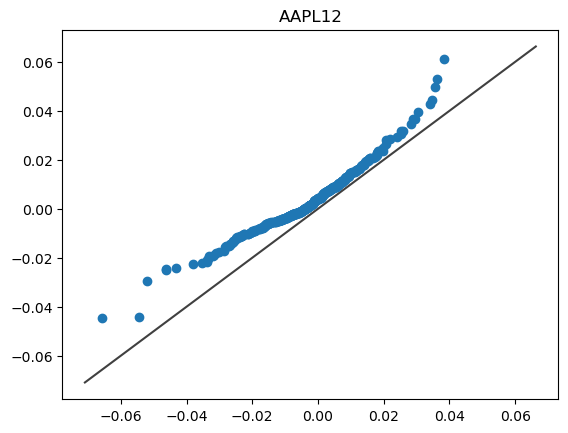

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


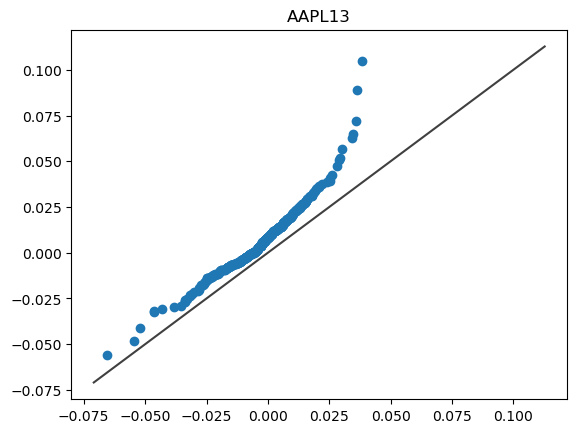

/tmp/ipykernel_2846257/3732593990.py:54: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  x_quantiles = np.quantile(x, quantiles, interpolation=interpolation)
/tmp/ipykernel_2846257/3732593990.py:55: DeprecationWarning: the `interpolation=` argument to quantile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  y_quantiles = np.quantile(y, quantiles, interpolation=interpolation)


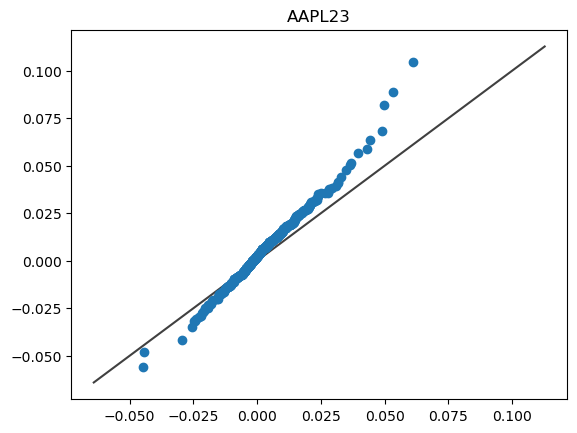

In [19]:
for k,tic in enumerate(tics):
    for i in range(4):
        for j in range(i+1,4):
            fig = plt.figure()
            ax = fig.add_subplot(111)
            qq = qqplot(data_dict[tic].loc[data_dict[tic]['label']==i,['pct_return']].values.tolist(),data_dict[tic].loc[data_dict[tic]['label']==j,['pct_return']].values.tolist())
            lims = [
                        np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
                        np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
                    ]
            plt.plot(lims, lims, 'k-', alpha=0.75, zorder=0)
            plt.title(tic+str(i)+str(j))
            plt.show()
    if k>-1:
        break

# length constrained linear model

In use cases, we usually set constrain on the minimum length of a regime series, this is the post-processing process of the regime series to meet minimum
length

In [47]:
turning_points_dict={}
coef_list_dict={}
norm_coef_list_dict={}
y_pred_dict={}
for i,tic in enumerate(tics):
    coef_list,turning_points,y_pred_list,norm_coef_list=linear_regession_turning_points(data_ori=data_dict[tic],tic=tic,length_constrain=24)
    turning_points_dict[tic]=turning_points
    coef_list_dict[tic]=coef_list
    y_pred_dict[tic]=y_pred_list
    norm_coef_list_dict[tic]=norm_coef_list

In [48]:
all_coef_list=np.vstack([array for array in norm_coef_list_dict.values()])

In [49]:
coef_stats=pd.DataFrame(all_coef_list).describe()
display(coef_stats)
percent_25=coef_stats.loc['25%',0]
percent_75=coef_stats.loc['75%',0]

,0
count,2220.000000
mean,0.079565
std,0.320038
min,-3.095165
25%,-0.092169
50%,0.085719
75%,0.257236
max,2.339544


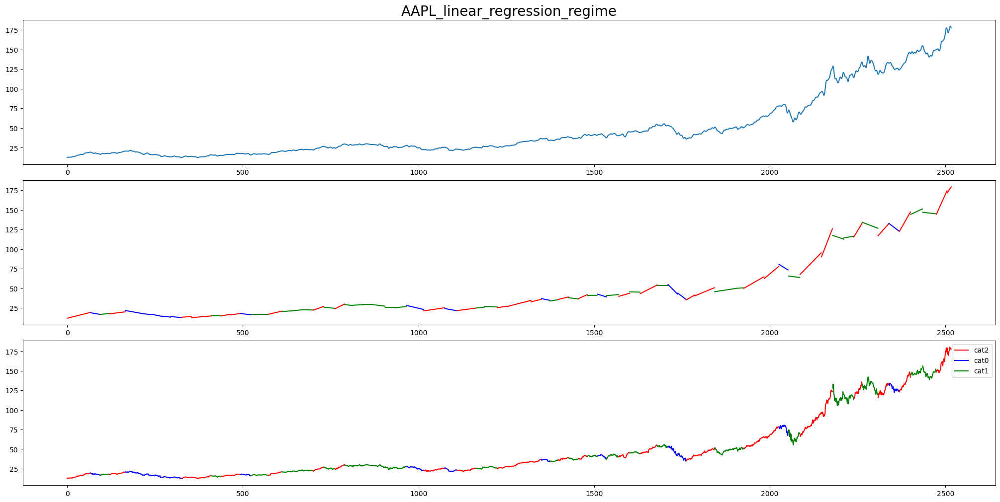

In [53]:
adjcp_data_seg,all_label_seg,all_index_seg=run_linear_model('adjcp_filtered_normalized',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,1,False,3,-0.25,0.25)
pct_return_normalized_data_seg,all_label_seg,all_index_seg=run_linear_model('pct_return_filtered_normalized',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,False,False,3,-0.25,0.25)
pct_return_data_seg,all_label_seg,all_index_seg=run_linear_model('pct_return_filtered',tics,turning_points_dict,coef_list_dict,y_pred_dict,norm_coef_list_dict,False,False,3,-0.25,0.25)

In [ ]:
interpolated_pct_return_data_seg=np.array(interpolation(pct_return_data_seg))

In [ ]:
tsne = TSNE(n_components = 2, verbose = 1, perplexity = 40, n_iter = 300)
tsne_results = tsne.fit_transform(interpolated_pct_return_data_seg)

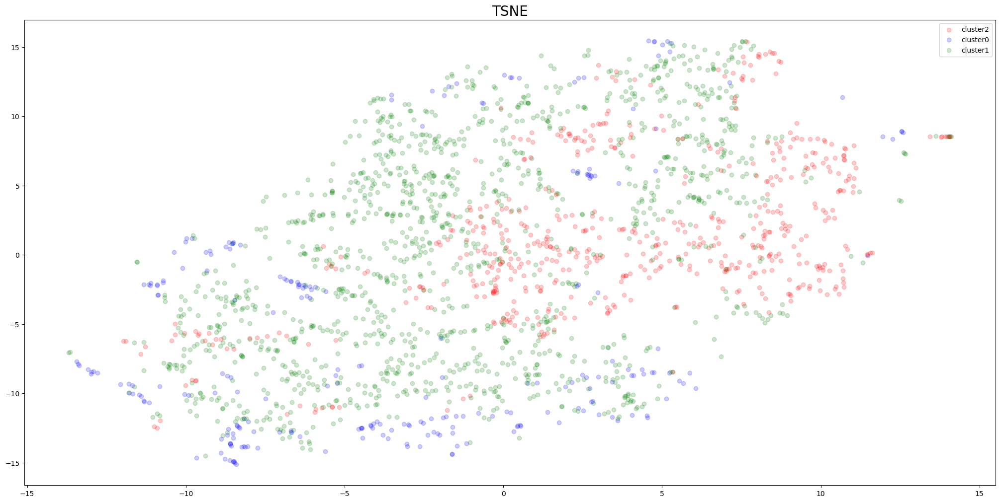

In [371]:
TSNE_plot(tsne_results,all_label_seg)

# Stock grouping based on similarity

In [38]:
data=pd.read_csv('../data/dj30/dj30.csv')

In [39]:
tics = data['tic'].unique()
data_dict = {}
for tic in tics:
    tic_data = data.loc[data['tic'] == tic, :]
    tic_data.sort_values(by='date', ascending=True)
    tic_data = tic_data.assign(pct_return=tic_data['adjcp'].pct_change().fillna(0))
    data_dict[tic] = tic_data.reset_index(drop=True).loc[:,['date','open','high','low','close','adjcp','pct_return']]

In [40]:
data_by_tic=[]
for tic in tics:
    data_by_tic.append(data_dict[tic].loc[:,['open','high','low','close','adjcp','pct_return']].values)

In [42]:
fitting_data=to_time_series_dataset(data_by_tic)

In [ ]:
km_stock=TimeSeriesKMeans(n_clusters=6, metric="dtw", max_iter=50,max_iter_barycenter=100,n_jobs=50,verbose=1).fit(fitting_data)

In [ ]:
label_stock=km_stock.predict(fitting_data)

In [292]:
label_dict=[[] for _ in range(km_stock.n_clusters)]
for i,tic in enumerate(tics): 
    label_dict[label_stock[i]].append(tic)

We cluster the stock into groups based on their adjclose

[['CSCO', 'INTC', 'KO', 'MRK', 'VZ', 'WBA'],
 ['GS', 'HD', 'UNH'],
 ['AMGN', 'CAT', 'CRM', 'HON', 'MCD', 'MMM', 'MSFT', 'V'],
 ['IBM'],
 ['BA'],
 ['AAPL', 'AXP', 'CVX', 'DIS', 'JNJ', 'JPM', 'NKE', 'PG', 'TRV', 'WMT']]

This is cluster 0


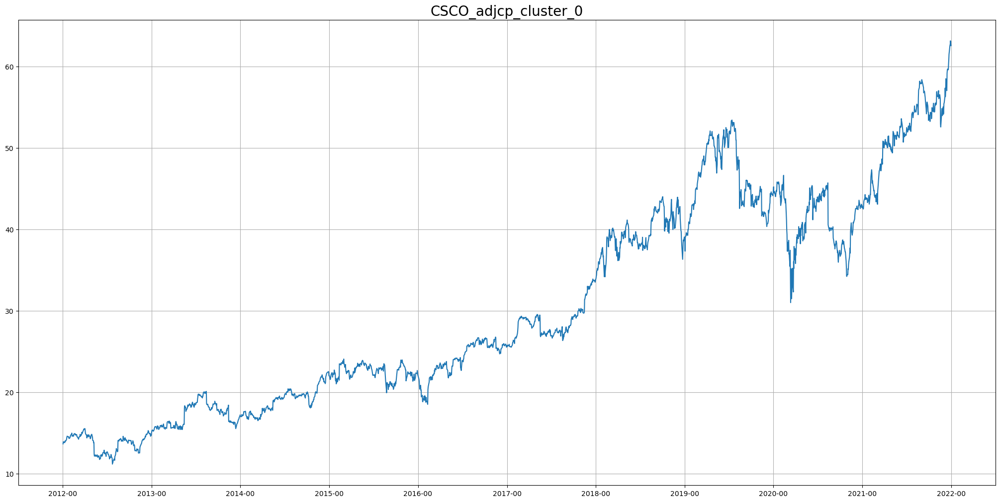

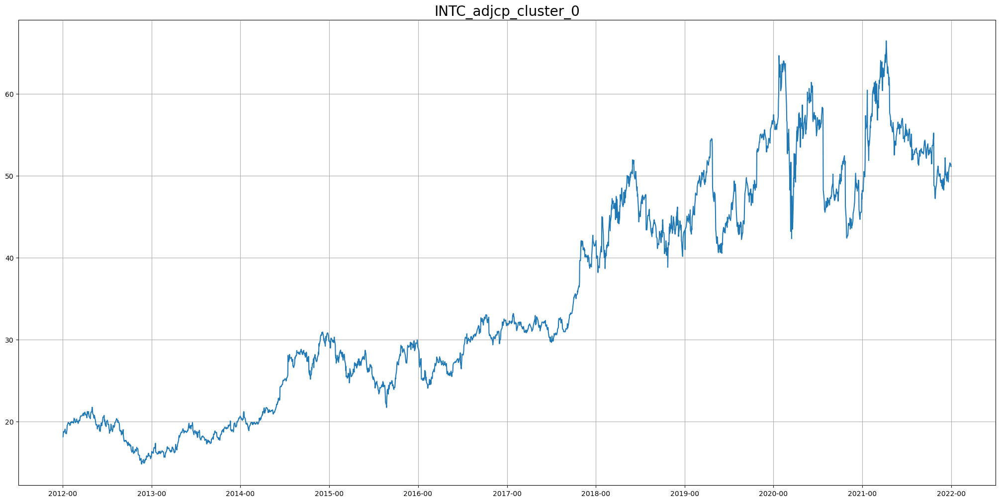

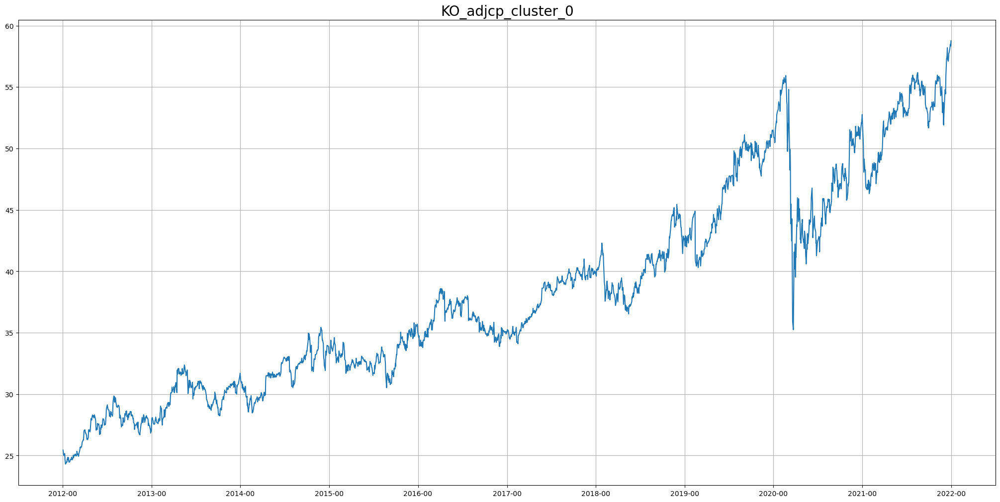

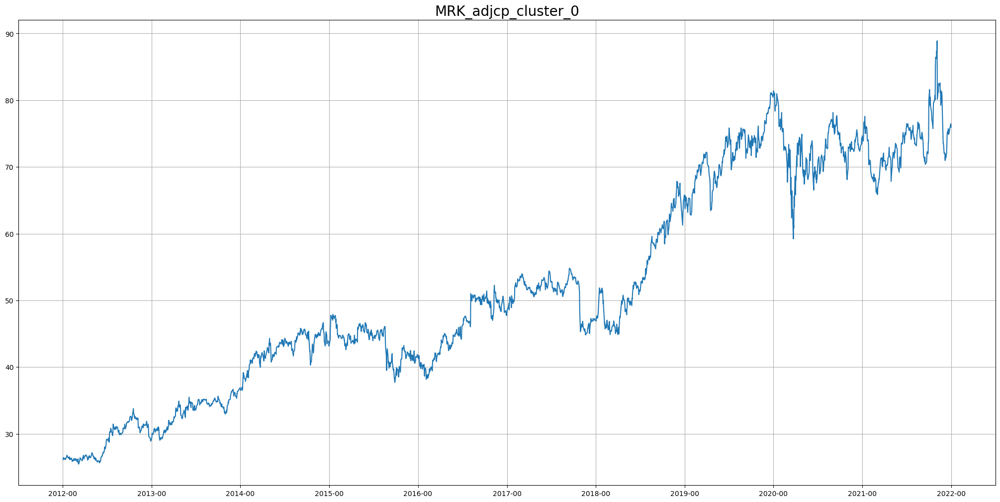

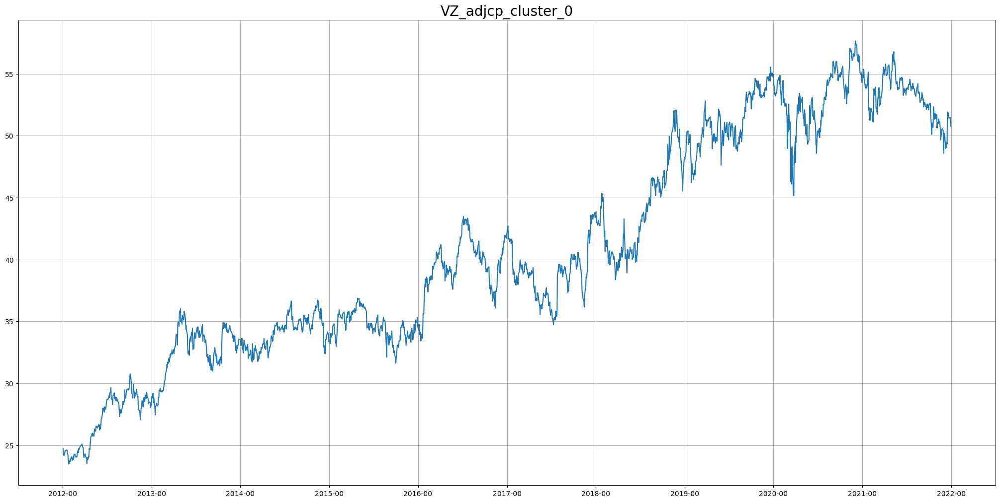

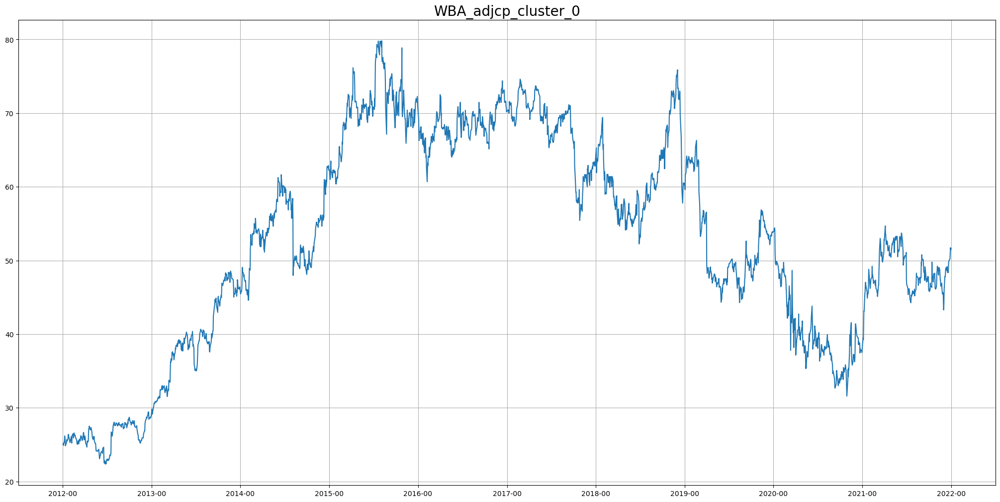

This is cluster 1


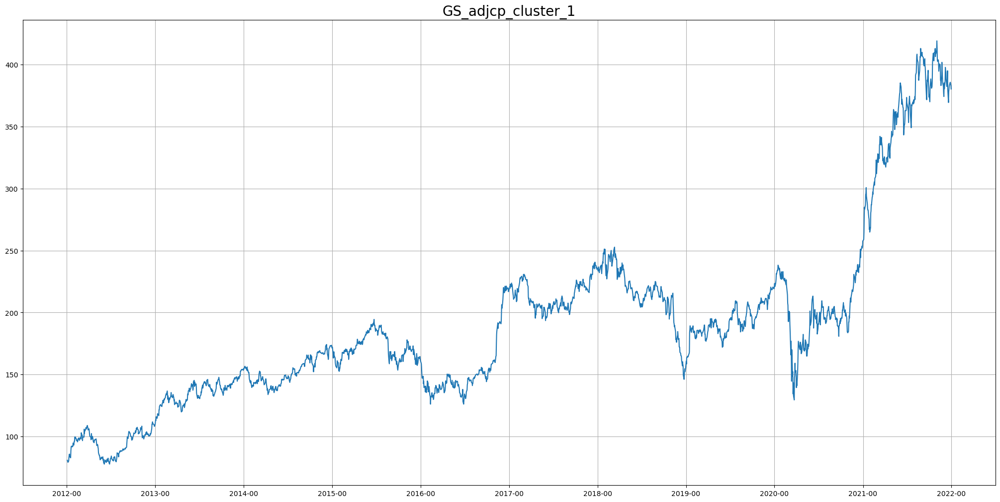

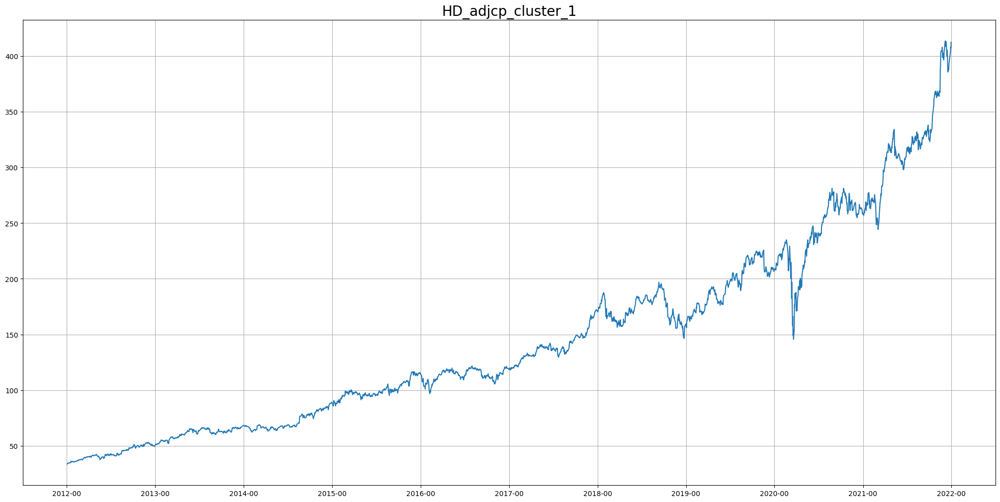

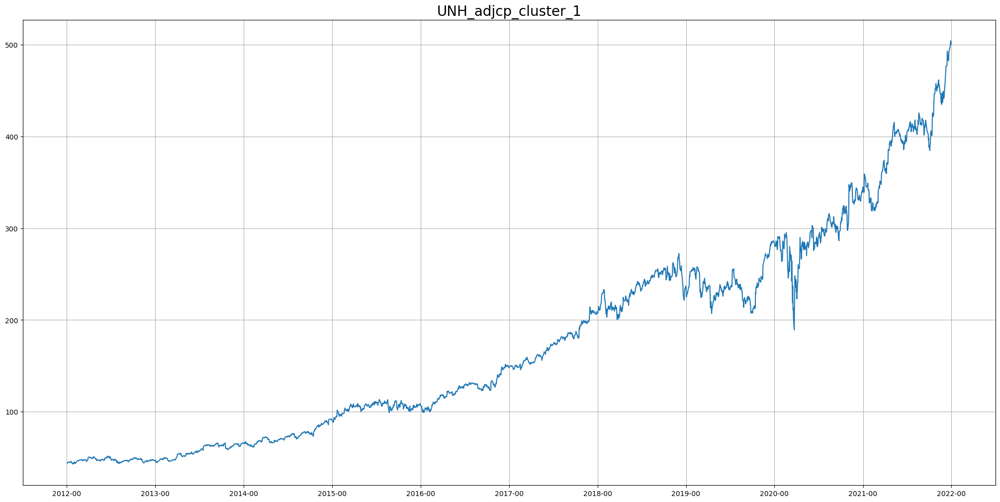

This is cluster 2


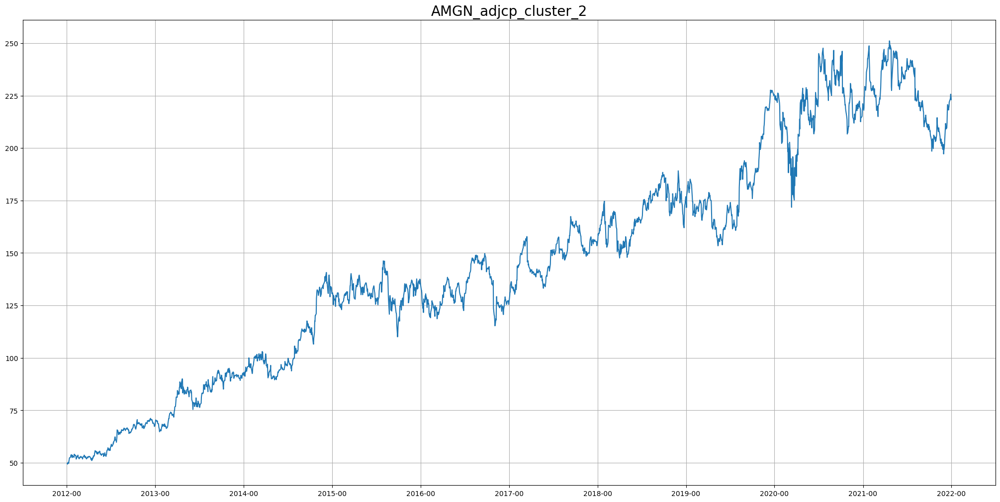

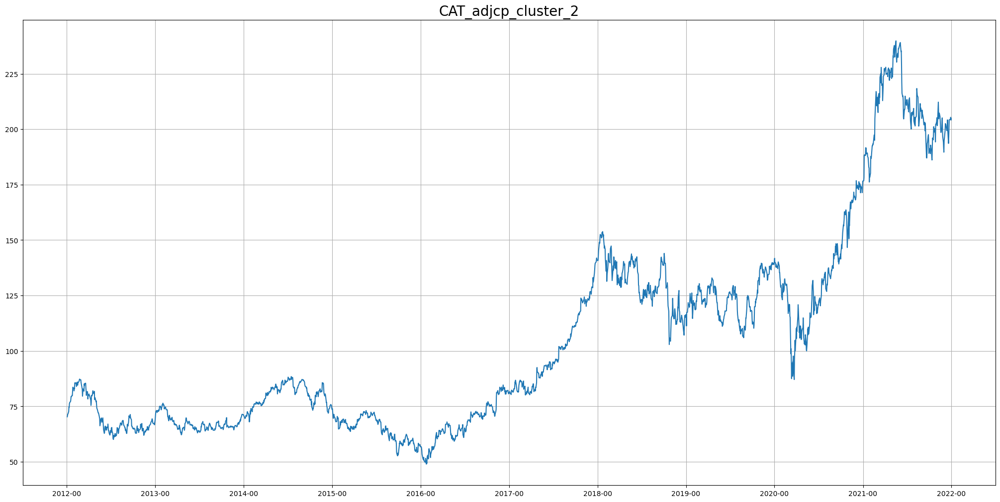

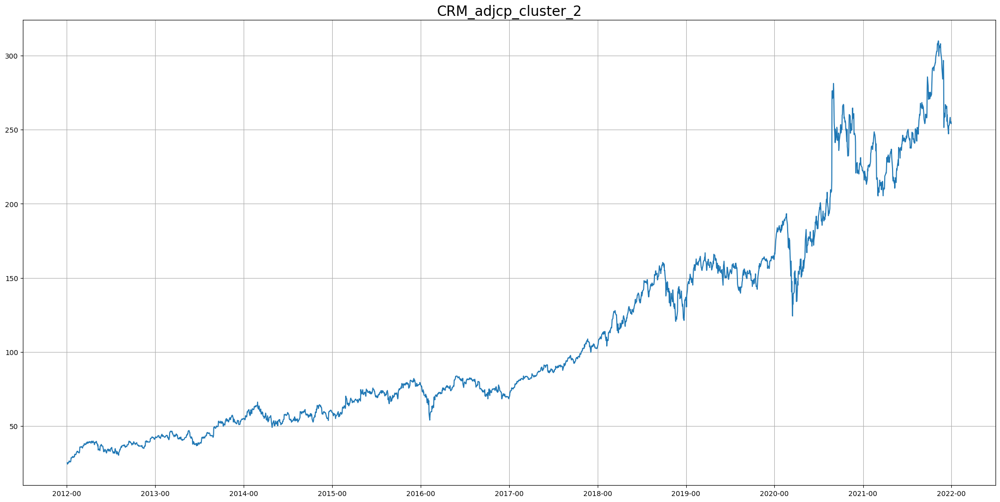

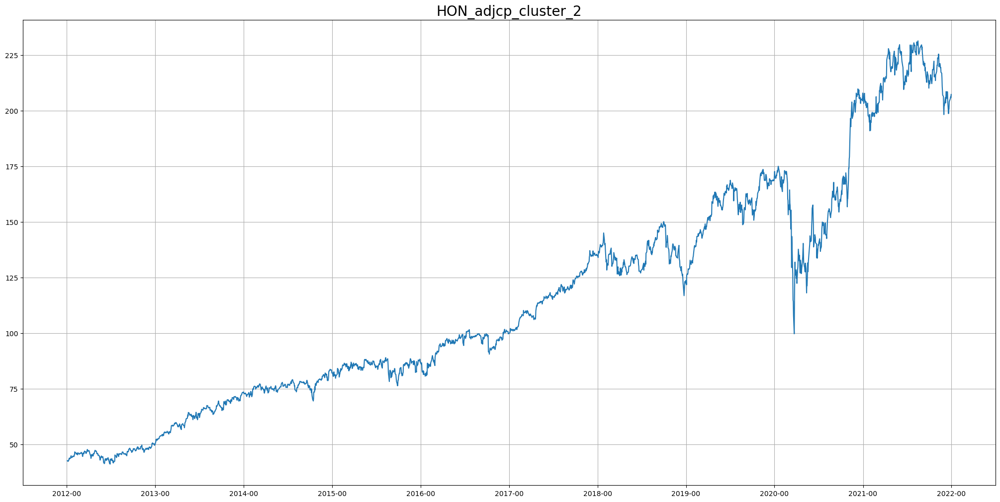

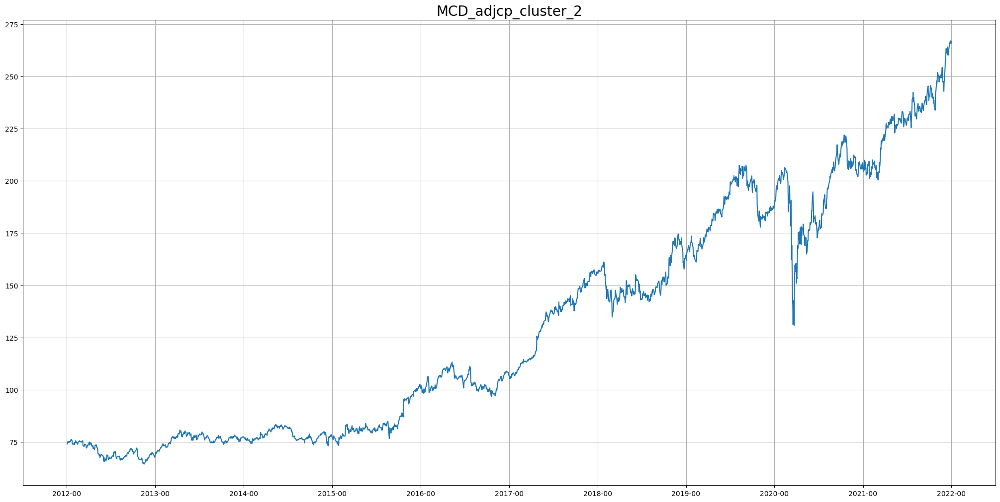

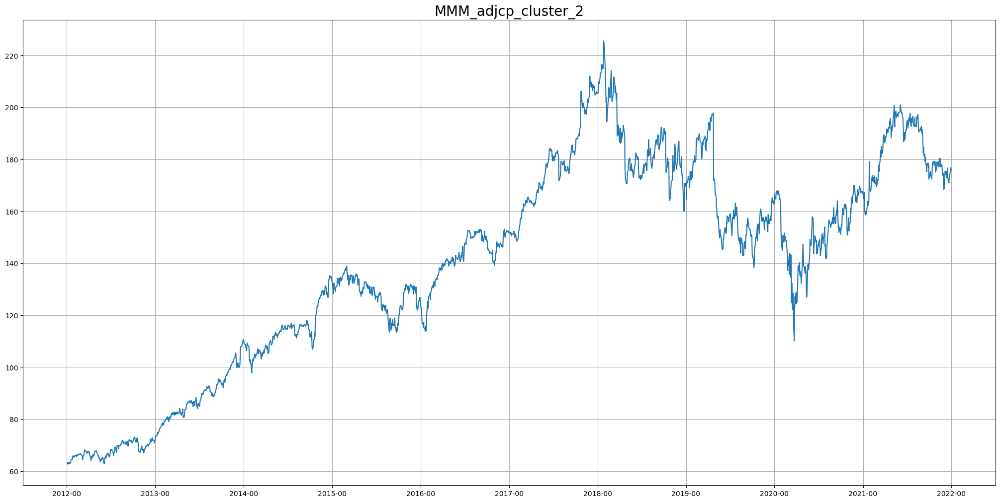

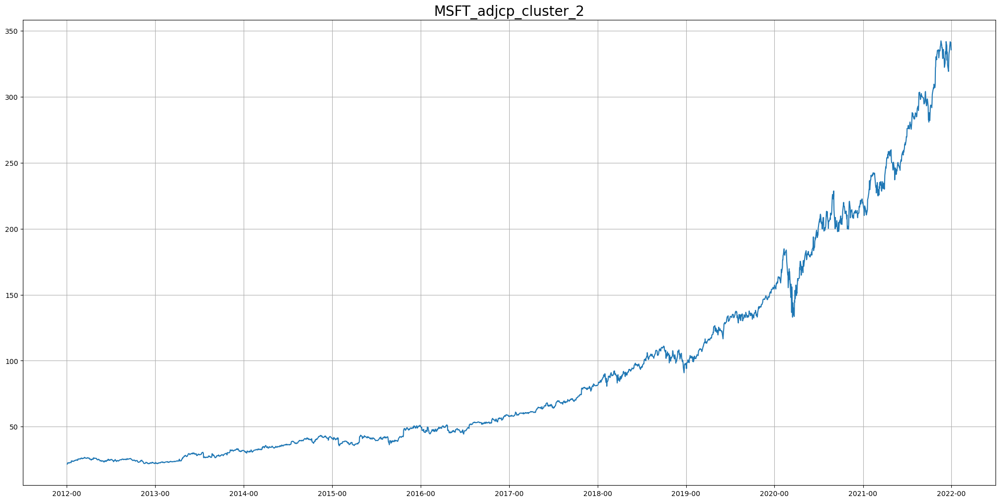

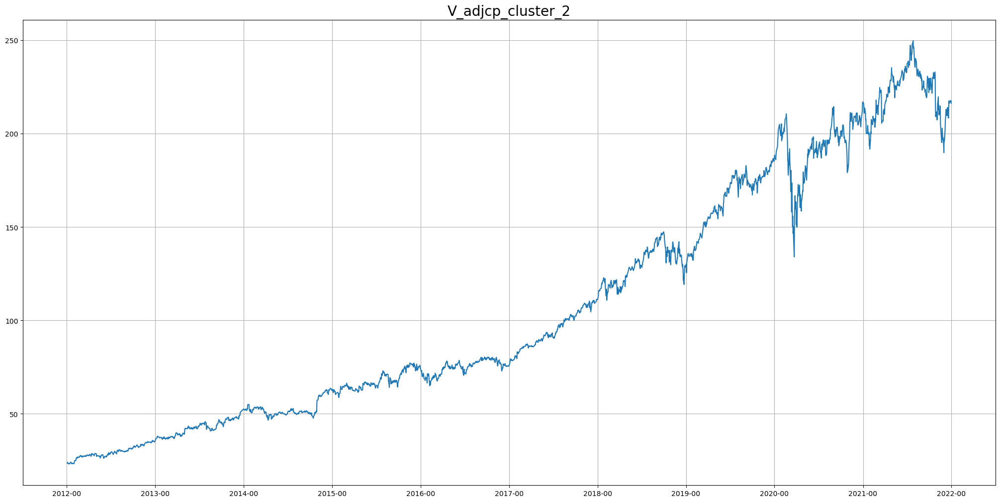

This is cluster 3


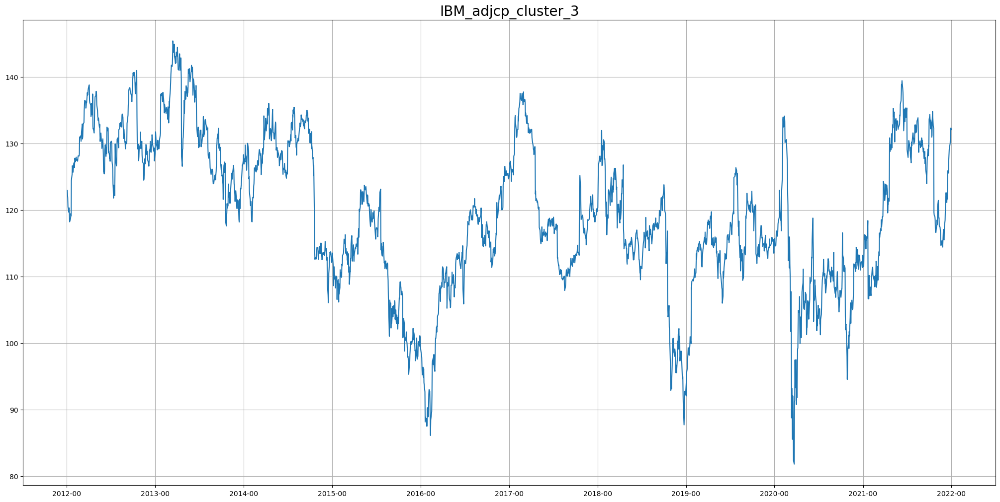

This is cluster 4


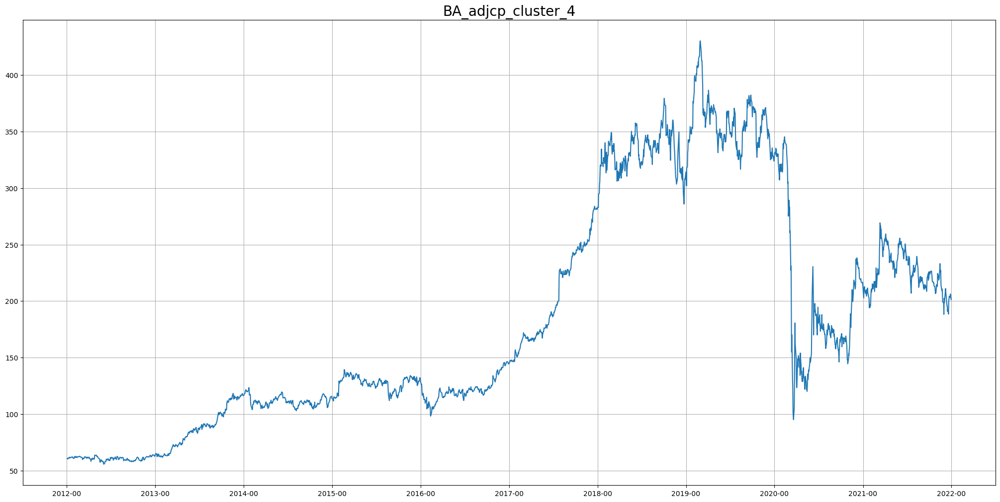

This is cluster 5


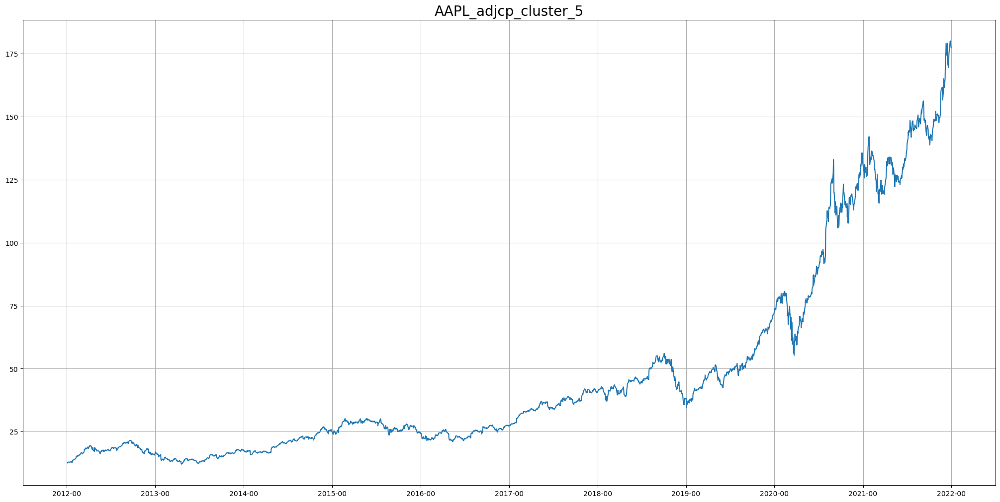

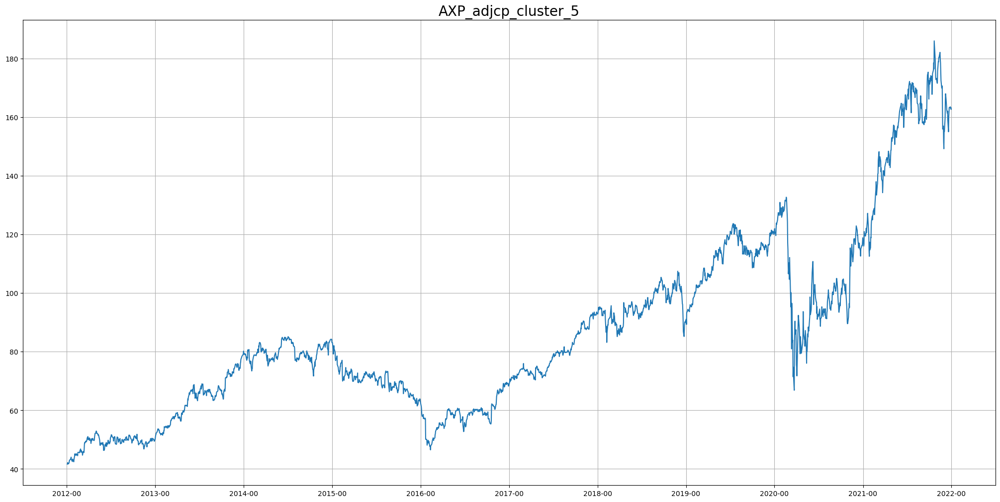

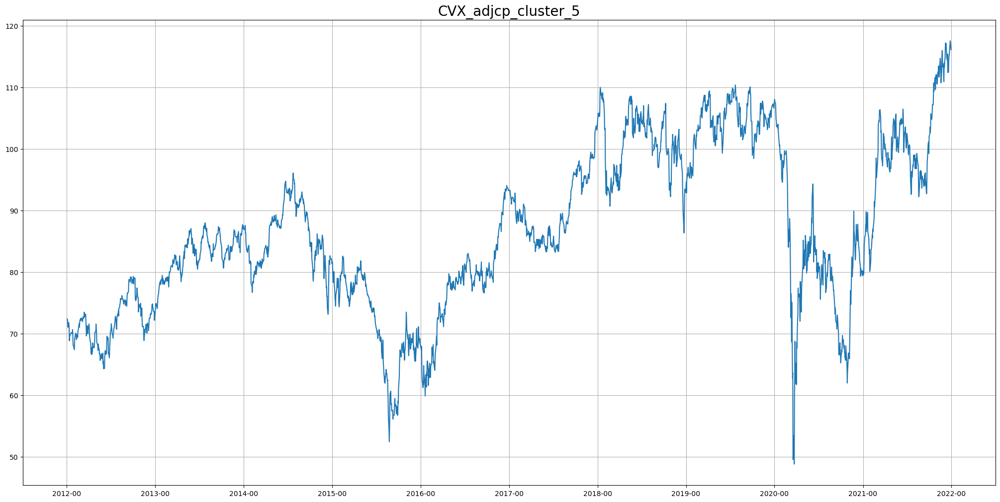

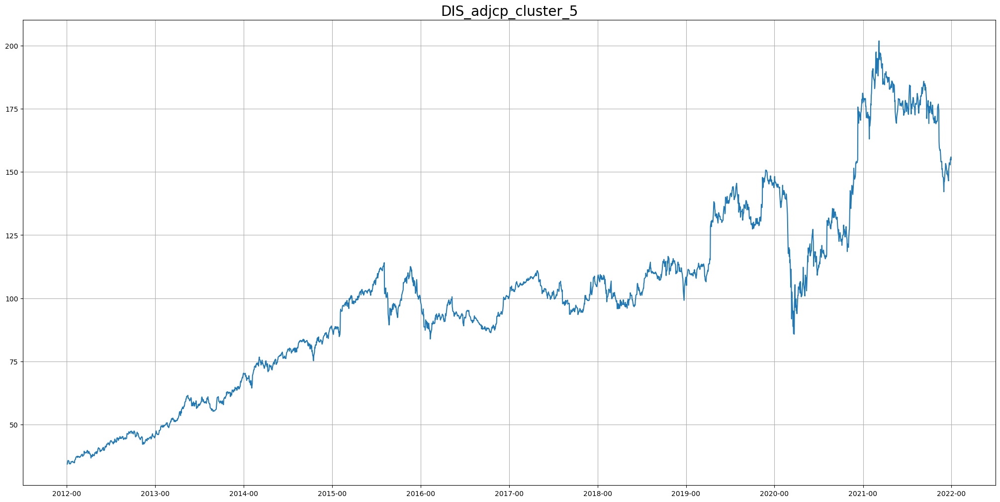

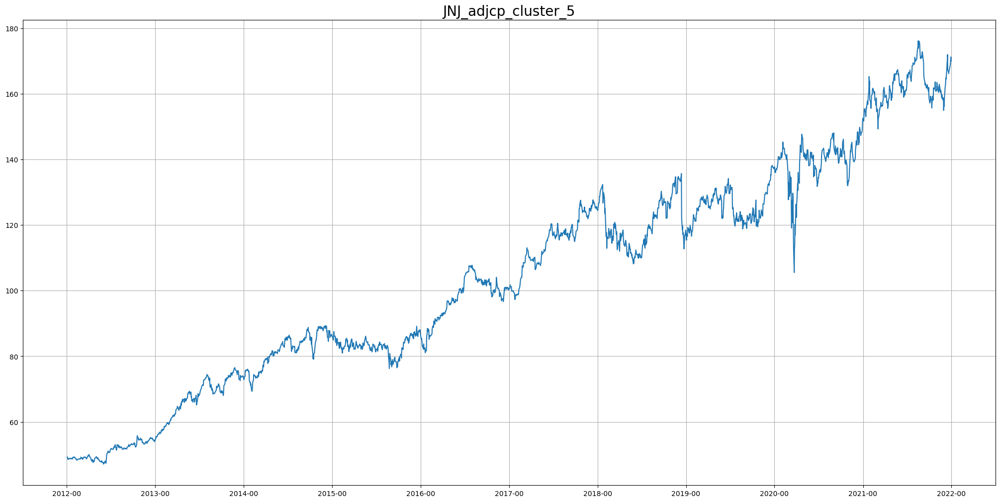

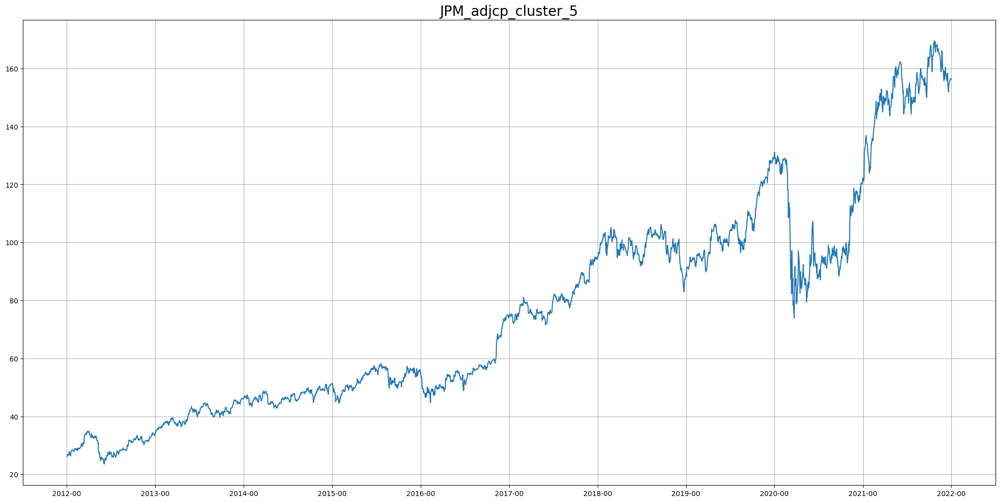

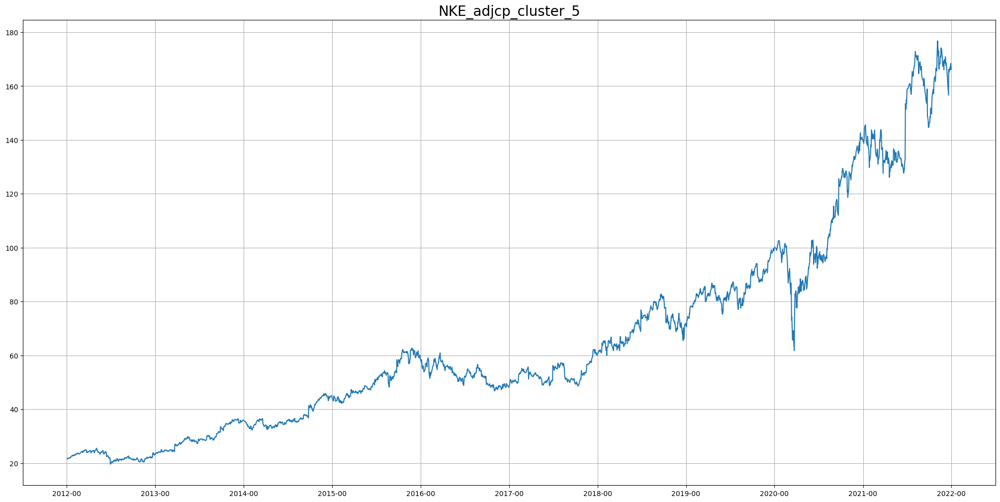

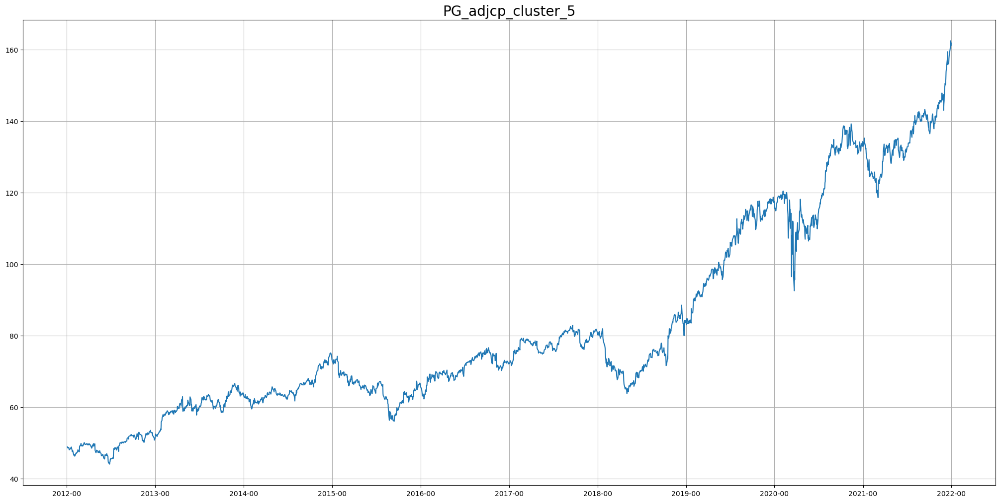

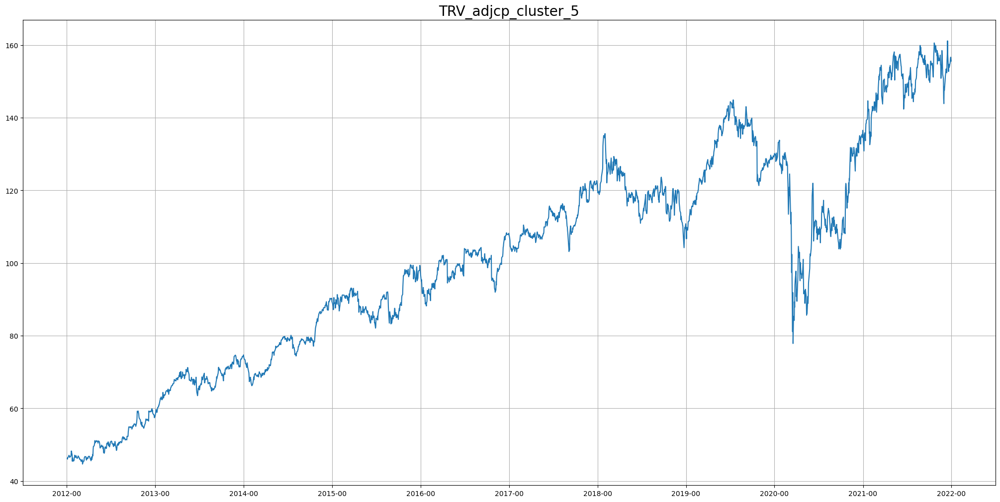

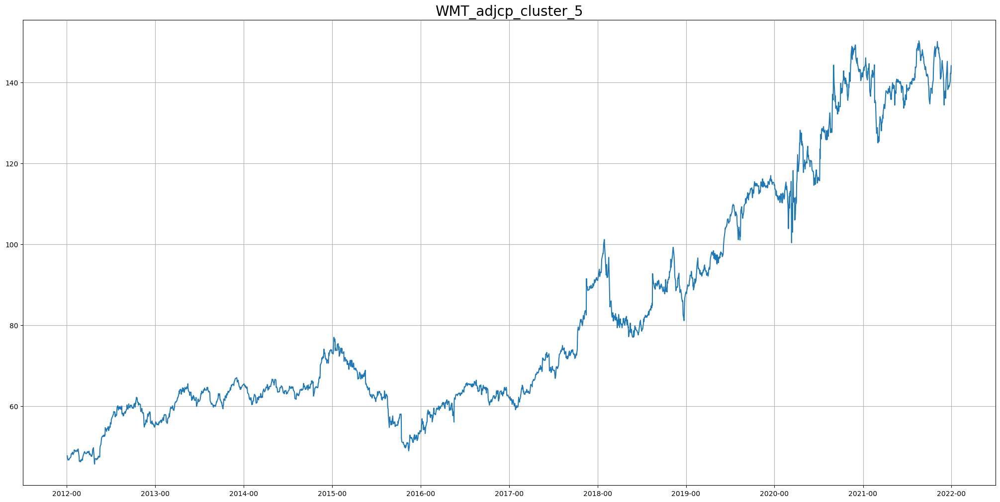

In [297]:
display(label_dict)
for label,tics in enumerate(label_dict):
    print('This is cluster '+str(label))
    for tic in tics:
        plot_ori(data_dict[tic],tic,'_cluster_'+str(label))
    plt.show()

# Stylize facts

## distribution of returns

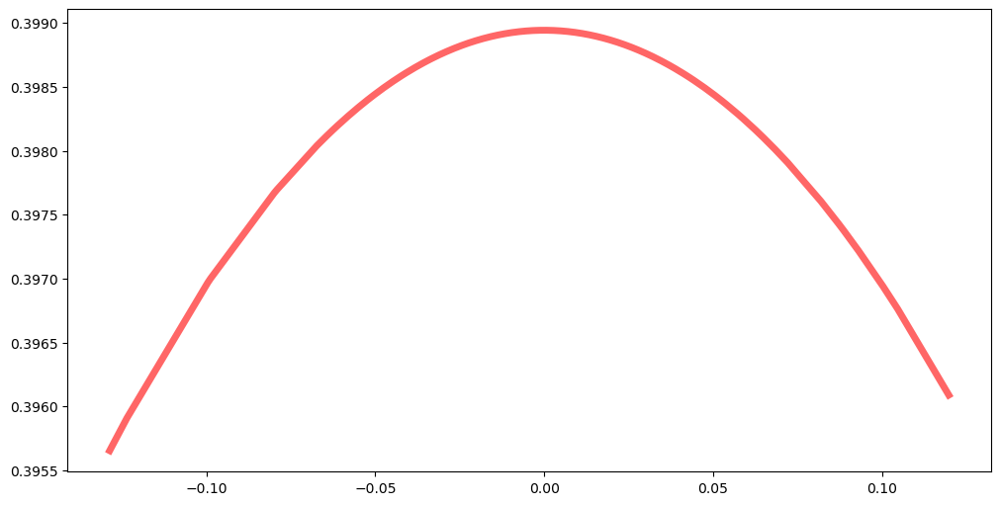

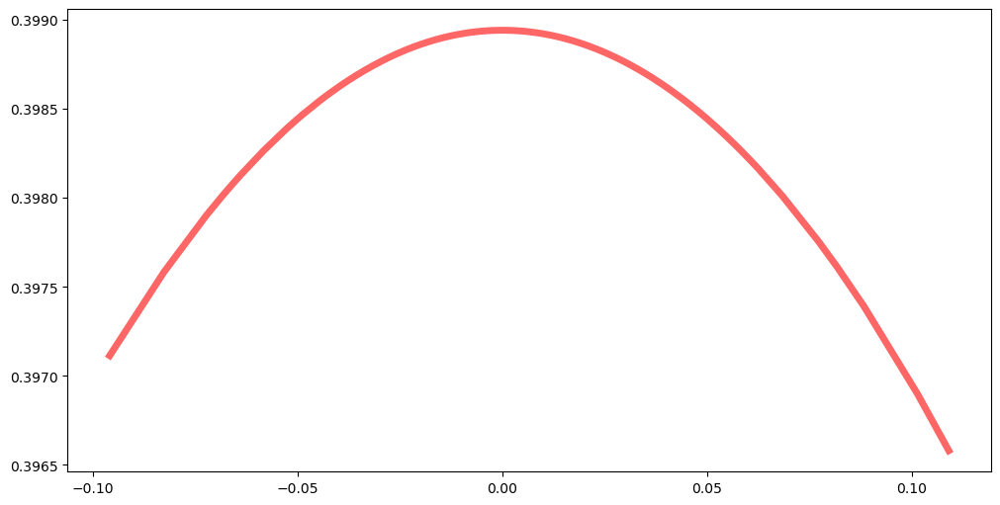

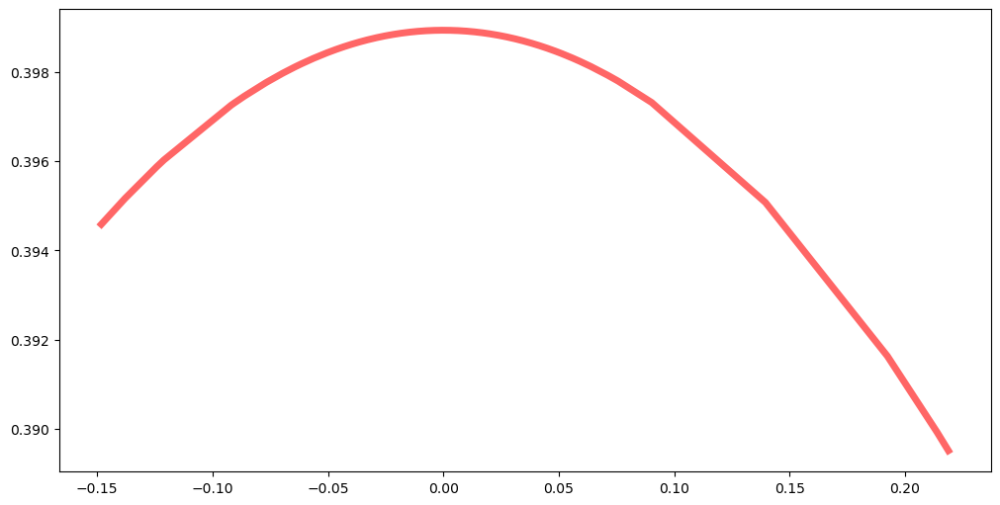

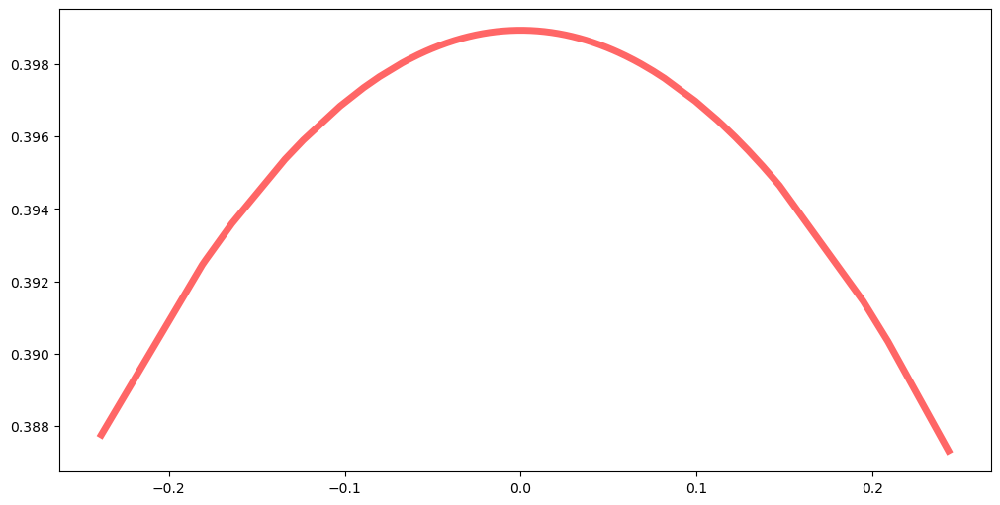

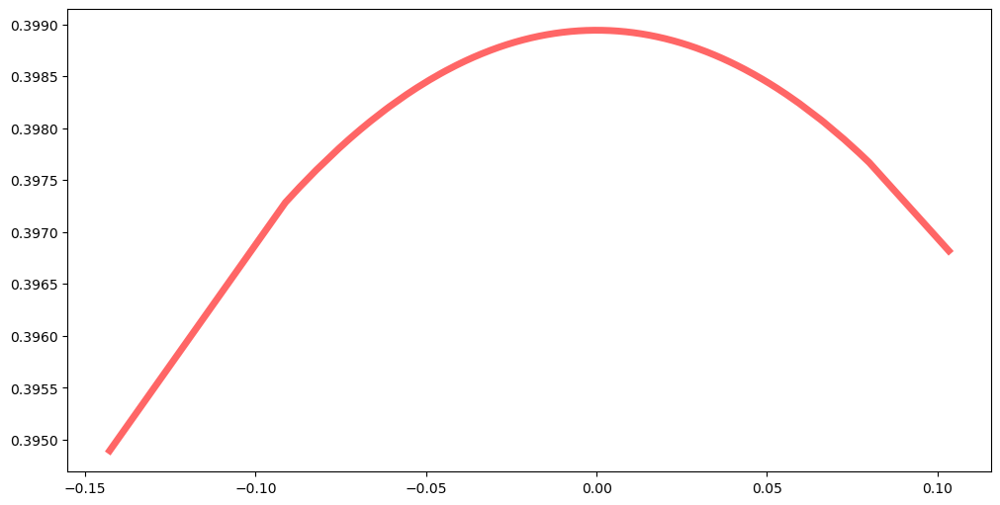

...

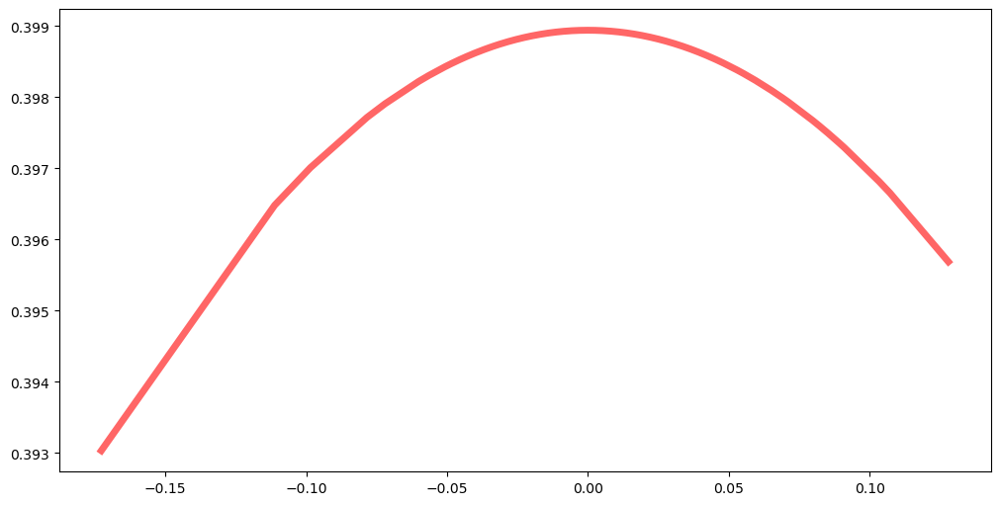

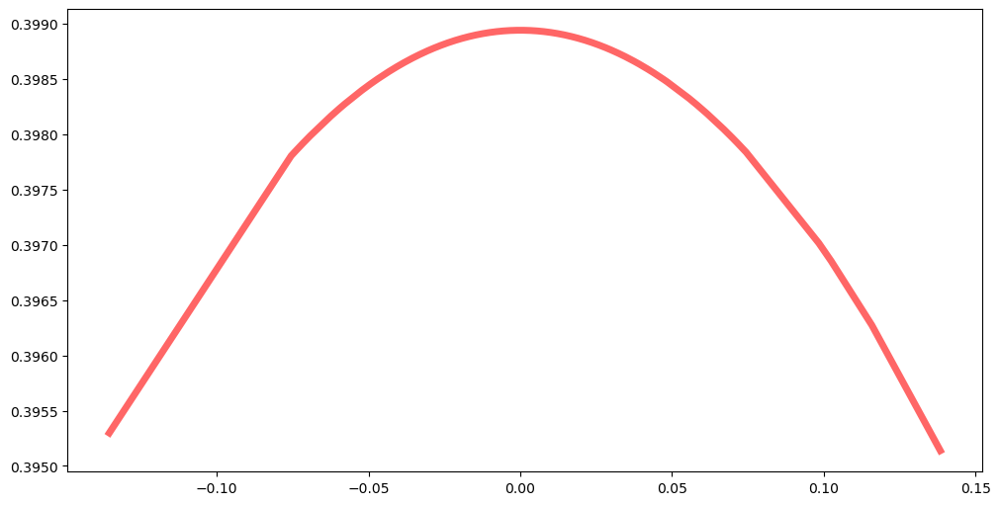

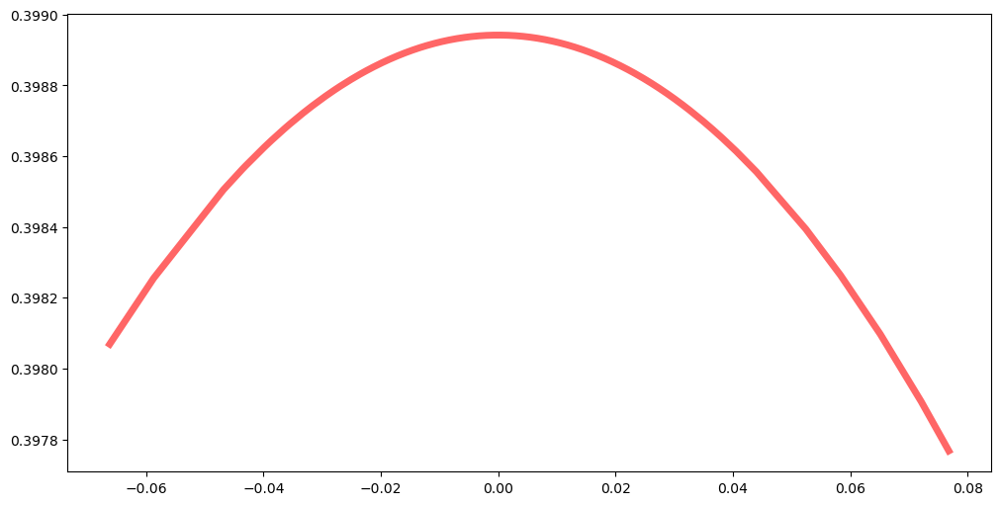

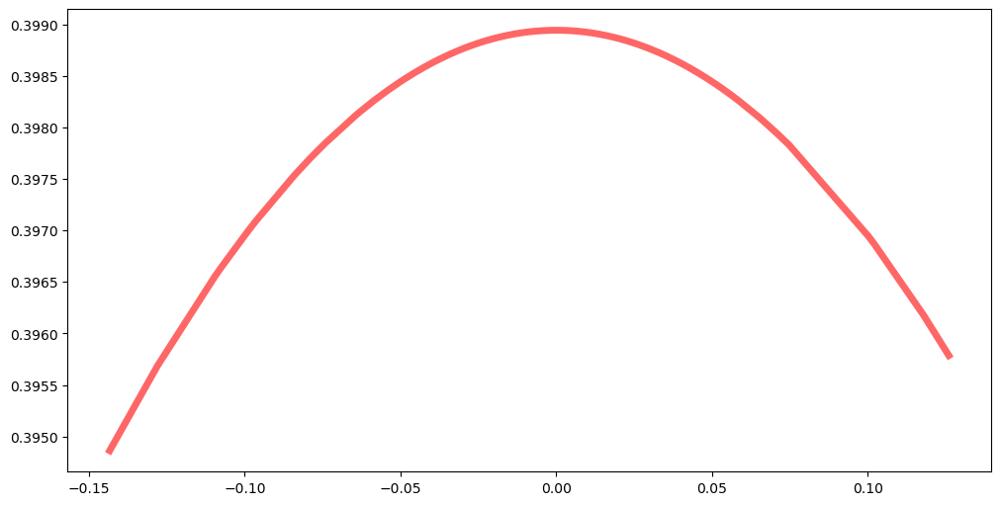

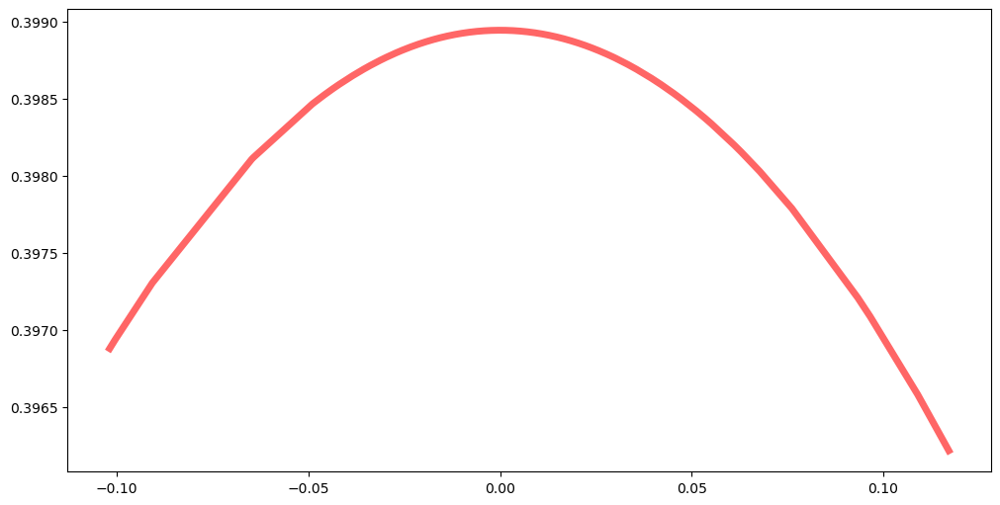

mean/sqrt(var)


count    29.000000
mean      0.045477
std       0.015991
min       0.009219
25%       0.035675
50%       0.045805
75%       0.052242
max       0.077895
dtype: float64

skew


count    29.000000
mean      0.018968
std       0.605714
min      -1.767445
25%      -0.287808
50%       0.133595
75%       0.348156
max       1.322432
dtype: float64

kurt


count    29.000000
mean     15.273194
std       8.704840
min       4.909045
25%      10.553041
50%      13.339254
75%      16.266102
max      38.464723
dtype: float64

In [20]:
from scipy.stats import norm
import math
mean_list=[]
skew_list=[]
kurt_list=[]
for i,tic in enumerate(tics):
    data=data_dict[tic]["pct_return"].copy()
    mean=data.mean()
    var=data.var()
    skew=data.skew()
    kurt=data.kurt()
    rv = norm()
    fig, ax = plt.subplots(1, 1, figsize=(10,5),constrained_layout=True)
    data=data.to_numpy()
    data.sort()
    mean_list.append(mean/math.sqrt(var))
    skew_list.append(skew)
    kurt_list.append(kurt)
#     print(mean/math.sqrt(var),skew,kurt)
    ax.plot(data,rv.pdf(data),
       'r-', lw=5, alpha=0.6, label='norm pdf')
#     ax.hist(data, density=True, histtype='stepfilled', alpha=0.2)
#     ax.legend(loc='best', frameon=False)
    plt.show()
    if i>100:
        break
print('mean/sqrt(var)')
display(pd.Series(mean_list).describe())
print('skew')
display(pd.Series(skew_list).describe())
print('kurt')
display(pd.Series(kurt_list).describe())

In [47]:
for j,tic in enumerate(tics):
    print(tic)
    mean_list=[]
    skew_list=[]
    kurt_list=[]
    ori_data=data_dict[tic]["pct_return"].copy()
    for i in range(ori_data.shape[0]//250):
        data=ori_data.iloc[i*250:(i+1)*250]
        mean=data.mean()
        var=data.var()
        skew=data.skew()
        kurt=data.kurt()
        rv = norm()
#         fig, ax = plt.subplots(1, 1, figsize=(10,5),constrained_layout=True)
        data=data.to_numpy()
        data.sort()
        mean_list.append(mean/math.sqrt(var))
        skew_list.append(skew)
        kurt_list.append(kurt)
    #     print(mean/math.sqrt(var),skew,kurt)
#         ax.plot(data,rv.pdf(data),
#            'r-', lw=5, alpha=0.6, label='norm pdf')
    #     ax.hist(data, density=True, histtype='stepfilled', alpha=0.2)
    #     ax.legend(loc='best', frameon=False)
#         plt.show()
    print('mean/sqrt(var)')
    display(pd.Series(mean_list).describe())
    print('skew')
    display(pd.Series(skew_list).describe())
    print('kurt')
    print(kurt_list)
    display(pd.Series(kurt_list).describe())
    if j>100:
        break

AAPL
mean/sqrt(var)


count    10.000000
mean      0.071698
std       0.054083
min       0.000454
25%       0.028464
50%       0.080986
75%       0.107869
max       0.157657
dtype: float64

skew


count    10.000000
mean     -0.117388
std       0.540420
min      -1.239853
25%      -0.235930
50%      -0.114631
75%       0.055826
max       0.645063
dtype: float64

kurt
[3.241245227205955, 8.827195229181362, 9.454324232808956, 1.3522010332048198, 4.013909784228149, 5.272180499135628, 1.7348589440375206, 6.111470990385639, 3.8905690157125465, 0.5371647599335674]


count    10.000000
mean      4.443512
std       3.016289
min       0.537165
25%       2.111456
50%       3.952239
75%       5.901648
max       9.454324
dtype: float64

AMGN
mean/sqrt(var)


count    10.000000
mean      0.049795
std       0.046540
min      -0.010574
25%       0.012950
50%       0.056566
75%       0.080442
max       0.118044
dtype: float64

skew


count    10.000000
mean     -0.022131
std       0.618929
min      -1.203281
25%      -0.425023
50%       0.154691
75%       0.398405
max       0.777390
dtype: float64

kurt
[2.0878322154468143, 2.7481764793609016, 1.7916187796962517, 0.9331012338495244, 6.41690102943277, 5.482710721117938, 2.200421491302277, 3.1569517253843062, 3.95402248158256, 5.864793312364911]


count    10.000000
mean      3.463653
std       1.888509
min       0.933101
25%       2.115980
50%       2.952564
75%       5.100539
max       6.416901
dtype: float64

AXP
mean/sqrt(var)


count    10.000000
mean      0.055104
std       0.069165
min      -0.081845
25%       0.029042
50%       0.046497
75%       0.078786
max       0.165480
dtype: float64

skew


count    10.000000
mean      0.008437
std       0.812137
min      -1.403508
25%      -0.378697
50%      -0.132905
75%       0.170725
max       1.354025
dtype: float64

kurt
[0.3627435497431888, 1.6398875372509907, 1.0501956916773731, 4.4041371731977215, 18.44230675680704, 9.177525372590651, 4.4316919627345115, 2.600597342418691, 8.832347035575948, 2.2805382566319463]


count    10.000000
mean      5.322197
std       5.517872
min       0.362744
25%       1.800050
50%       3.502367
75%       7.732183
max      18.442307
dtype: float64

BA
mean/sqrt(var)


count    10.000000
mean      0.058684
std       0.086467
min      -0.008017
25%       0.004601
50%       0.031251
75%       0.039952
max       0.244008
dtype: float64

skew


count    10.000000
mean      0.217850
std       1.045514
min      -1.261837
25%      -0.167970
50%       0.139667
75%       0.402165
max       2.756998
dtype: float64

kurt
[2.5699452648022834, 1.2516172682118945, 1.82113351551584, 2.310325482695504, 6.393179183488339, 22.474579859512495, 0.9778233690722531, 1.8268115152453137, 4.883220034272908, 1.4248880067515555]


count    10.000000
mean      4.593352
std       6.514816
min       0.977823
25%       1.523949
50%       2.068568
75%       4.304901
max      22.474580
dtype: float64

CAT
mean/sqrt(var)


count    10.000000
mean      0.035774
std       0.059457
min      -0.061351
25%       0.006733
50%       0.034647
75%       0.048100
max       0.158547
dtype: float64

skew


count    10.000000
mean     -0.032126
std       0.519108
min      -0.638947
25%      -0.376527
50%      -0.141771
75%       0.238353
max       1.092958
dtype: float64

kurt
[0.22598831344655101, 3.9432264569205144, 3.839876313538461, 2.652916322934194, 2.4040642484668404, 6.98720798672025, 1.1650461102890914, 3.462979416726903, 3.5871194873558596, 0.7537980175204861]


count    10.000000
mean      2.902222
std       1.959013
min       0.225988
25%       1.474801
50%       3.057948
75%       3.776687
max       6.987208
dtype: float64

CRM
mean/sqrt(var)


count    10.000000
mean      0.062699
std       0.047516
min      -0.010715
25%       0.044630
50%       0.058278
75%       0.062262
max       0.170938
dtype: float64

skew


count    10.000000
mean      0.223093
std       0.775253
min      -0.993120
25%      -0.333694
50%       0.099948
75%       0.722040
max       1.366395
dtype: float64

kurt
[3.1372785663925096, 7.511312097901159, 0.9259942996370096, 8.330371541385924, 8.930148554658548, 2.9307903612158266, 4.100262452294622, 1.7039689826253004, 15.915780434926706, 9.246510924564578]


count    10.000000
mean      6.273242
std       4.592772
min       0.925994
25%       2.982412
50%       5.805787
75%       8.780204
max      15.915780
dtype: float64

CSCO
mean/sqrt(var)


count    10.000000
mean      0.054157
std       0.041634
min       0.001509
25%       0.018070
50%       0.048983
75%       0.094565
max       0.112059
dtype: float64

skew


count    10.000000
mean      0.020142
std       0.697419
min      -1.281928
25%      -0.224178
50%       0.091033
75%       0.628542
max       0.811274
dtype: float64

kurt
[11.870907201726748, 25.044949318833556, 4.589650812768561, 7.440368018211924, 10.106767257510386, 14.852931027725713, 1.288486128591614, 5.79118172069677, 6.424520865401666, 2.4742567383241485]


count    10.000000
mean      8.988402
std       7.008161
min       1.288486
25%       4.890034
50%       6.932444
75%      11.429872
max      25.044949
dtype: float64

CVX
mean/sqrt(var)


count    10.000000
mean      0.028975
std       0.045992
min      -0.034777
25%      -0.001415
50%       0.020310
75%       0.074403
max       0.090461
dtype: float64

skew


count    10.000000
mean     -0.160864
std       0.312730
min      -0.568222
25%      -0.408493
50%      -0.185888
75%       0.066620
max       0.332376
dtype: float64

kurt
[1.0130792504070532, 0.5682431879832888, 3.2459588442703686, 1.0494262148041629, 1.3179572896109408, 2.0846108944165294, 1.416160965238244, 3.5288849744636743, 10.872551528977787, -0.04409745294843326]


count    10.000000
mean      2.505278
std       3.144273
min      -0.044097
25%       1.022166
50%       1.367059
75%       2.955622
max      10.872552
dtype: float64

DIS
mean/sqrt(var)


count    10.000000
mean      0.055857
std       0.050201
min       0.003591
25%       0.015840
50%       0.039786
75%       0.091805
max       0.152868
dtype: float64

skew


count    10.000000
mean      0.178264
std       1.008430
min      -0.789372
25%      -0.472975
50%      -0.127018
75%       0.269553
max       2.153385
dtype: float64

kurt
[3.1713117896244545, 0.41999520699763737, 2.144936353084788, 10.753534632016347, 3.2688418891972835, 5.04779641282315, 1.8609638152577301, 15.507443299685438, 5.632679092539702, 13.625687772372]


count    10.000000
mean      6.143319
std       5.276417
min       0.419995
25%       2.401530
50%       4.158319
75%       9.473321
max      15.507443
dtype: float64

GS
mean/sqrt(var)


count    10.000000
mean      0.048516
std       0.064912
min      -0.091842
25%       0.029425
50%       0.063484
75%       0.080390
max       0.135742
dtype: float64

skew


count    10.000000
mean     -0.059673
std       0.370055
min      -0.551724
25%      -0.313264
50%      -0.149402
75%       0.244883
max       0.516526
dtype: float64

kurt
[1.5418514880678926, 0.45026324494689485, 0.2395004258635285, 0.7210015121429487, 1.619808783031997, 2.704848208245066, 2.1541392963823953, 4.942121819644937, 6.4027055641552195, 0.35047321306522994]


count    10.000000
mean      2.112671
std       2.072191
min       0.239500
25%       0.517948
50%       1.580830
75%       2.567171
max       6.402706
dtype: float64

HD
mean/sqrt(var)


count    10.000000
mean      0.091810
std       0.056040
min      -0.003900
25%       0.058014
50%       0.096167
75%       0.136150
max       0.159382
dtype: float64

skew


count    10.000000
mean     -0.196484
std       0.554956
min      -1.309939
25%      -0.503451
50%      -0.108798
75%       0.267232
max       0.456771
dtype: float64

kurt
[0.8722966044360878, 2.5987912486083435, 3.2848711506287116, 1.063706719520496, 1.915179063373333, 2.796674746680114, 2.8164916570094163, 3.9237094935992, 14.512539574137357, 2.210839464085622]


count    10.000000
mean      3.599510
std       3.946740
min       0.872297
25%       1.989094
50%       2.697733
75%       3.167776
max      14.512540
dtype: float64

HON
mean/sqrt(var)


count    10.000000
mean      0.066382
std       0.064045
min      -0.015021
25%       0.025297
50%       0.056621
75%       0.091691
max       0.186741
dtype: float64

skew


count    10.000000
mean      0.061195
std       0.496858
min      -0.680403
25%      -0.236258
50%       0.192575
75%       0.369427
max       0.892121
dtype: float64

kurt
[3.566939530249124, 1.0965921718308462, 1.52074761588351, 2.114366980321487, 10.382801975705089, 1.2356314449738854, 1.4510252602187301, 1.8060467455083953, 5.338042578001559, 1.3973399497062613]


count    10.000000
mean      2.990953
std       2.913468
min       1.096592
25%       1.410761
50%       1.663397
75%       3.203796
max      10.382802
dtype: float64

IBM
mean/sqrt(var)


count    10.000000
mean      0.006289
std       0.040159
min      -0.045060
25%      -0.027604
50%       0.005809
75%       0.022402
max       0.078560
dtype: float64

skew


count    10.000000
mean     -0.526905
std       1.226807
min      -2.303544
25%      -1.124009
50%      -0.634463
75%      -0.097570
max       2.154076
dtype: float64

kurt
[4.225370952926763, 12.528709315044058, 8.17838159191787, 2.526564096071516, 4.249602295716155, 28.844845721760557, 4.840748484571151, 7.358732801019023, 4.675053382285176, 16.0125871224373]


count    10.000000
mean      9.344060
std       8.033986
min       2.526564
25%       4.355965
50%       6.099741
75%      11.441127
max      28.844846
dtype: float64

INTC
mean/sqrt(var)


count    10.000000
mean      0.040390
std       0.048415
min      -0.035190
25%       0.008536
50%       0.031017
75%       0.077566
max       0.124702
dtype: float64

skew


count    10.000000
mean     -0.056430
std       0.901788
min      -1.508269
25%      -0.534041
50%      -0.214906
75%       0.320798
max       1.423196
dtype: float64

kurt
[0.3670774709576521, 3.619415836111149, 9.650716775646838, 1.4571360786604672, 7.611673802114012, 9.47762358116864, 3.208185545204858, 4.8243429910078, 10.847594255338715, 6.284592349774481]


count    10.000000
mean      5.734836
std       3.622570
min       0.367077
25%       3.310993
50%       5.554468
75%       9.011136
max      10.847594
dtype: float64

JNJ
mean/sqrt(var)


count    10.000000
mean      0.061867
std       0.051195
min      -0.006000
25%       0.033274
50%       0.055677
75%       0.073295
max       0.158020
dtype: float64

skew


count    10.000000
mean     -0.235956
std       0.873935
min      -2.228196
25%      -0.308197
50%       0.025780
75%       0.340878
max       0.540704
dtype: float64

kurt
[1.349596183166661, 1.0903928625913903, 0.8345149809270032, 1.630051129104293, 5.349577187440701, 3.3784326128932736, 14.032707219834354, 5.515185808203832, 5.410894721732912, 1.2853843436589476]


count    10.000000
mean      3.987674
std       4.022773
min       0.834515
25%       1.301437
50%       2.504242
75%       5.395565
max      14.032707
dtype: float64

JPM
mean/sqrt(var)


count    10.000000
mean      0.064776
std       0.044159
min      -0.003290
25%       0.031810
50%       0.074754
75%       0.099857
max       0.119486
dtype: float64

skew


count    10.000000
mean      0.013575
std       0.299966
min      -0.401463
25%      -0.276051
50%       0.096868
75%       0.231271
max       0.400684
dtype: float64

kurt
[3.952089562614272, 0.6650349602314249, 1.3357880516923566, 1.146586574964163, 5.2193645179368975, 2.139921243691824, 1.4222417122079247, 1.588181409724426, 6.197441155262608, 0.05511230415551438]


count    10.000000
mean      2.372176
std       2.045741
min       0.055112
25%       1.193887
50%       1.505212
75%       3.499047
max       6.197441
dtype: float64

KO
mean/sqrt(var)


count    10.000000
mean      0.040611
std       0.027252
min       0.001793
25%       0.025052
50%       0.037089
75%       0.049887
max       0.099031
dtype: float64

skew


count    10.000000
mean     -0.477159
std       0.624261
min      -1.232278
25%      -0.996041
50%      -0.489491
75%      -0.054221
max       0.624955
dtype: float64

kurt
[0.17376600648527019, 4.664816890564888, 8.06477958233451, 0.5062996441397667, 4.305535261808119, 1.6016036149885662, 1.9864350131981658, 16.07840516929085, 3.384785463992779, 1.730792206519825]


count    10.000000
mean      4.249722
std       4.766813
min       0.173766
25%       1.633901
50%       2.685610
75%       4.574996
max      16.078405
dtype: float64

MCD
mean/sqrt(var)


count    10.000000
mean      0.055725
std       0.060630
min      -0.033008
25%       0.027201
50%       0.038892
75%       0.086660
max       0.184784
dtype: float64

skew


count    10.000000
mean      0.088813
std       0.906775
min      -0.983674
25%      -0.677557
50%       0.015130
75%       0.544699
max       1.529068
dtype: float64

kurt
[3.4513534705977498, 0.534192928315413, 4.538357433536799, 8.971903308514118, 3.424200836106278, 11.462276353285944, 4.649831129219999, 3.0916046278438505, 18.32846285470594, 1.6315833025902253]


count    10.000000
mean      6.008377
std       5.427968
min       0.534193
25%       3.174754
50%       3.994855
75%       7.891385
max      18.328463
dtype: float64

MMM
mean/sqrt(var)


count    10.000000
mean      0.056979
std       0.080928
min      -0.039052
25%      -0.010865
50%       0.044256
75%       0.091517
max       0.202827
dtype: float64

skew


count    10.000000
mean     -0.331954
std       0.711058
min      -1.845520
25%      -0.524844
50%      -0.134580
75%       0.007984
max       0.495048
dtype: float64

kurt
[1.9321209646912139, 3.8722296546349297, 3.1594150235420657, 3.383347459500739, 4.279957362547993, 17.308818568703924, 3.0542904057963933, 15.583053611923113, 5.185096385809553, 4.0387152321165605]


count    10.000000
mean      6.179704
std       5.492810
min       1.932121
25%       3.215398
50%       3.955472
75%       4.958812
max      17.308819
dtype: float64

MRK
mean/sqrt(var)


count    10.000000
mean      0.041902
std       0.047950
min      -0.016309
25%      -0.006664
50%       0.056294
75%       0.064744
max       0.117809
dtype: float64

skew


count    10.000000
mean      0.155627
std       0.864030
min      -1.231341
25%      -0.357045
50%       0.186355
75%       0.428642
max       2.059896
dtype: float64

kurt
[2.5460682413370654, 2.307273338112504, 3.7718110431490586, 2.9198204265879277, 15.66692430473801, 10.86390872599316, 2.7520210666644975, 2.0973649156011045, 3.8883236995497916, 12.592485361231997]


count    10.000000
mean      5.940600
std       5.063924
min       2.097365
25%       2.597556
50%       3.345816
75%       9.120012
max      15.666924
dtype: float64

MSFT
mean/sqrt(var)


count    10.000000
mean      0.085351
std       0.045415
min       0.014336
25%       0.055087
50%       0.081145
75%       0.113077
max       0.152469
dtype: float64

skew


count    10.000000
mean      0.122224
std       0.554416
min      -1.016039
25%      -0.061840
50%       0.039651
75%       0.508260
max       0.855870
dtype: float64

kurt
[1.819341930091681, 13.208820037756908, 1.2485542538926357, 10.732483706947095, 3.929363549942122, 8.728368667361497, 2.5994115751066516, 2.569186547682237, 6.43711398473001, 0.43851074145802116]


count    10.000000
mean      5.171115
std       4.393611
min       0.438511
25%       2.006803
50%       3.264388
75%       8.155555
max      13.208820
dtype: float64

NKE
mean/sqrt(var)


count    10.000000
mean      0.061141
std       0.053513
min      -0.062420
25%       0.042995
50%       0.070377
75%       0.086210
max       0.139806
dtype: float64

skew


count    10.000000
mean      1.049429
std       1.314619
min      -1.007549
25%       0.105592
50%       1.078515
75%       2.225701
max       2.803807
dtype: float64

kurt
[8.241770495139905, 20.79622761896136, 26.645755681602925, 6.904564722331331, 0.6075955106058286, 18.107235939397206, 8.295623793570876, 4.980739999307186, 8.034416375760669, 23.997481372680898]


count    10.000000
mean     12.661141
std       8.927682
min       0.607596
25%       7.187028
50%       8.268697
75%      20.123980
max      26.645756
dtype: float64

PG
mean/sqrt(var)


count    10.000000
mean      0.051804
std       0.043221
min      -0.044061
25%       0.033322
50%       0.054937
75%       0.084685
max       0.105629
dtype: float64

skew


count    10.000000
mean      0.148029
std       0.568279
min      -0.515577
25%      -0.251684
50%       0.033844
75%       0.421032
max       1.448602
dtype: float64

kurt
[4.500838627727472, 6.057773482279579, 1.146178583901063, 2.3098193025586364, 1.4206298965979056, 8.303608834438375, 13.869718177273725, 2.763640818353451, 8.62631721942516, 1.3433359061392038]


count    10.000000
mean      5.034186
std       4.181516
min       1.146179
25%       1.642927
50%       3.632240
75%       7.742150
max      13.869718
dtype: float64

TRV
mean/sqrt(var)


count    10.000000
mean      0.055297
std       0.041319
min      -0.022765
25%       0.035253
50%       0.052764
75%       0.085805
max       0.109604
dtype: float64

skew


count    10.000000
mean     -0.610562
std       0.683210
min      -1.841273
25%      -0.953468
50%      -0.475448
75%      -0.293891
max       0.414609
dtype: float64

kurt
[3.0193990986544423, 1.161983610757424, 2.3699611183006426, 1.0926190376490417, 7.143673238282805, 3.9128227702613834, 2.355807452072885, 13.09971679128056, 11.800578469791226, 0.7401104690432332]


count    10.000000
mean      4.669667
std       4.503279
min       0.740110
25%       1.460440
50%       2.694680
75%       6.335961
max      13.099717
dtype: float64

UNH
mean/sqrt(var)


count    10.000000
mean      0.081433
std       0.045065
min       0.026717
25%       0.043608
50%       0.085491
75%       0.115787
max       0.152455
dtype: float64

skew


count    10.000000
mean      0.218967
std       0.456543
min      -0.239366
25%      -0.177066
50%       0.142807
75%       0.421355
max       1.131051
dtype: float64

kurt
[1.0607053816546217, 4.043357429458384, 0.875711140243427, 0.6548415669424061, 4.17728987381456, 6.1924843659079, 1.6140074812926462, 3.0113417483703713, 7.336747084658867, 1.0133369462630966]


count    10.000000
mean      2.997982
std       2.383160
min       0.654842
25%       1.025179
50%       2.312675
75%       4.143807
max       7.336747
dtype: float64

V
mean/sqrt(var)


count    10.000000
mean      0.076776
std       0.058229
min       0.006440
25%       0.038735
50%       0.061363
75%       0.115198
max       0.192410
dtype: float64

skew


count    10.000000
mean      0.110378
std       0.545376
min      -0.603787
25%      -0.209325
50%       0.146839
75%       0.178324
max       1.427868
dtype: float64

kurt
[0.7713428463646363, 4.581791018582194, 13.42429557264835, 1.7907098535314643, 3.9886703490066906, 4.758215231017777, 1.9059274096037693, 4.431886979250507, 6.758956971245487, 2.5933255076607886]


count    10.000000
mean      4.500512
std       3.600820
min       0.771343
25%       2.077777
50%       4.210279
75%       4.714109
max      13.424296
dtype: float64

VZ
mean/sqrt(var)


count    10.000000
mean      0.030365
std       0.040352
min      -0.062395
25%       0.014520
50%       0.034141
75%       0.060166
max       0.074712
dtype: float64

skew


count    10.000000
mean      0.146851
std       0.530359
min      -0.491282
25%      -0.307919
50%       0.109749
75%       0.464470
max       1.154604
dtype: float64

kurt
[0.9281591620971428, 0.5425288056900621, 2.3527231162330184, 1.4297881399231156, 0.968773946991035, 10.883375254579905, 1.833396903847262, 2.252969103287499, 5.7319258026742546, 5.897576943439269]


count    10.000000
mean      3.282122
std       3.274008
min       0.542529
25%       1.084027
50%       2.043183
75%       4.887125
max      10.883375
dtype: float64

WBA
mean/sqrt(var)


count    10.000000
mean      0.027859
std       0.058475
min      -0.049554
25%      -0.014426
50%       0.037507
75%       0.048932
max       0.139770
dtype: float64

skew


count    10.000000
mean     -0.257781
std       1.081306
min      -1.660154
25%      -1.077991
50%      -0.167362
75%       0.165141
max       1.961630
dtype: float64

kurt
[17.027868872118468, 2.563921719826538, 16.586927517886966, 6.630777611186689, 1.138507887764519, 3.2929481112545385, 5.803248206177827, 10.476686927253715, 2.62077907955188, 2.5137323960944324]


count    10.000000
mean      6.865540
std       5.897502
min       1.138508
25%       2.578136
50%       4.548098
75%       9.515210
max      17.027869
dtype: float64

WMT
mean/sqrt(var)


count    10.000000
mean      0.046655
std       0.066254
min      -0.094152
25%       0.012612
50%       0.062360
75%       0.084052
max       0.119921
dtype: float64

skew


count    10.000000
mean      0.325668
std       1.440683
min      -1.842685
25%      -0.527455
50%       0.199165
75%       1.104054
max       3.156631
dtype: float64

kurt
[4.230438360906705, 0.5799296739861144, 5.335537569349009, 13.588351731792873, 14.951156722598665, 30.9307361022139, 15.442883554947478, 8.01214865181095, 9.255518746395087, 6.346811960570733]


count    10.000000
mean     10.867351
std       8.558442
min       0.579930
25%       5.588356
50%       8.633834
75%      14.610455
max      30.930736
dtype: float64

# key take away:
1. The distribution is non-normal
2. the kurt is a potisive value but the values differs a lot by(stock,year)

# Conlucsion：
1. cannot use moments as a metric for loss
2. can use moments as a post-hoc evalutation method

# Auto correlation

#### daily return

In [33]:
data_dict[tics[0]].shape

(2517, 9)

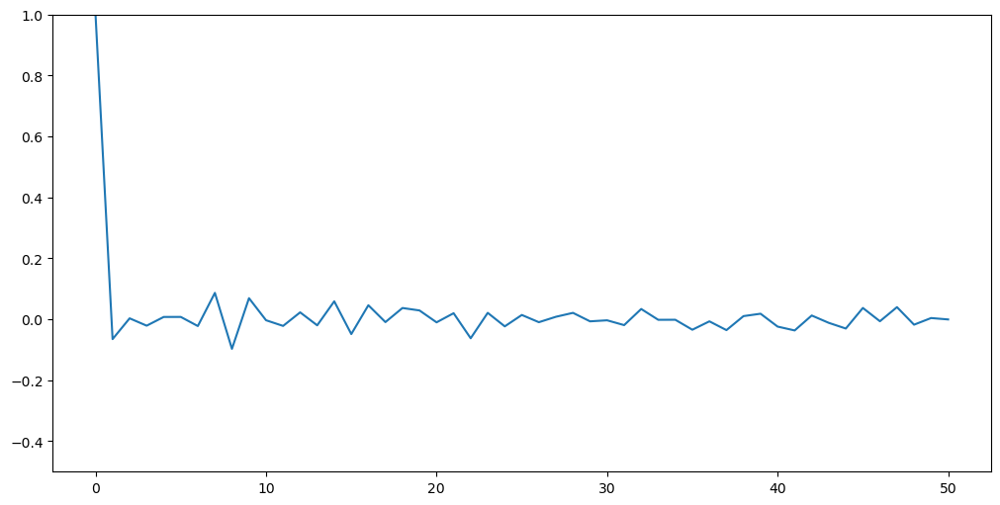

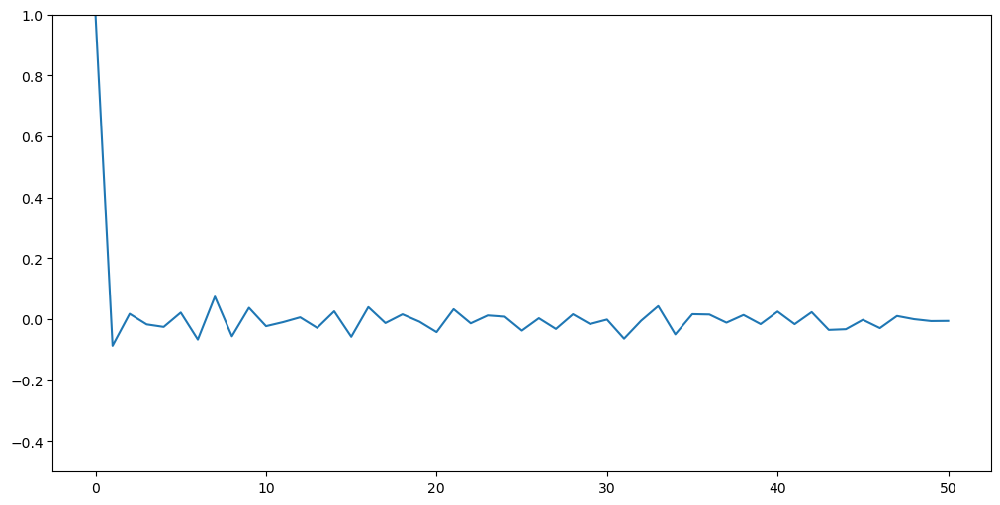

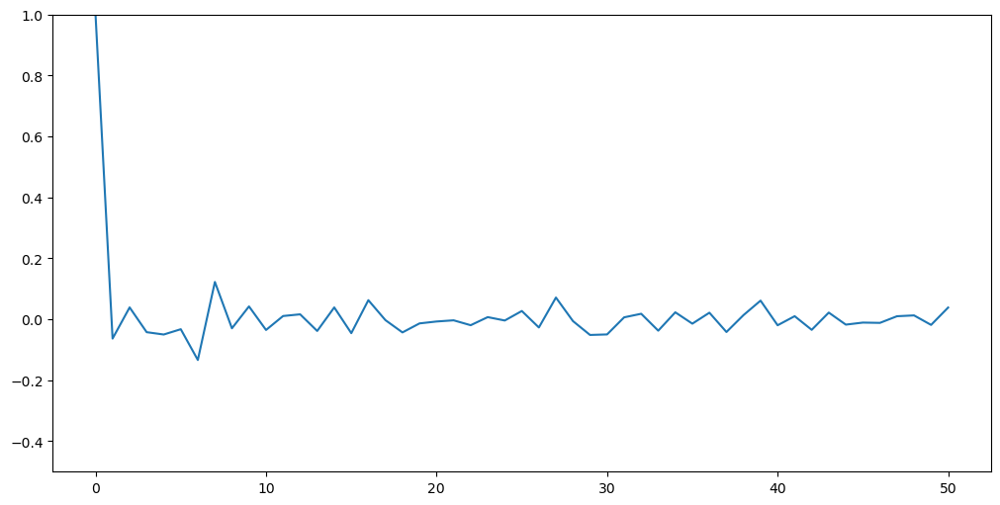

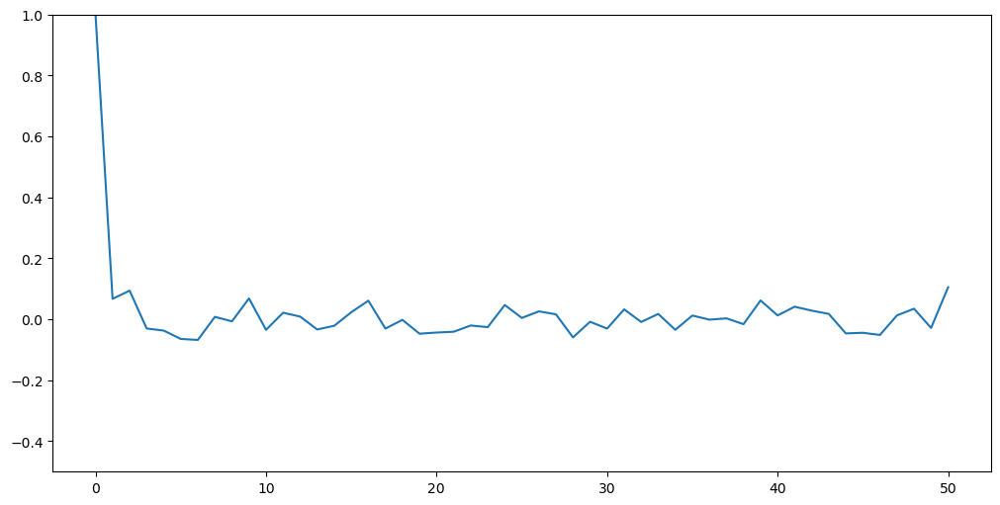

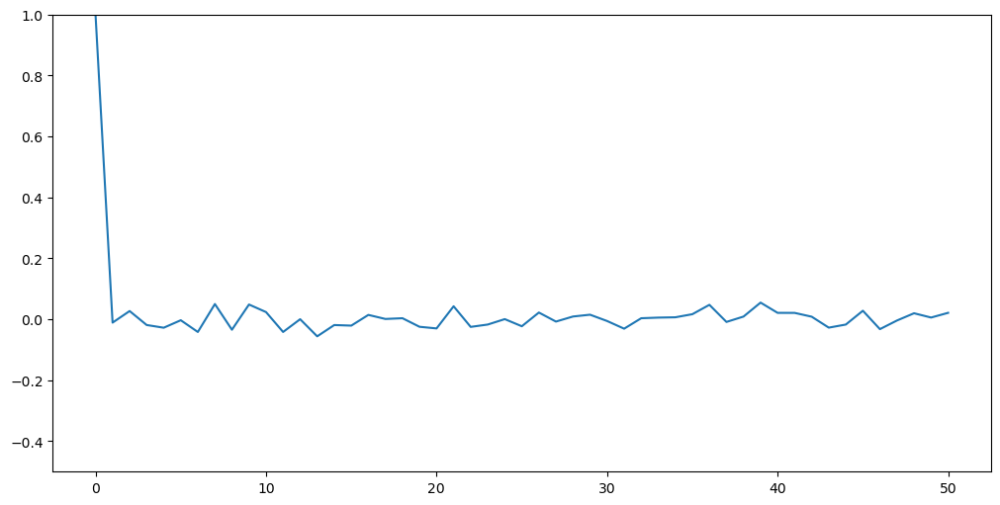

...

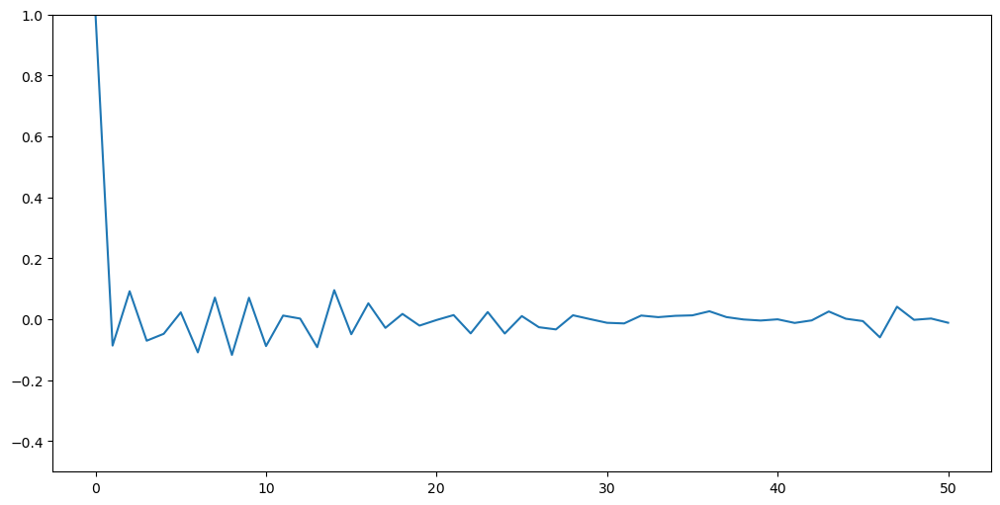

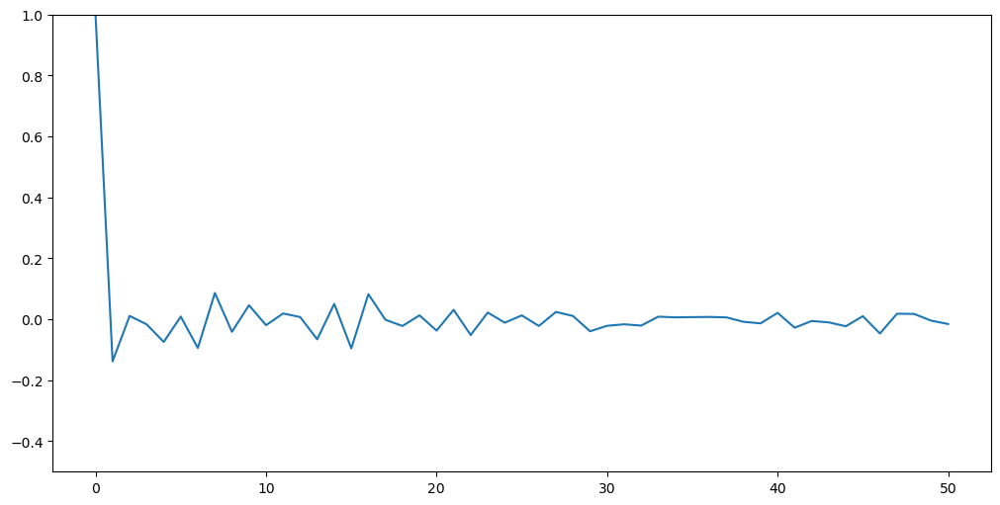

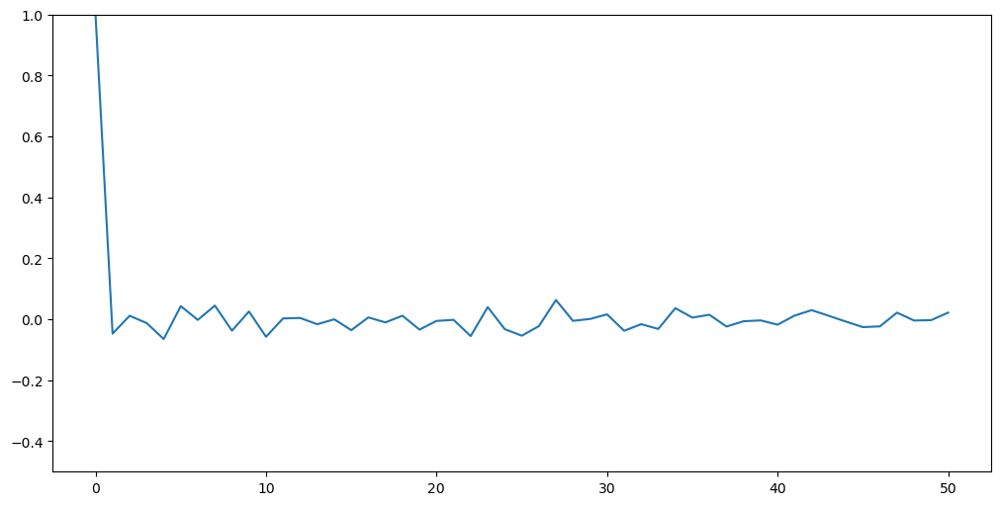

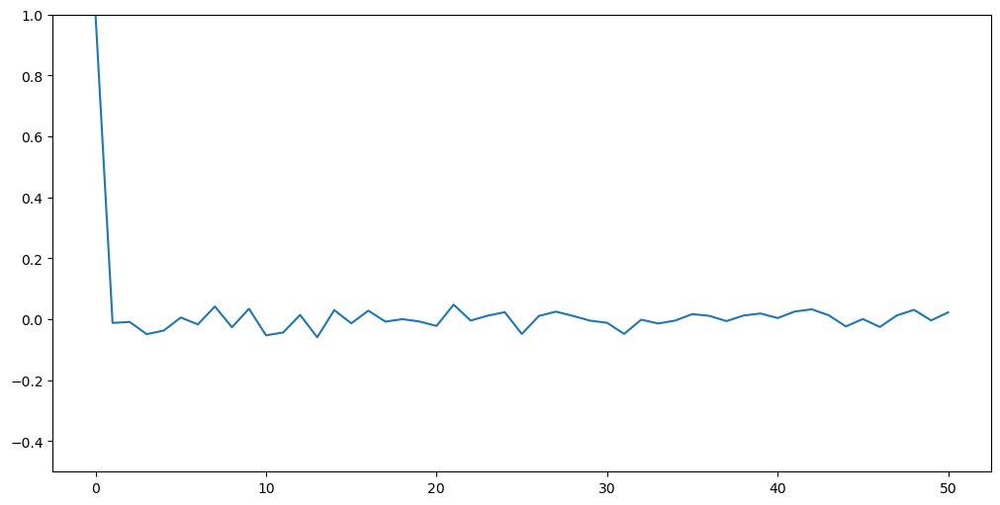

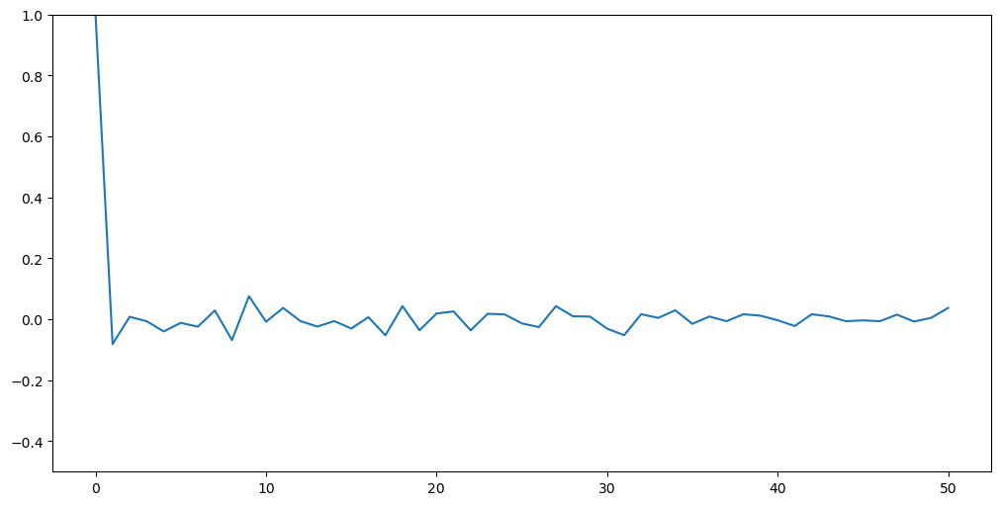

In [27]:
for i,tic in enumerate(tics):
    values=data_dict[tic]["pct_return"]
    corr_list=[]
    fig, ax = plt.subplots(1, 1, figsize=(10,5),constrained_layout=True)
#     for n in range(50):
    corr=sm.tsa.acf(values, nlags=50)
        # using shift function to shift the values.
#         dataframe = pd.concat([values.shift(1*n), values], axis=1)

        # using corr() function to compute the correlation
#         result = dataframe.corr().iloc[0,1]
#         result = np.correlate(values, values.shift(1*n), mode='full')
#         display(result)
#         corr_list.append(result)
    ax.plot(corr)
    ax.set_ylim([-0.5, 1])
    plt.show()

#### daily log return

0       0.000000
1       0.005360
2       0.011041
3       0.010400
4      -0.001588
          ...   
2512    0.022715
2513   -0.005784
2514    0.000502
2515   -0.006600
2516   -0.003542
Name: log_rtn, Length: 2517, dtype: float64

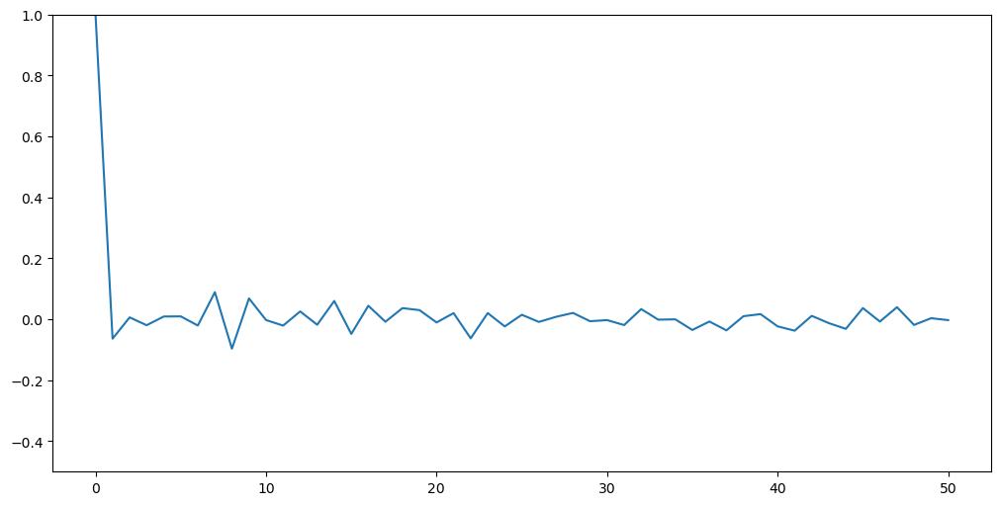

0       0.000000
1      -0.005475
2       0.010143
3       0.005419
4      -0.008685
          ...   
2512    0.006148
2513    0.002661
2514    0.008073
2515   -0.004977
2516   -0.006645
Name: log_rtn, Length: 2517, dtype: float64

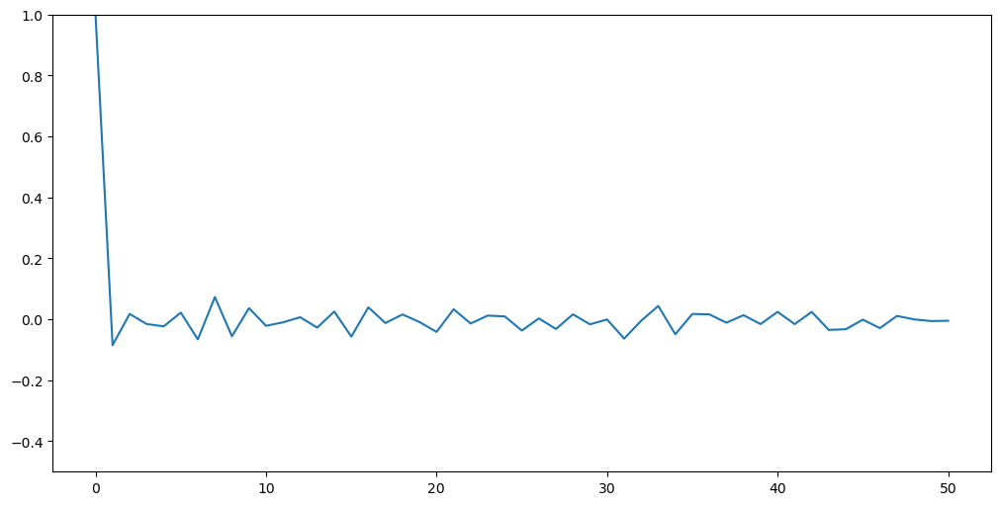

0       0.000000
1       0.000622
2       0.011541
3      -0.010920
4       0.002483
          ...   
2512    0.001217
2513    0.000122
2514   -0.003534
2515    0.002012
2516   -0.003417
Name: log_rtn, Length: 2517, dtype: float64

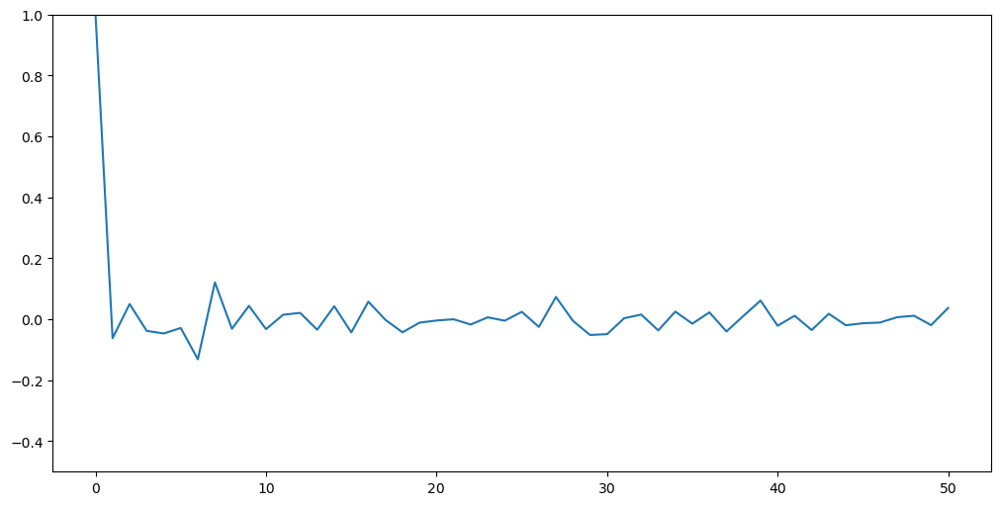

0       0.000000
1       0.001481
2      -0.010822
3       0.006102
4       0.007407
          ...   
2512   -0.005155
2513    0.014464
2514   -0.012055
2515   -0.004676
2516   -0.006881
Name: log_rtn, Length: 2517, dtype: float64

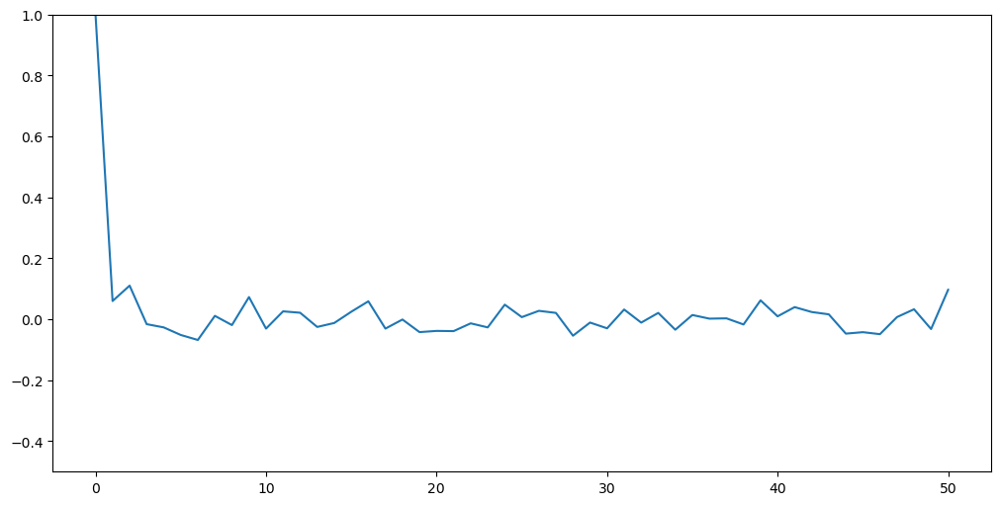

0       0.000000
1       0.009215
2       0.007039
3       0.002510
4       0.013896
          ...   
2512    0.000873
2513    0.001162
2514    0.003430
2515   -0.006047
2516    0.003197
Name: log_rtn, Length: 2517, dtype: float64

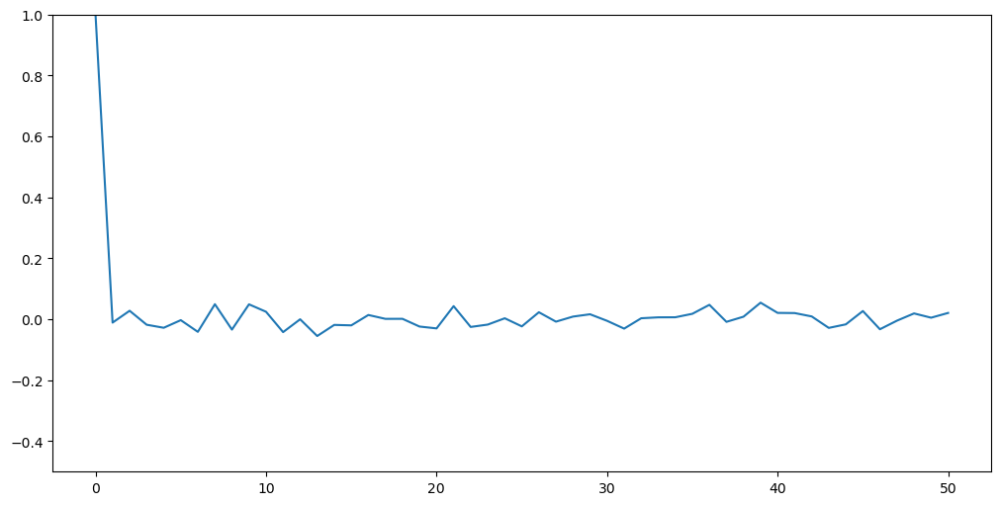

0       0.000000
1      -0.037451
2       0.013147
3       0.022920
4      -0.003072
          ...   
2512    0.020179
2513   -0.011095
2514   -0.003569
2515    0.003099
2516   -0.004711
Name: log_rtn, Length: 2517, dtype: float64

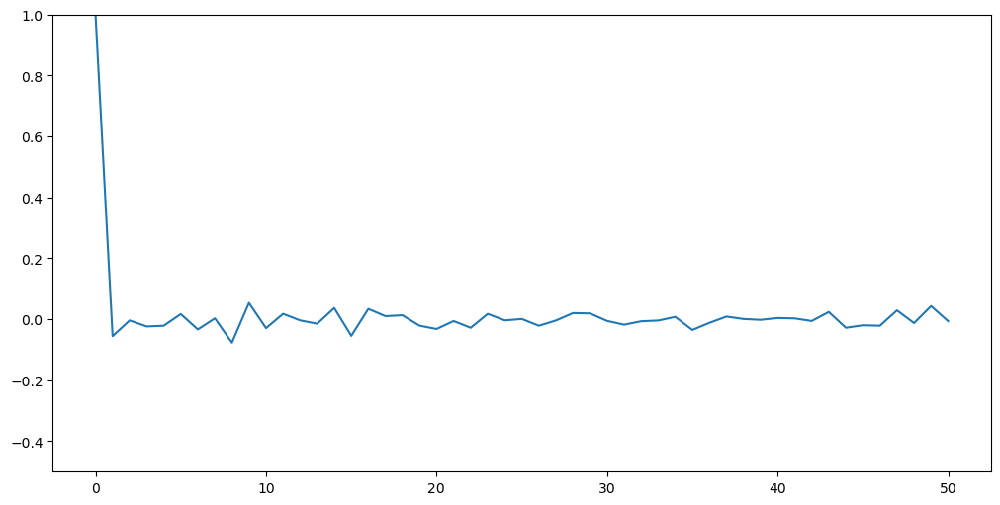

0       0.000000
1       0.019139
2      -0.003693
3      -0.003707
4       0.006346
          ...   
2512    0.018139
2513    0.001733
2514    0.006746
2515   -0.005330
2516   -0.003937
Name: log_rtn, Length: 2517, dtype: float64

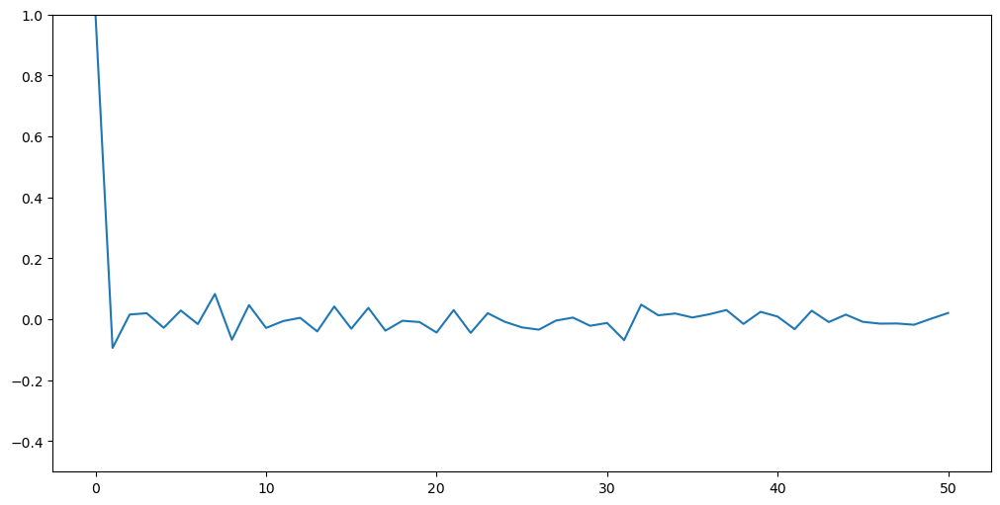

0       0.000000
1      -0.001723
2      -0.009850
3      -0.007268
4       0.010836
          ...   
2512    0.020239
2513   -0.001938
2514   -0.005158
2515   -0.004418
2516   -0.000681
Name: log_rtn, Length: 2517, dtype: float64

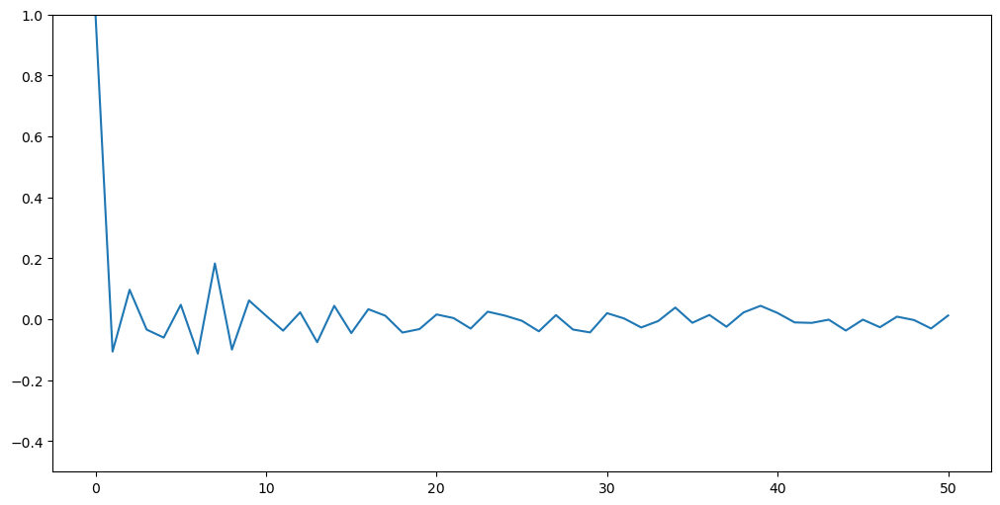

0       0.000000
1       0.013997
2       0.016592
3       0.010326
4      -0.004017
          ...   
2512   -0.005417
2513    0.015585
2514   -0.002129
2515    0.006821
2516   -0.006692
Name: log_rtn, Length: 2517, dtype: float64

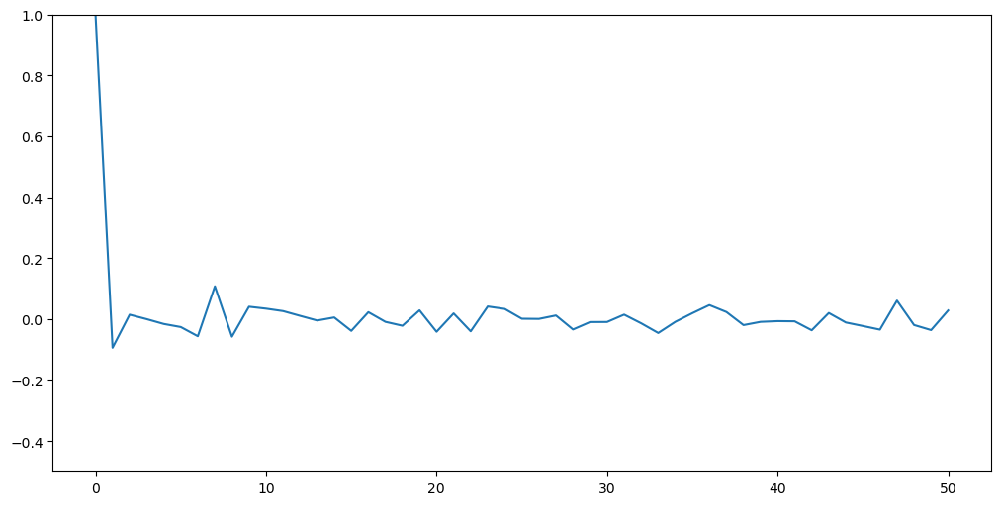

0       0.000000
1      -0.006523
2      -0.001690
3      -0.012340
4       0.013503
          ...   
2512    0.007761
2513   -0.001109
2514   -0.003644
2515   -0.001762
2516   -0.007734
Name: log_rtn, Length: 2517, dtype: float64

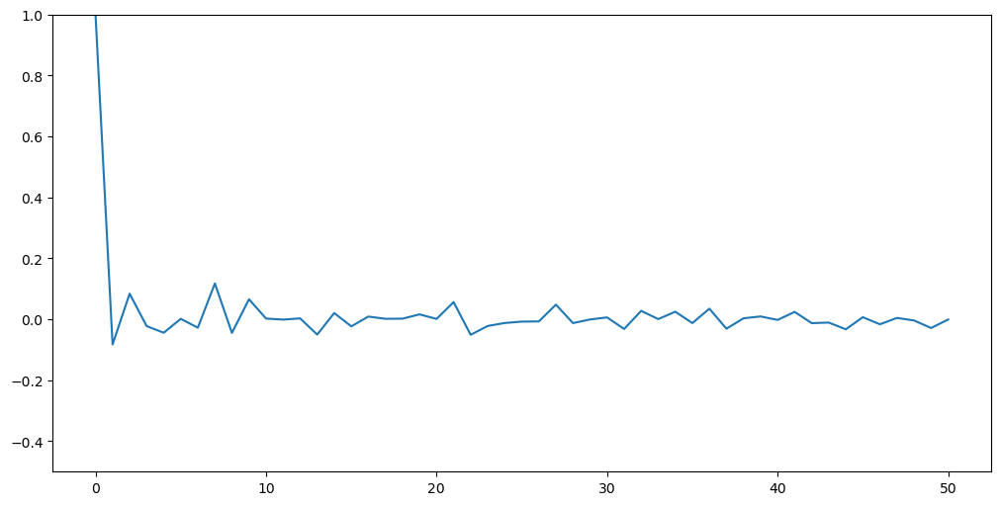

0       0.000000
1       0.014138
2       0.008156
3       0.002549
4       0.000694
          ...   
2512    0.017525
2513    0.005257
2514    0.011309
2515   -0.002193
2516    0.012292
Name: log_rtn, Length: 2517, dtype: float64

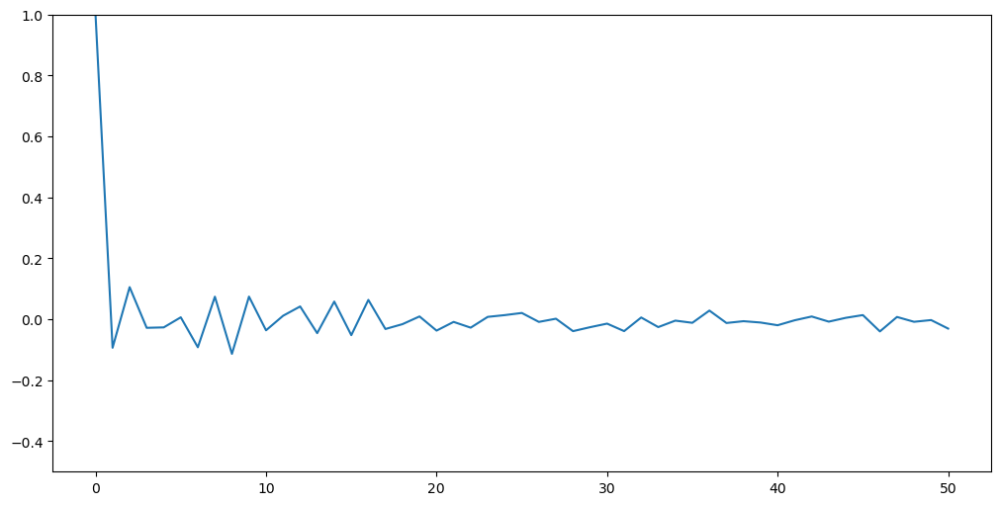

0       0.000000
1      -0.000900
2       0.001080
3      -0.007403
4       0.008302
          ...   
2512    0.005879
2513    0.002999
2514    0.002316
2515   -0.002026
2516    0.006737
Name: log_rtn, Length: 2517, dtype: float64

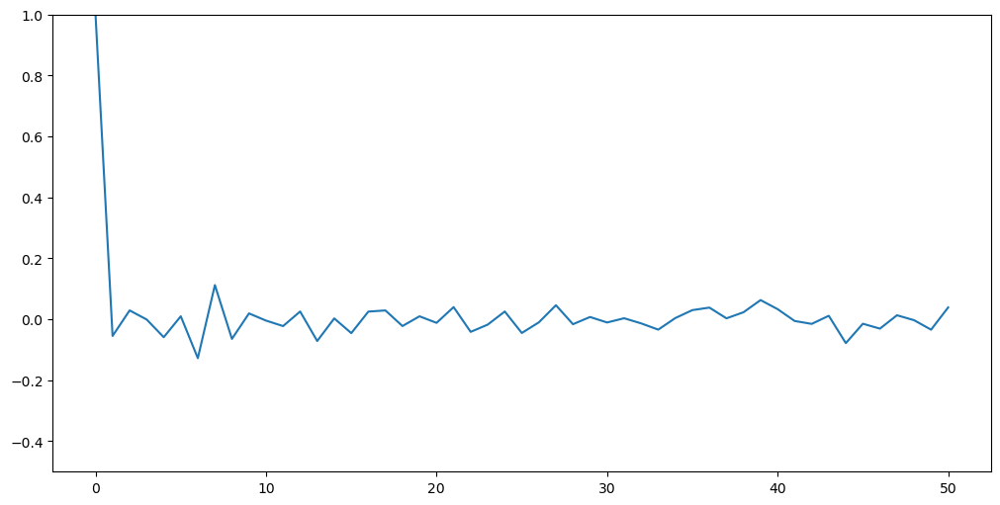

0       0.000000
1      -0.004088
2      -0.004754
3      -0.011547
4      -0.005218
          ...   
2512    0.007550
2513    0.007644
2514    0.005414
2515    0.004191
2516   -0.001869
Name: log_rtn, Length: 2517, dtype: float64

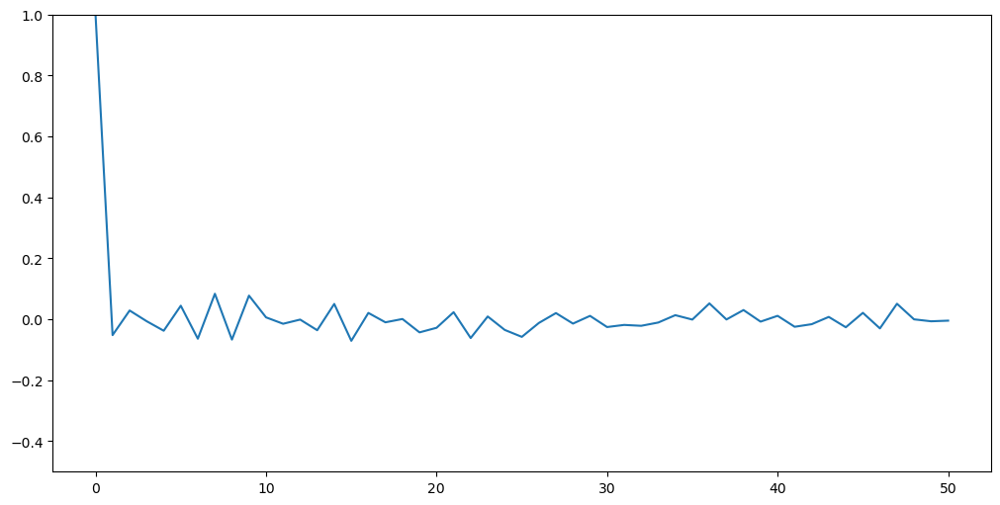

0       0.000000
1       0.022962
2       0.011483
3      -0.005923
4       0.008675
          ...   
2512    0.012203
2513   -0.003472
2514    0.001352
2515   -0.001738
2516   -0.004649
Name: log_rtn, Length: 2517, dtype: float64

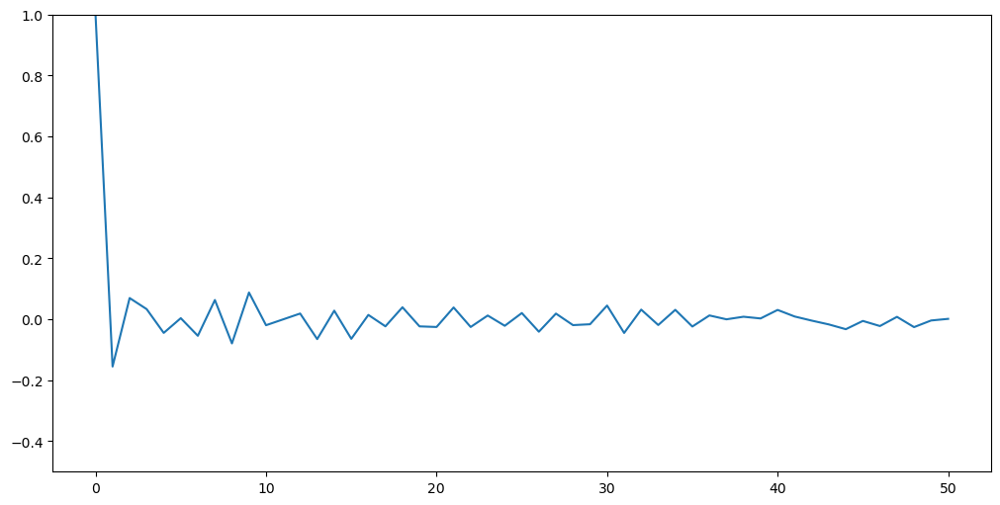

0       0.000000
1      -0.006090
2      -0.001223
3      -0.008754
4       0.001542
          ...   
2512    0.008404
2513    0.004000
2514    0.007019
2515    0.004420
2516   -0.007222
Name: log_rtn, Length: 2517, dtype: float64

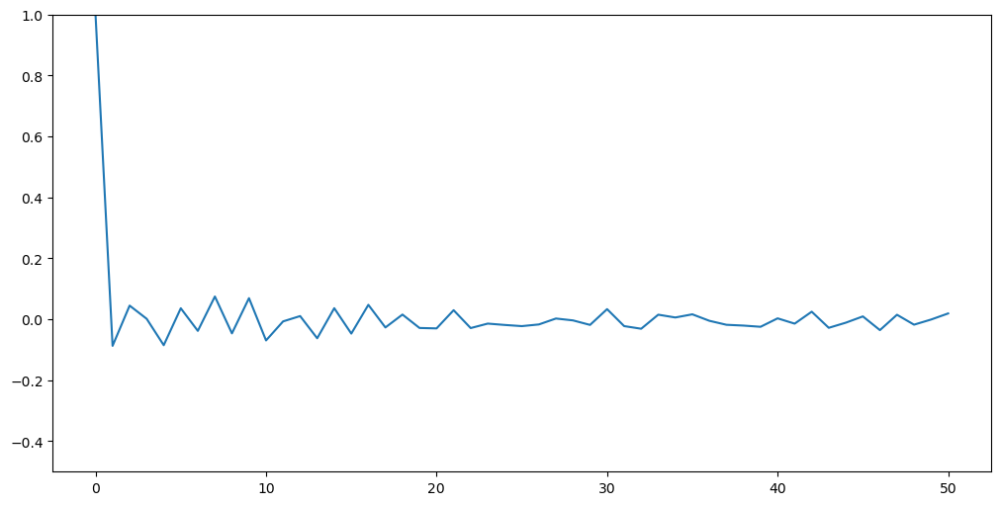

0       0.000000
1       0.006315
2       0.020672
3      -0.009009
4      -0.001698
          ...   
2512    0.005707
2513    0.003030
2514   -0.000504
2515   -0.000505
2516   -0.000821
Name: log_rtn, Length: 2517, dtype: float64

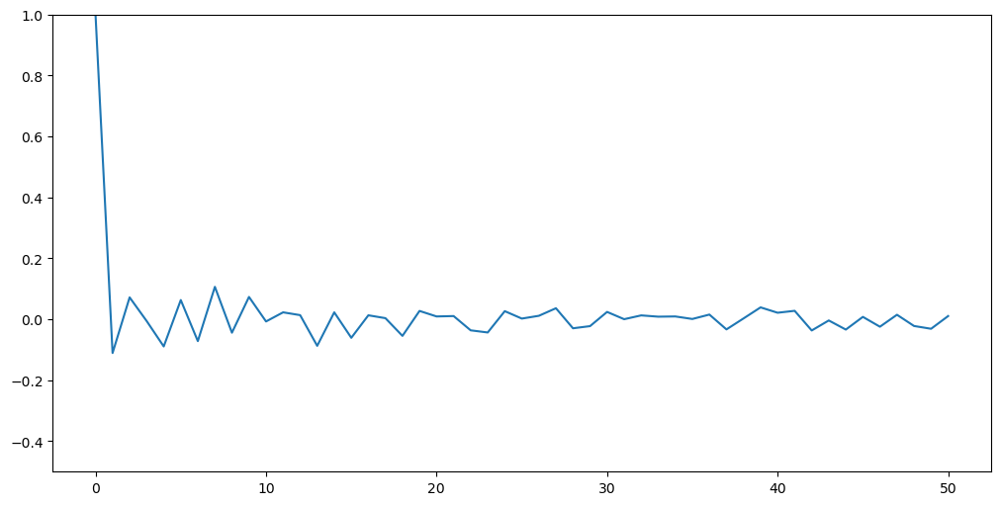

0       0.000000
1      -0.006293
2      -0.004746
3      -0.006363
4       0.000000
          ...   
2512    0.007359
2513    0.003914
2514    0.001188
2515   -0.002888
2516    0.007289
Name: log_rtn, Length: 2517, dtype: float64

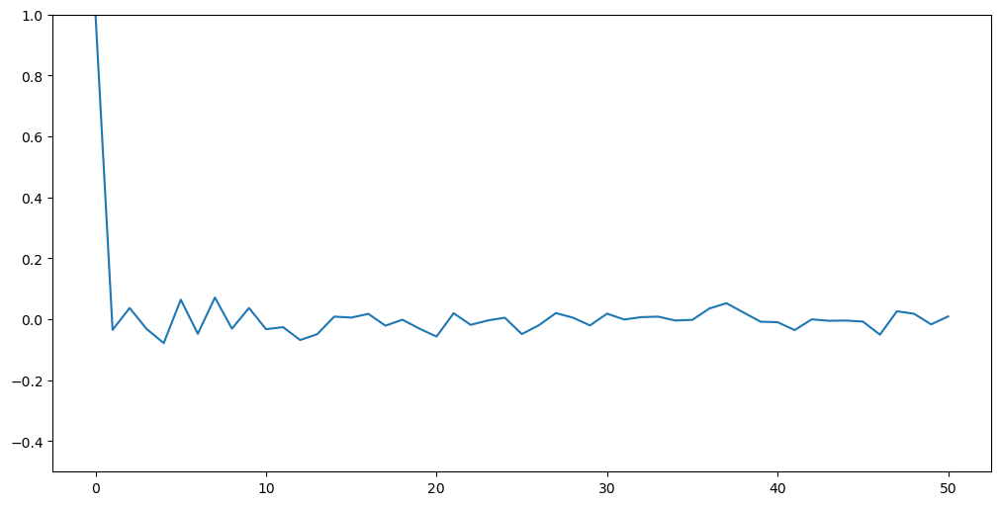

0       0.000000
1       0.005549
2       0.004417
3       0.007684
4      -0.009589
          ...   
2512    0.008574
2513   -0.001343
2514    0.002274
2515   -0.004779
2516    0.003213
Name: log_rtn, Length: 2517, dtype: float64

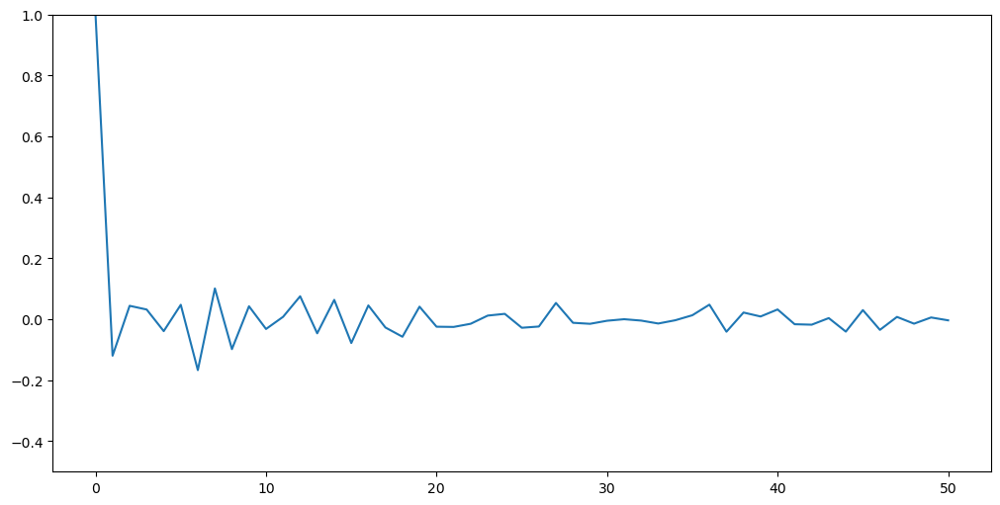

0       0.000000
1       0.008231
2      -0.004525
3      -0.005144
4       0.005980
          ...   
2512    0.009839
2513    0.005306
2514    0.004325
2515   -0.004325
2516   -0.000056
Name: log_rtn, Length: 2517, dtype: float64

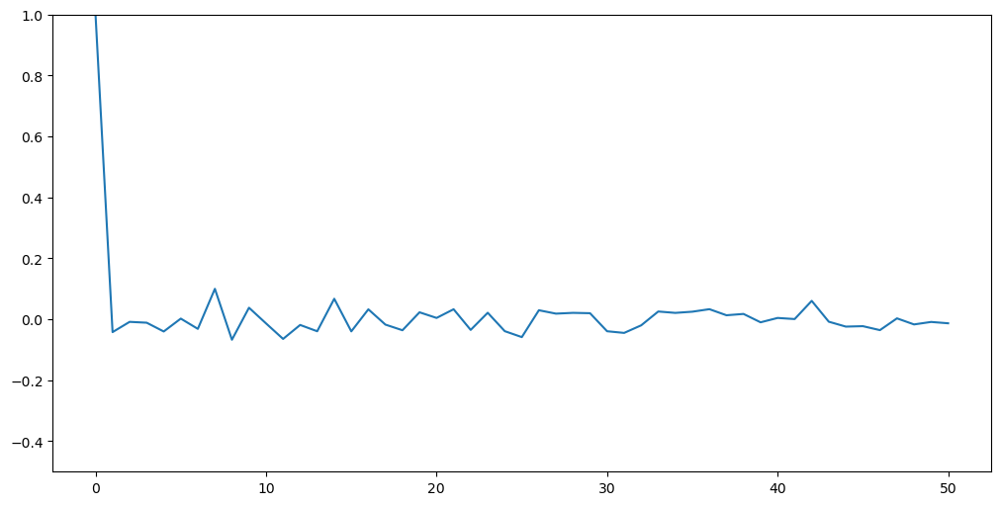

0       0.000000
1       0.001044
2       0.010378
3      -0.006994
4      -0.002082
          ...   
2512    0.011031
2513    0.003130
2514    0.001821
2515    0.002466
2516   -0.006503
Name: log_rtn, Length: 2517, dtype: float64

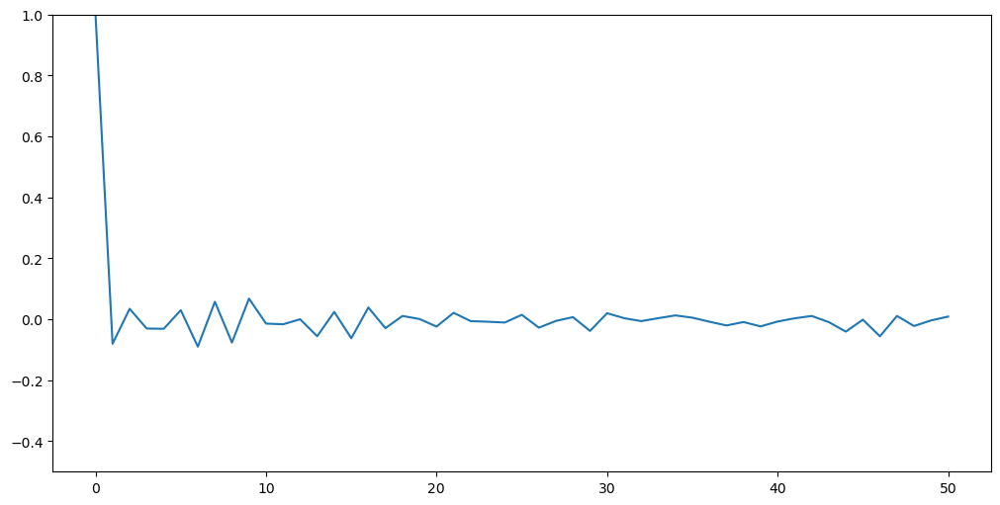

0       0.000000
1       0.023261
2       0.010167
3       0.015415
4      -0.013250
          ...   
2512    0.022921
2513   -0.003510
2514    0.002049
2515   -0.007721
2516   -0.008880
Name: log_rtn, Length: 2517, dtype: float64

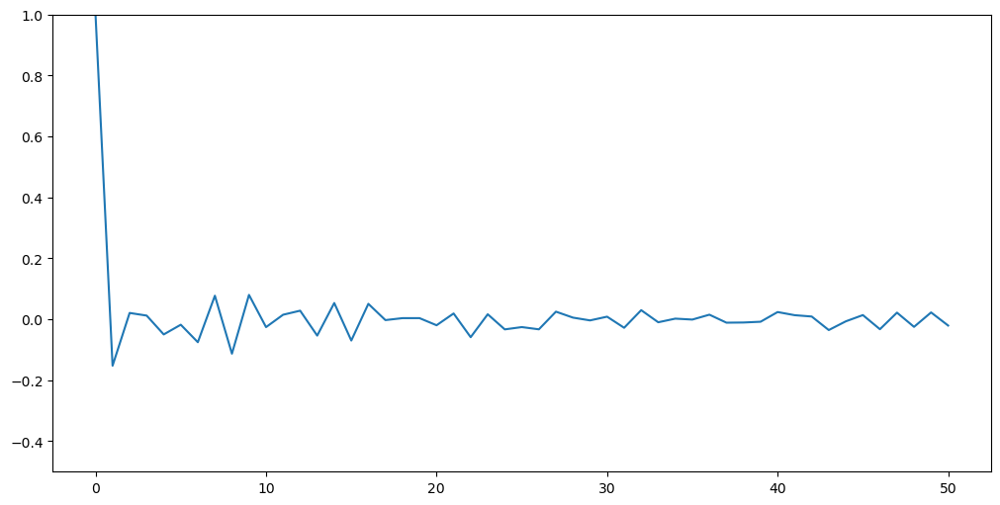

0       0.000000
1       0.014460
2      -0.000611
3      -0.001733
4       0.003667
          ...   
2512    0.011463
2513   -0.006946
2514    0.014081
2515   -0.007672
2516   -0.004908
Name: log_rtn, Length: 2517, dtype: float64

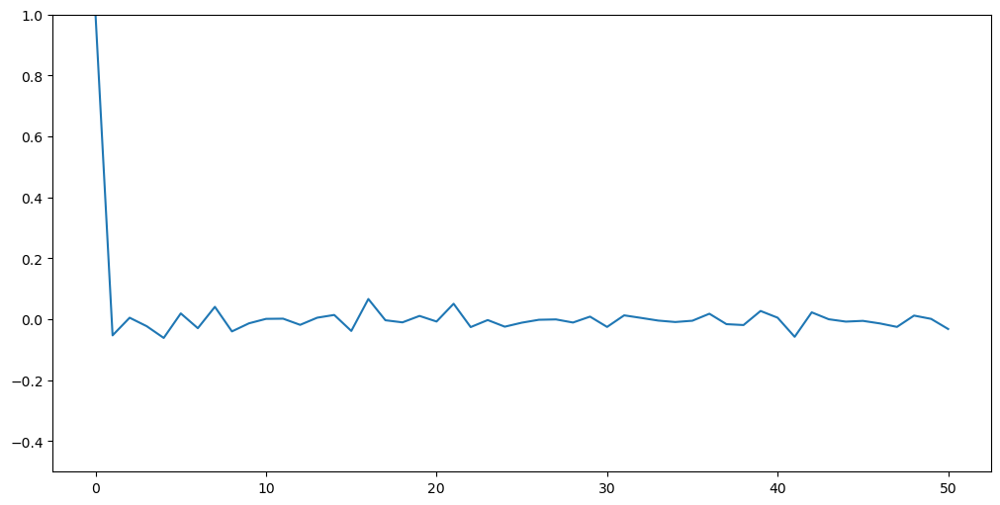

0       0.000000
1      -0.000449
2      -0.004201
3      -0.002408
4       0.004210
          ...   
2512    0.011613
2513    0.005357
2514    0.008256
2515   -0.008686
2516    0.004964
Name: log_rtn, Length: 2517, dtype: float64

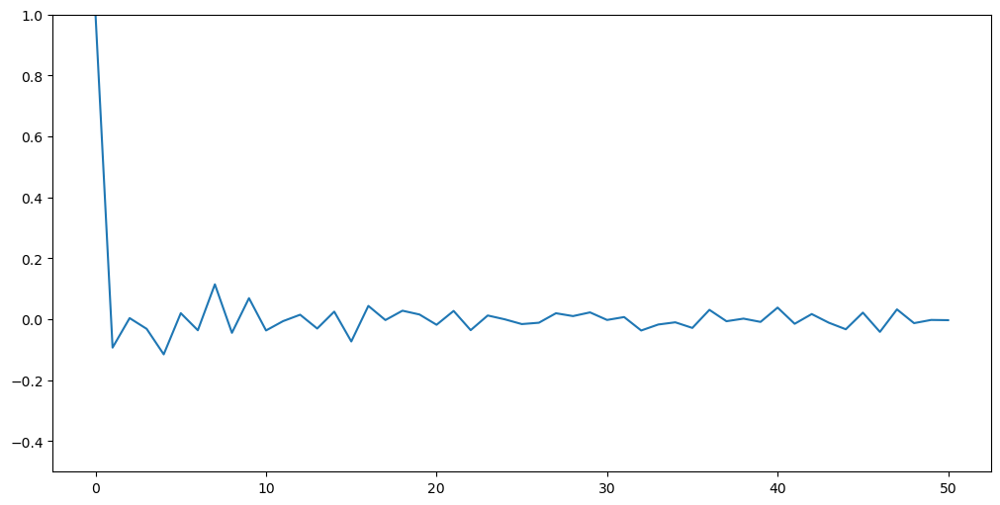

0       0.000000
1      -0.004077
2       0.009824
3       0.000337
4       0.005712
          ...   
2512    0.008948
2513    0.006897
2514    0.002416
2515   -0.004391
2516   -0.002426
Name: log_rtn, Length: 2517, dtype: float64

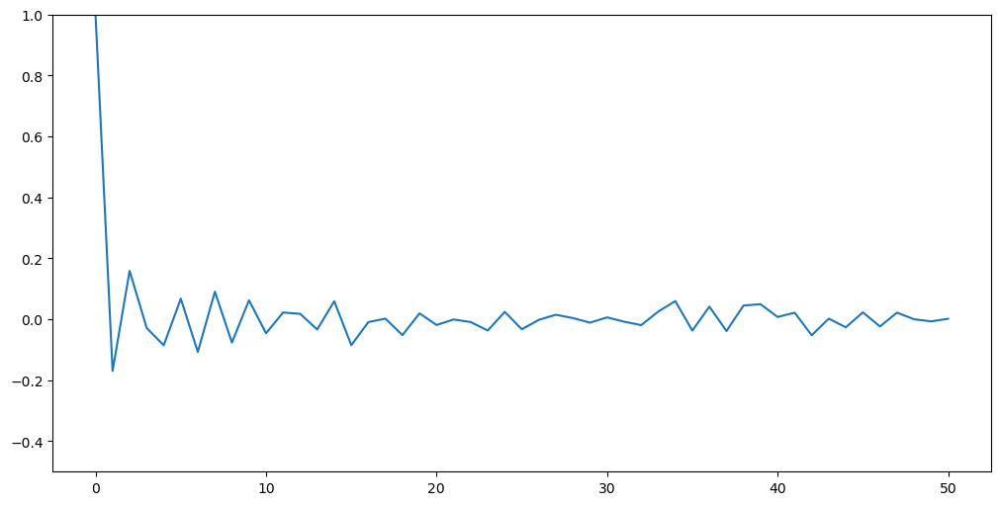

0       0.000000
1       0.014461
2       0.006677
3       0.003607
4      -0.001137
          ...   
2512    0.008283
2513    0.006863
2514    0.005235
2515   -0.002277
2516   -0.004550
Name: log_rtn, Length: 2517, dtype: float64

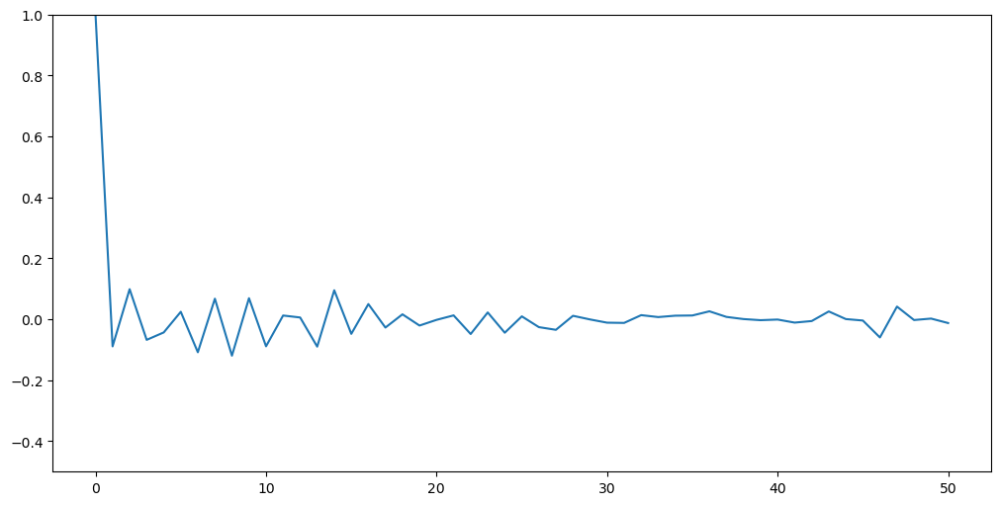

0       0.000000
1      -0.018027
2       0.007485
3      -0.011845
4      -0.008075
          ...   
2512    0.004652
2513    0.001928
2514    0.000550
2515   -0.001376
2516   -0.005338
Name: log_rtn, Length: 2517, dtype: float64

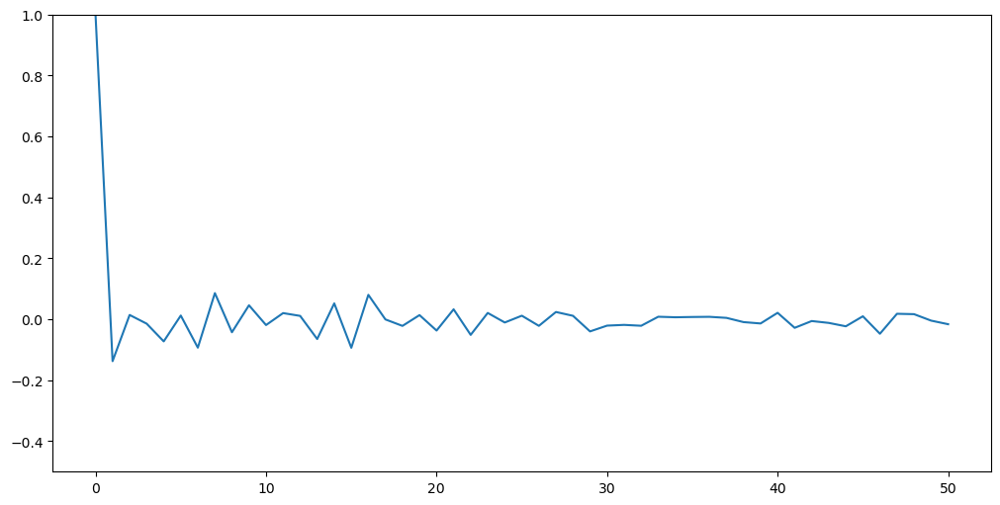

0       0.000000
1      -0.013174
2      -0.006910
3      -0.002865
4       0.001043
          ...   
2512    0.000000
2513    0.000759
2514   -0.006852
2515   -0.002103
2516   -0.005566
Name: log_rtn, Length: 2517, dtype: float64

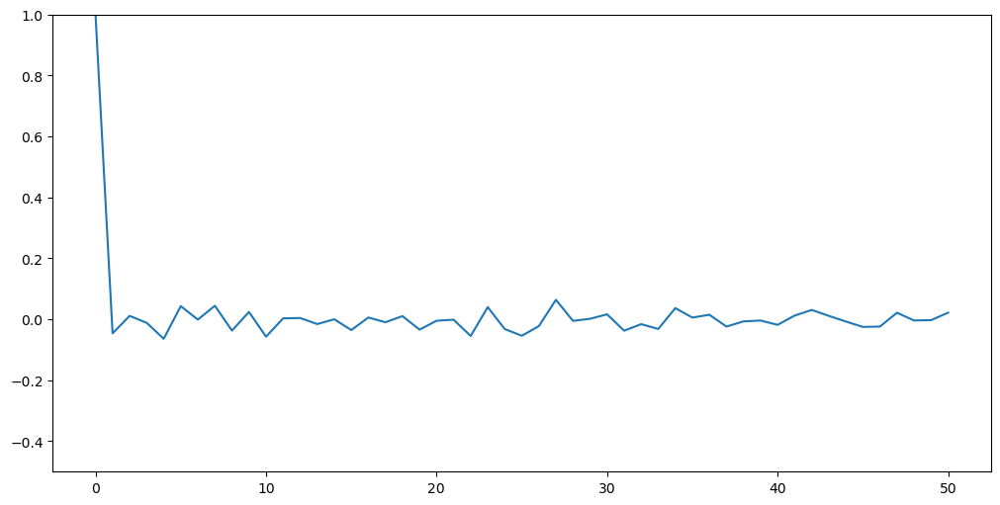

0       0.000000
1      -0.006982
2      -0.003356
3       0.010942
4       0.012617
          ...   
2512    0.004940
2513    0.013704
2514    0.015818
2515   -0.004988
2516    0.003265
Name: log_rtn, Length: 2517, dtype: float64

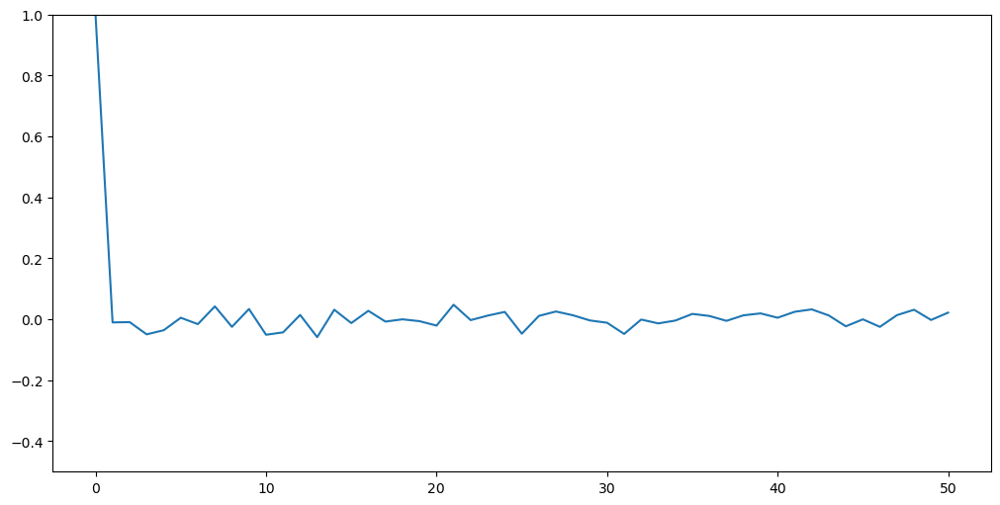

0       0.000000
1      -0.010330
2      -0.004869
3      -0.007093
4       0.003046
          ...   
2512    0.009063
2513    0.014249
2514   -0.000490
2515    0.003218
2516    0.010561
Name: log_rtn, Length: 2517, dtype: float64

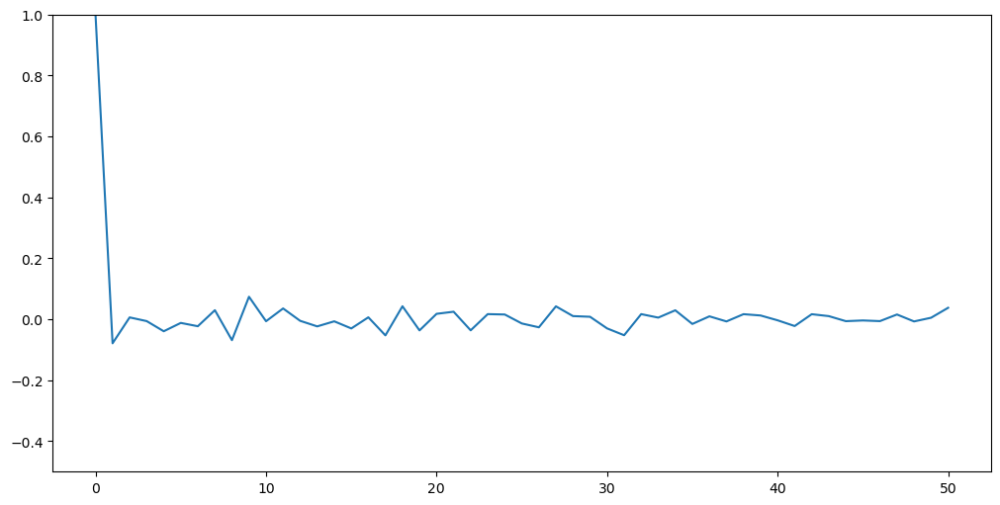

In [28]:
for i,tic in enumerate(tics):
    values=data_dict[tic]["log_rtn"]
    display(values)
    corr_list=[]
    fig, ax = plt.subplots(1, 1, figsize=(10,5),constrained_layout=True)
#     for n in range(50):
    corr=sm.tsa.acf(values, nlags=50)
        # using shift function to shift the values.
#         dataframe = pd.concat([values.shift(1*n), values], axis=1)

        # using corr() function to compute the correlation
#         result = dataframe.corr().iloc[0,1]
#         result = np.correlate(values, values.shift(1*n), mode='full')
#         display(result)
#         corr_list.append(result)
    ax.plot(corr)
    ax.set_ylim([-0.5, 1])
    plt.show()

#### daily abs return

0       0.000000
1       0.005374
2       0.011102
3       0.010454
4       0.001586
          ...   
2512    0.022975
2513    0.005767
2514    0.000502
2515    0.006578
2516    0.003535
Name: pct_return, Length: 2517, dtype: float64

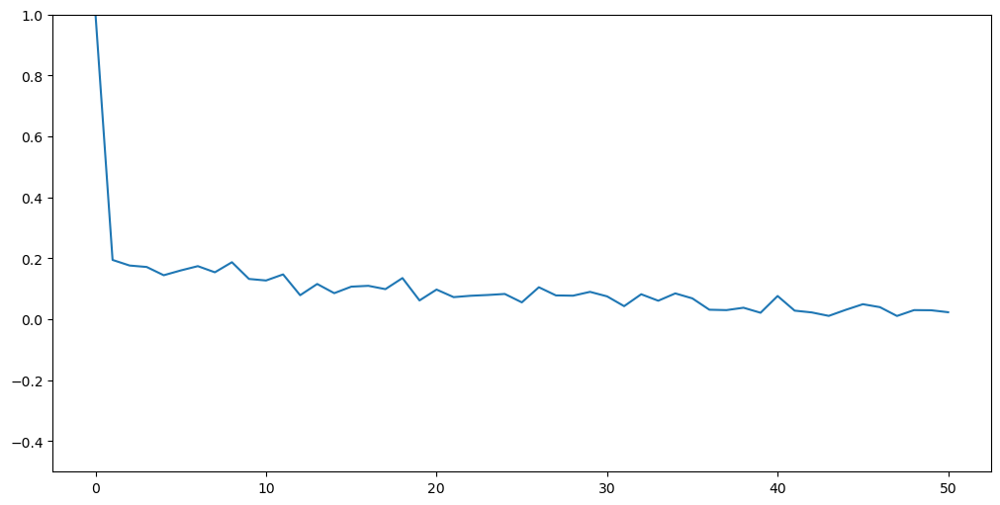

0       0.000000
1       0.005460
2       0.010195
3       0.005434
4       0.008647
          ...   
2512    0.006166
2513    0.002665
2514    0.008106
2515    0.004965
2516    0.006623
Name: pct_return, Length: 2517, dtype: float64

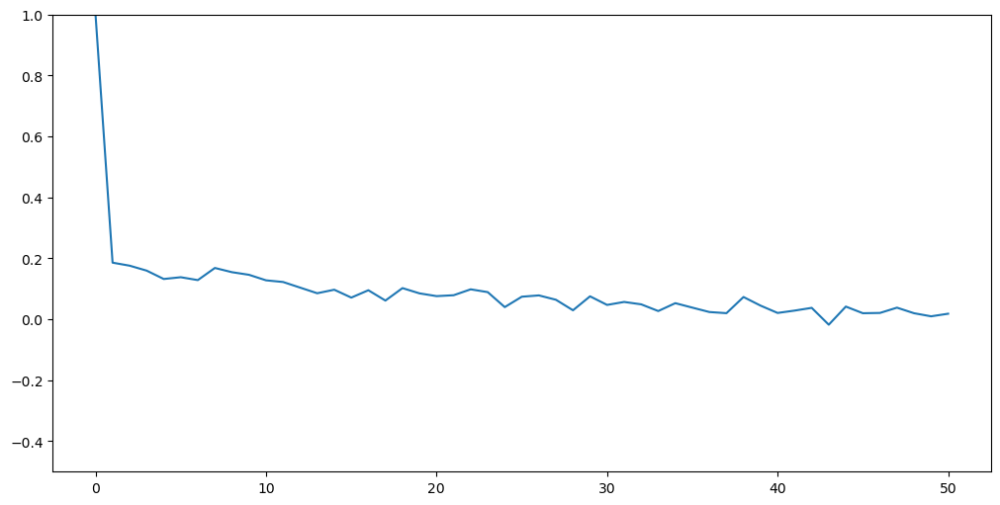

0       0.000000
1       0.000622
2       0.011608
3       0.010861
4       0.002486
          ...   
2512    0.001218
2513    0.000122
2514    0.003528
2515    0.002014
2516    0.003411
Name: pct_return, Length: 2517, dtype: float64

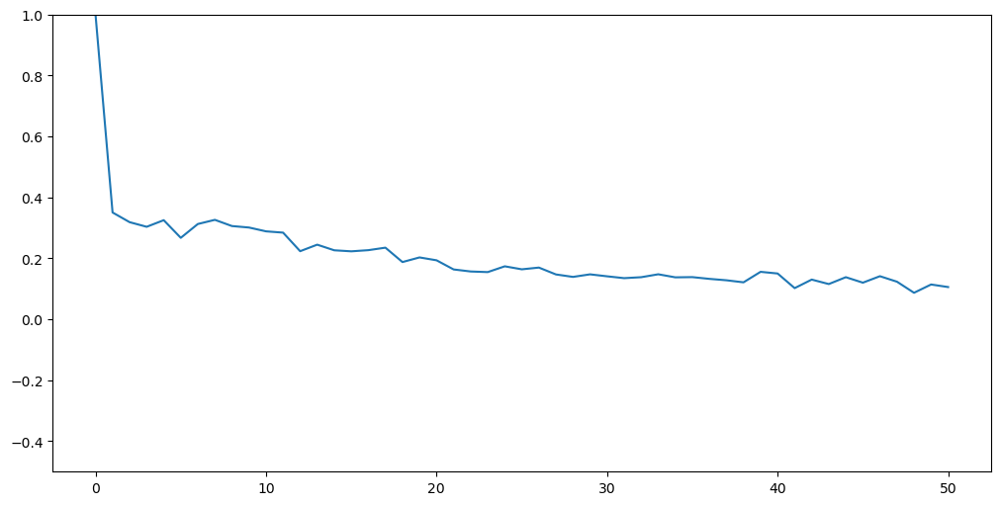

0       0.000000
1       0.001482
2       0.010763
3       0.006120
4       0.007434
          ...   
2512    0.005142
2513    0.014569
2514    0.011983
2515    0.004665
2516    0.006857
Name: pct_return, Length: 2517, dtype: float64

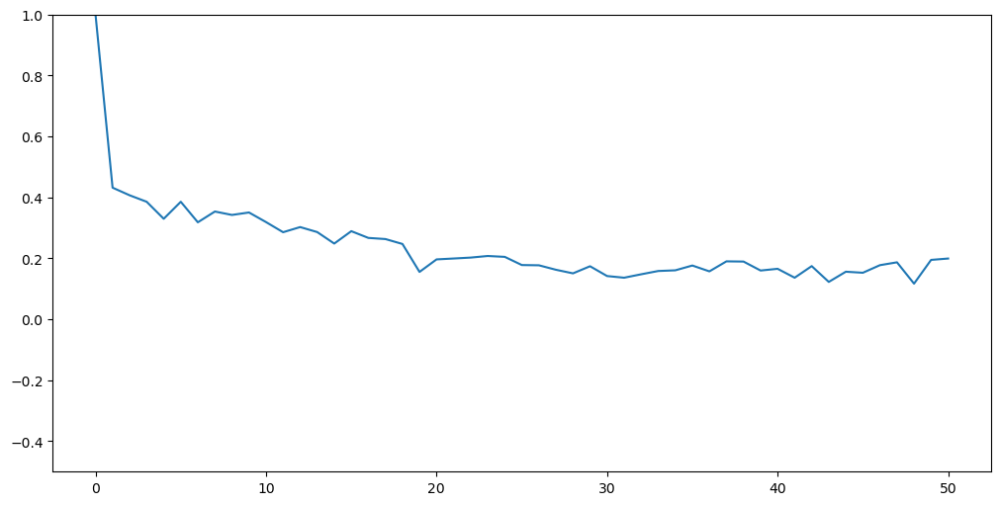

0       0.000000
1       0.009257
2       0.007063
3       0.002513
4       0.013993
          ...   
2512    0.000873
2513    0.001163
2514    0.003436
2515    0.006029
2516    0.003203
Name: pct_return, Length: 2517, dtype: float64

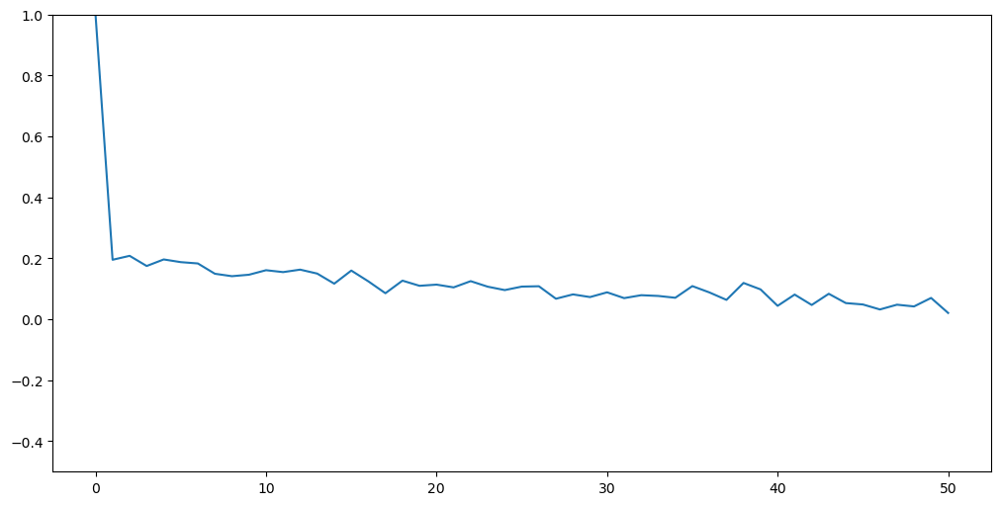

0       0.000000
1       0.036759
2       0.013233
3       0.023185
4       0.003067
          ...   
2512    0.020384
2513    0.011034
2514    0.003562
2515    0.003104
2516    0.004700
Name: pct_return, Length: 2517, dtype: float64

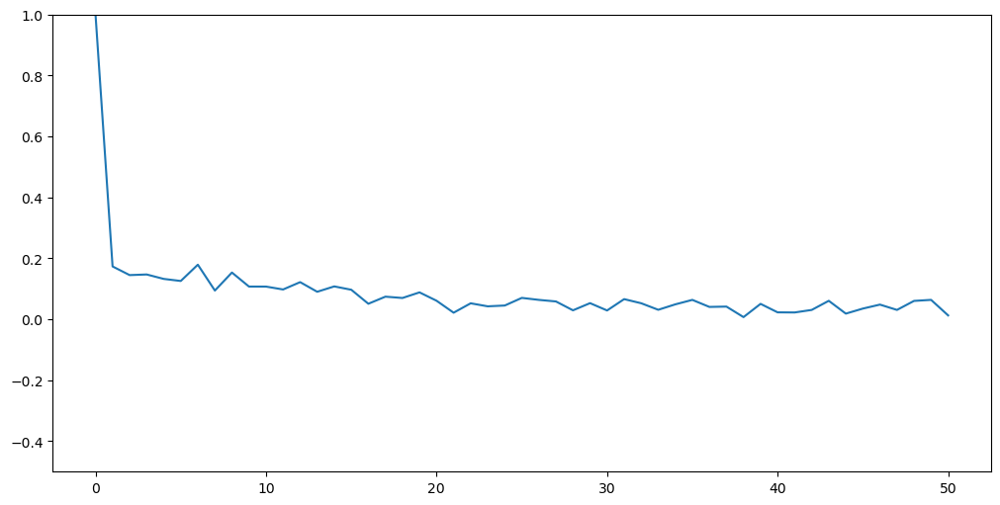

0       0.000000
1       0.019324
2       0.003686
3       0.003700
4       0.006366
          ...   
2512    0.018304
2513    0.001735
2514    0.006769
2515    0.005316
2516    0.003930
Name: pct_return, Length: 2517, dtype: float64

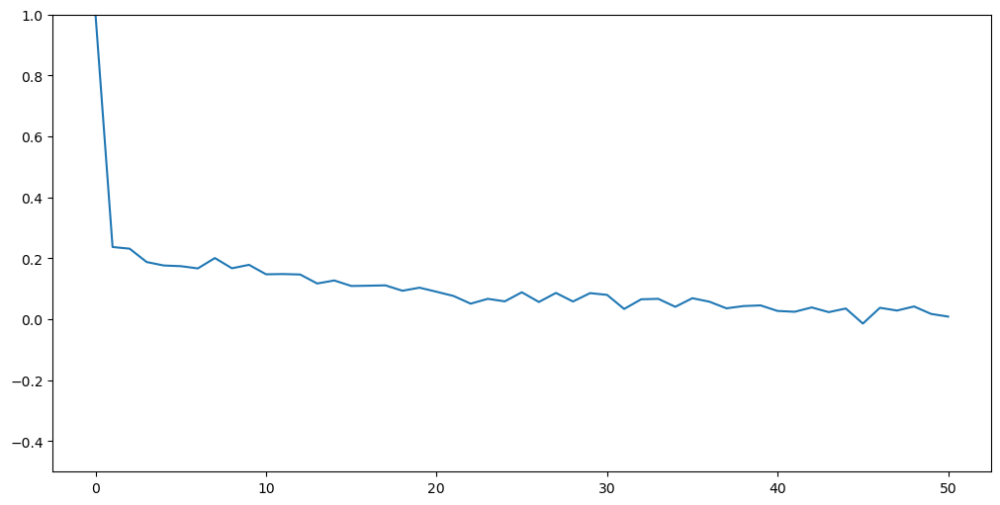

0       0.000000
1       0.001722
2       0.009802
3       0.007241
4       0.010895
          ...   
2512    0.020445
2513    0.001936
2514    0.005145
2515    0.004409
2516    0.000681
Name: pct_return, Length: 2517, dtype: float64

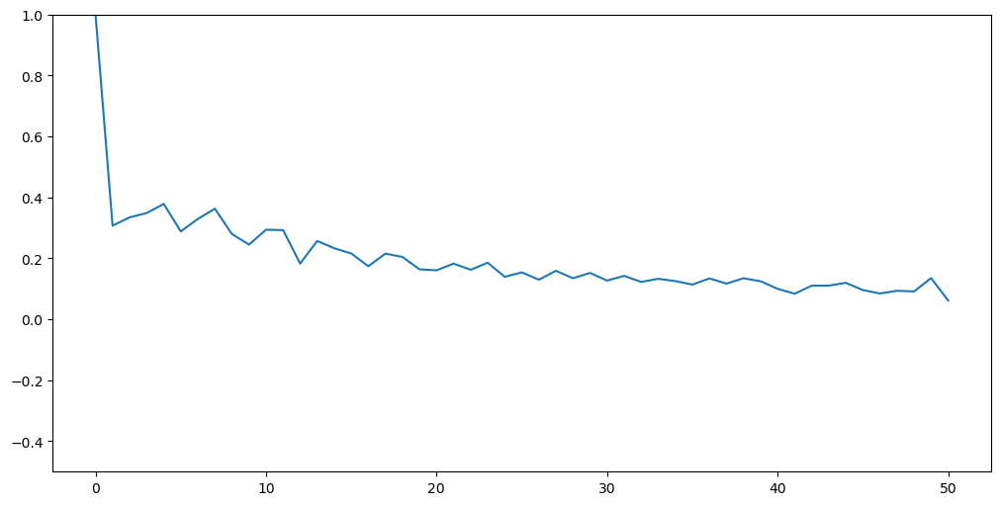

0       0.000000
1       0.014096
2       0.016731
3       0.010380
4       0.004009
          ...   
2512    0.005403
2513    0.015707
2514    0.002126
2515    0.006844
2516    0.006670
Name: pct_return, Length: 2517, dtype: float64

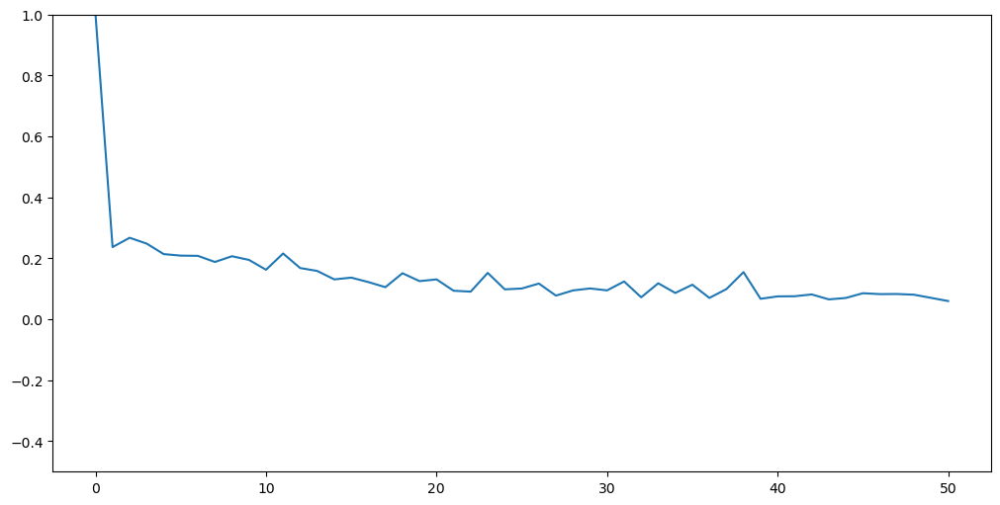

0       0.000000
1       0.006502
2       0.001689
3       0.012265
4       0.013594
          ...   
2512    0.007791
2513    0.001108
2514    0.003638
2515    0.001761
2516    0.007704
Name: pct_return, Length: 2517, dtype: float64

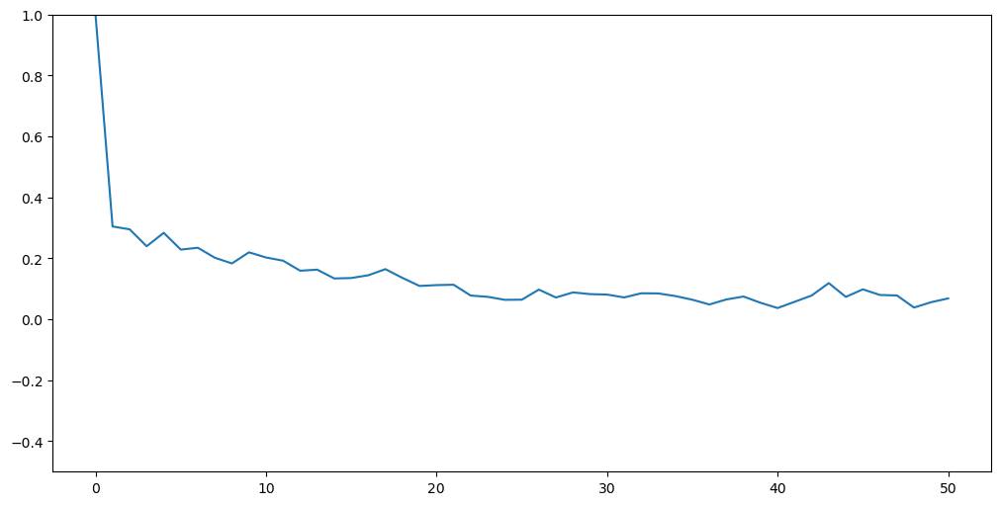

0       0.000000
1       0.014238
2       0.008189
3       0.002553
4       0.000694
          ...   
2512    0.017679
2513    0.005271
2514    0.011373
2515    0.002191
2516    0.012368
Name: pct_return, Length: 2517, dtype: float64

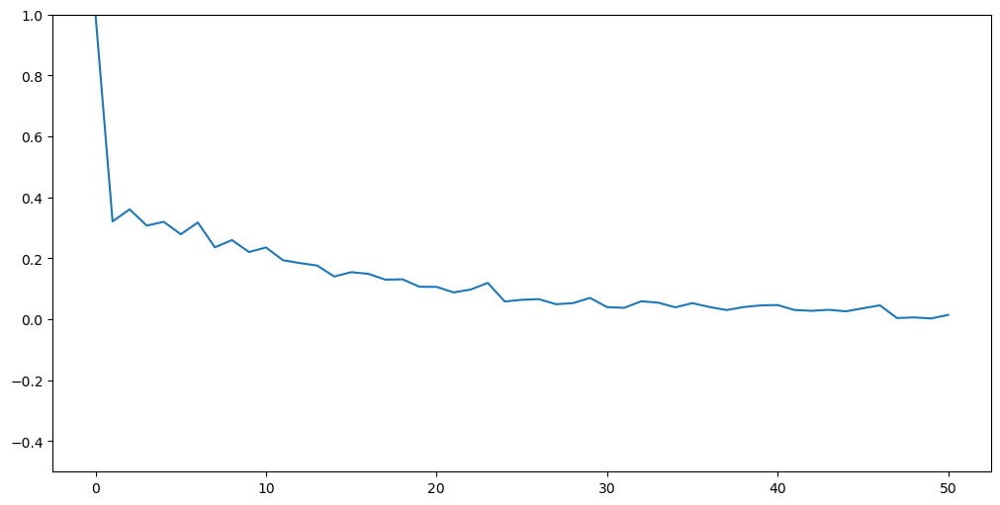

0       0.000000
1       0.000900
2       0.001080
3       0.007375
4       0.008337
          ...   
2512    0.005896
2513    0.003003
2514    0.002318
2515    0.002024
2516    0.006760
Name: pct_return, Length: 2517, dtype: float64

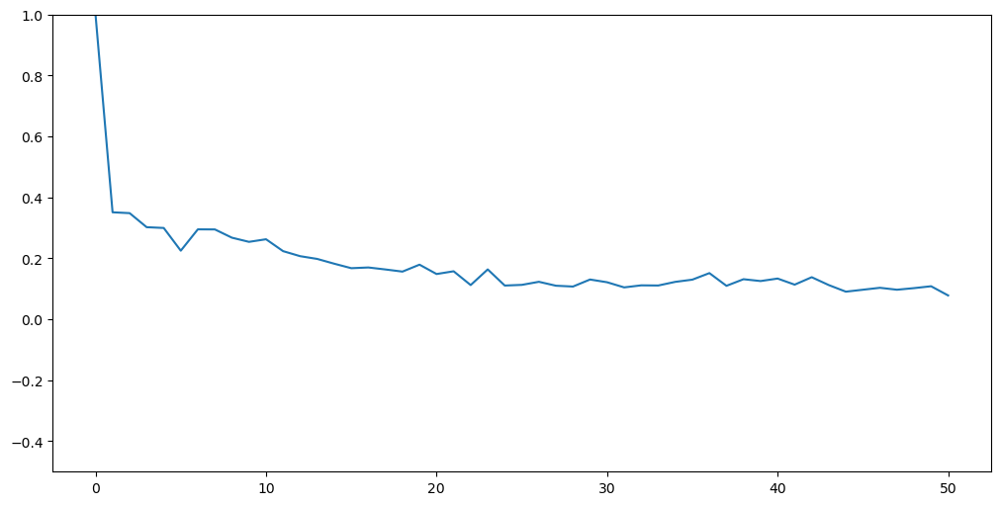

0       0.000000
1       0.004079
2       0.004743
3       0.011480
4       0.005204
          ...   
2512    0.007579
2513    0.007674
2514    0.005429
2515    0.004199
2516    0.001867
Name: pct_return, Length: 2517, dtype: float64

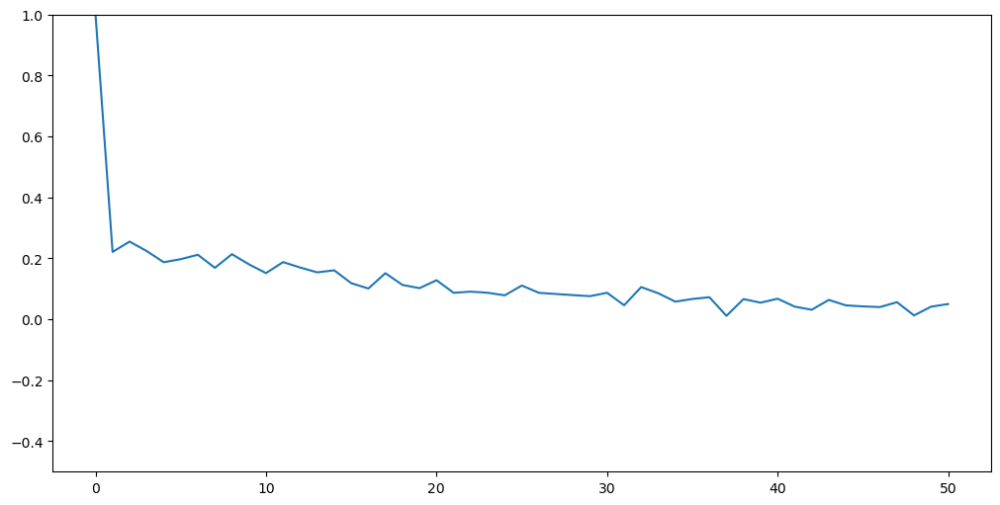

0       0.000000
1       0.023227
2       0.011549
3       0.005905
4       0.008713
          ...   
2512    0.012278
2513    0.003465
2514    0.001352
2515    0.001736
2516    0.004639
Name: pct_return, Length: 2517, dtype: float64

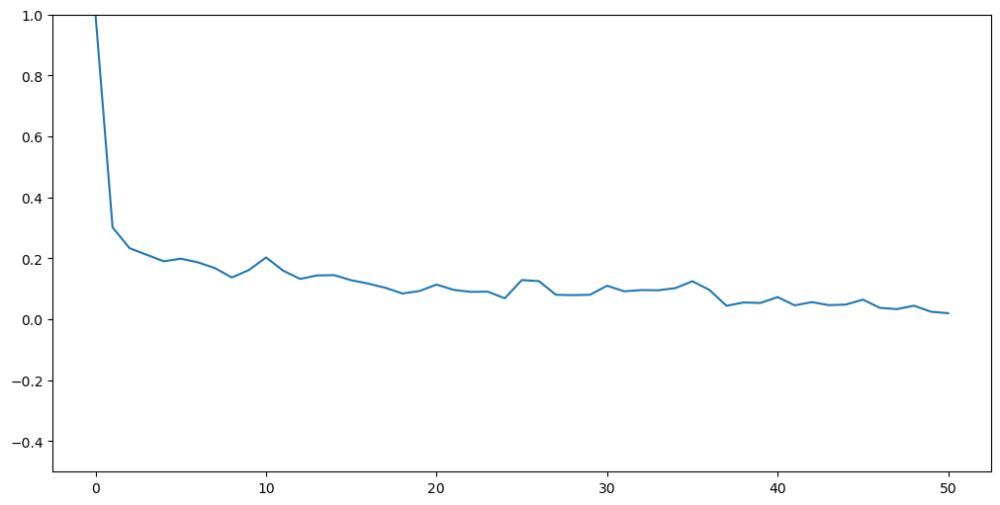

0       0.000000
1       0.006071
2       0.001222
3       0.008716
4       0.001543
          ...   
2512    0.008440
2513    0.004008
2514    0.007044
2515    0.004430
2516    0.007196
Name: pct_return, Length: 2517, dtype: float64

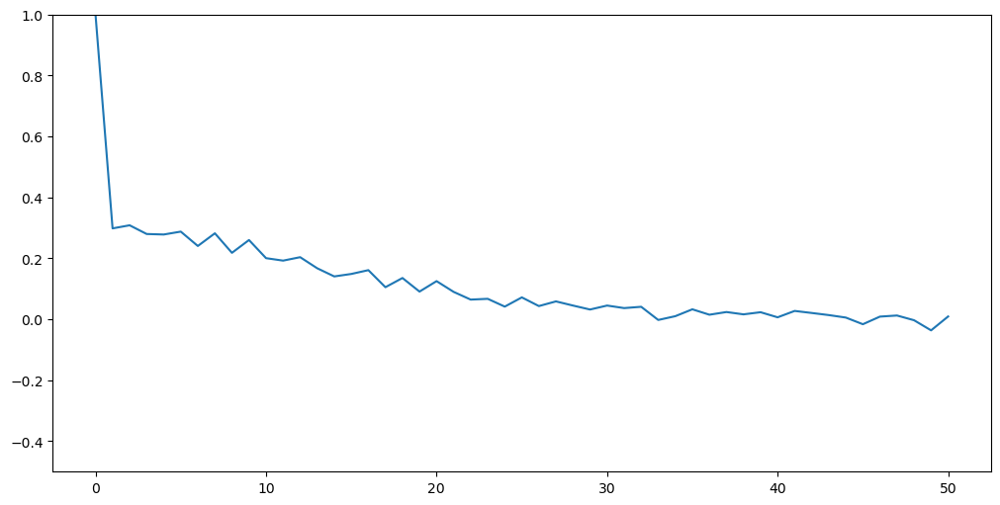

0       0.000000
1       0.006335
2       0.020887
3       0.008968
4       0.001697
          ...   
2512    0.005723
2513    0.003035
2514    0.000504
2515    0.000504
2516    0.000820
Name: pct_return, Length: 2517, dtype: float64

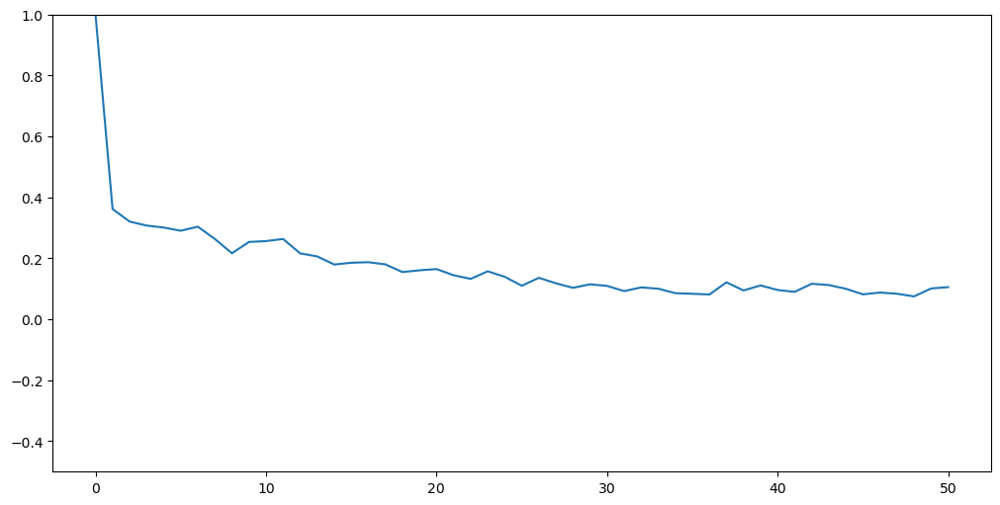

0       0.000000
1       0.006273
2       0.004735
3       0.006342
4       0.000000
          ...   
2512    0.007386
2513    0.003922
2514    0.001189
2515    0.002884
2516    0.007315
Name: pct_return, Length: 2517, dtype: float64

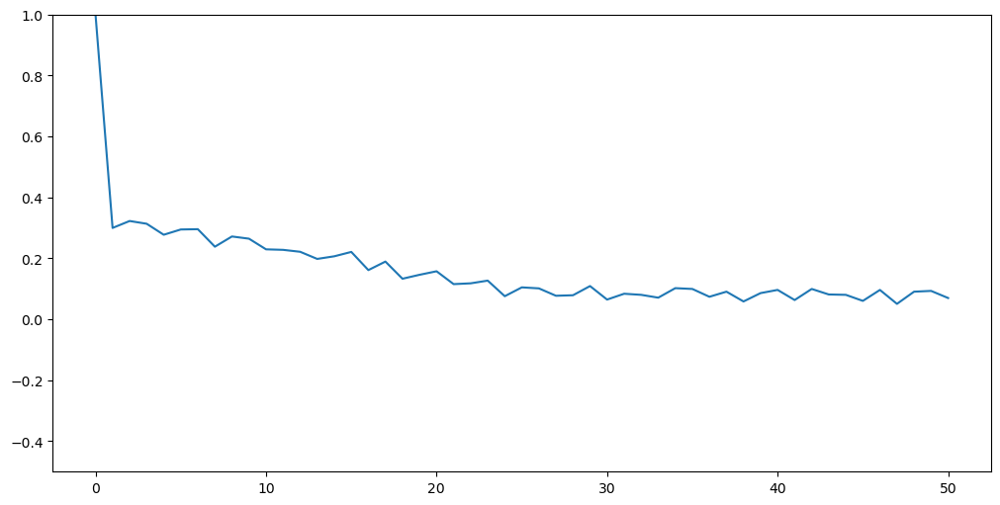

0       0.000000
1       0.005565
2       0.004427
3       0.007713
4       0.009543
          ...   
2512    0.008610
2513    0.001342
2514    0.002277
2515    0.004767
2516    0.003219
Name: pct_return, Length: 2517, dtype: float64

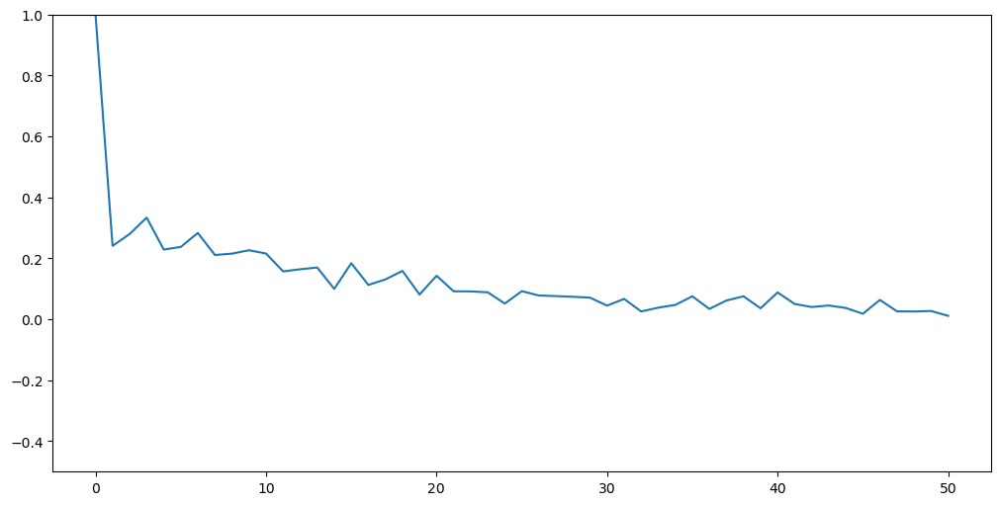

0       0.000000
1       0.008265
2       0.004514
3       0.005131
4       0.005998
          ...   
2512    0.009887
2513    0.005320
2514    0.004335
2515    0.004316
2516    0.000056
Name: pct_return, Length: 2517, dtype: float64

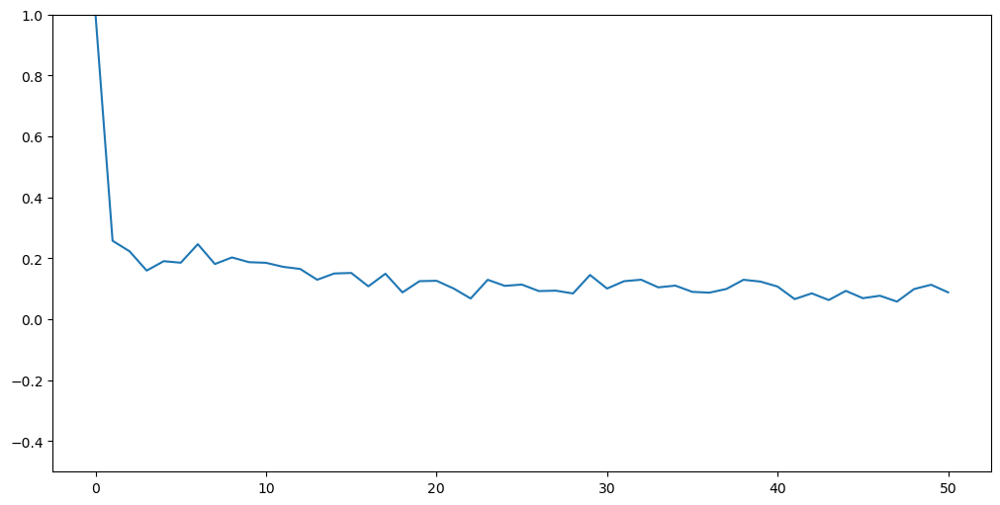

0       0.000000
1       0.001045
2       0.010433
3       0.006970
4       0.002079
          ...   
2512    0.011092
2513    0.003135
2514    0.001823
2515    0.002469
2516    0.006482
Name: pct_return, Length: 2517, dtype: float64

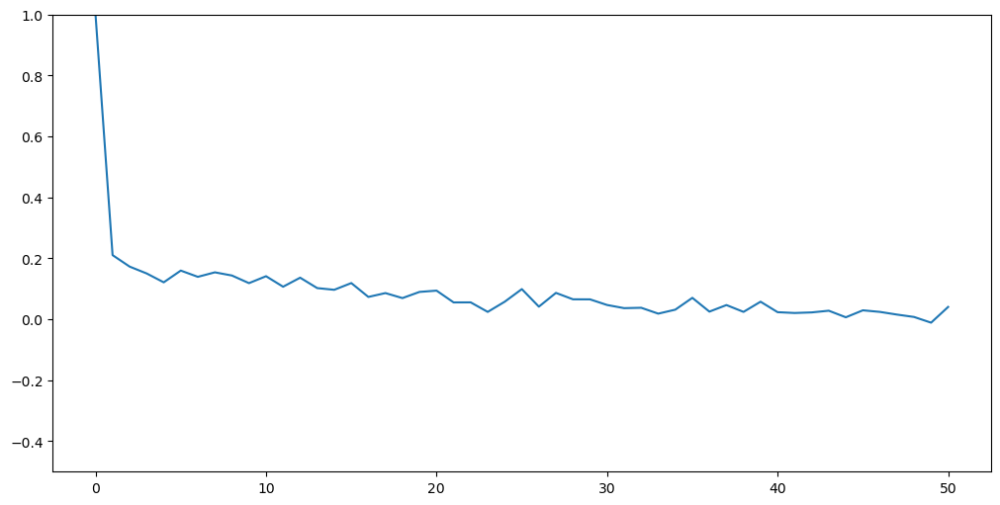

0       0.000000
1       0.023534
2       0.010219
3       0.015535
4       0.013163
          ...   
2512    0.023186
2513    0.003504
2514    0.002051
2515    0.007691
2516    0.008841
Name: pct_return, Length: 2517, dtype: float64

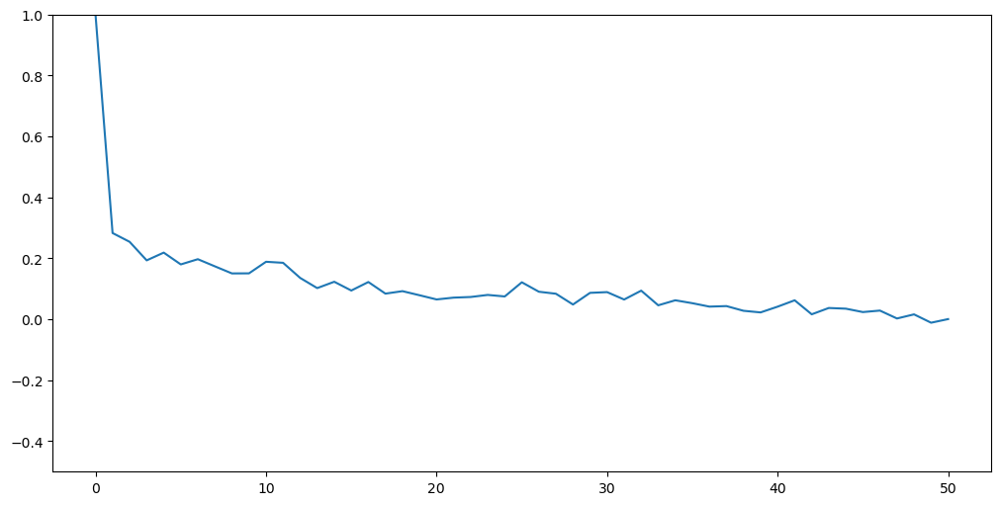

0       0.000000
1       0.014565
2       0.000611
3       0.001732
4       0.003674
          ...   
2512    0.011529
2513    0.006922
2514    0.014181
2515    0.007643
2516    0.004896
Name: pct_return, Length: 2517, dtype: float64

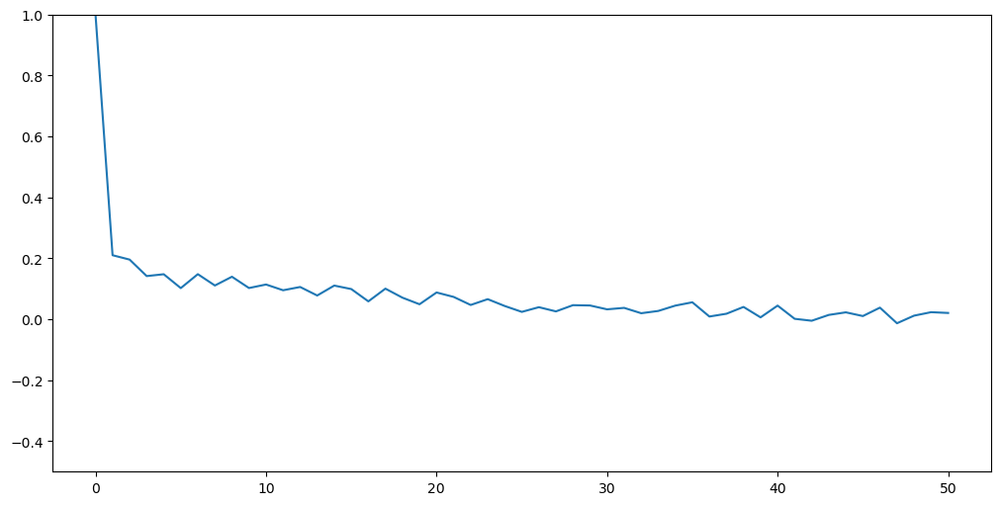

0       0.000000
1       0.000449
2       0.004192
3       0.002405
4       0.004219
          ...   
2512    0.011680
2513    0.005371
2514    0.008290
2515    0.008648
2516    0.004976
Name: pct_return, Length: 2517, dtype: float64

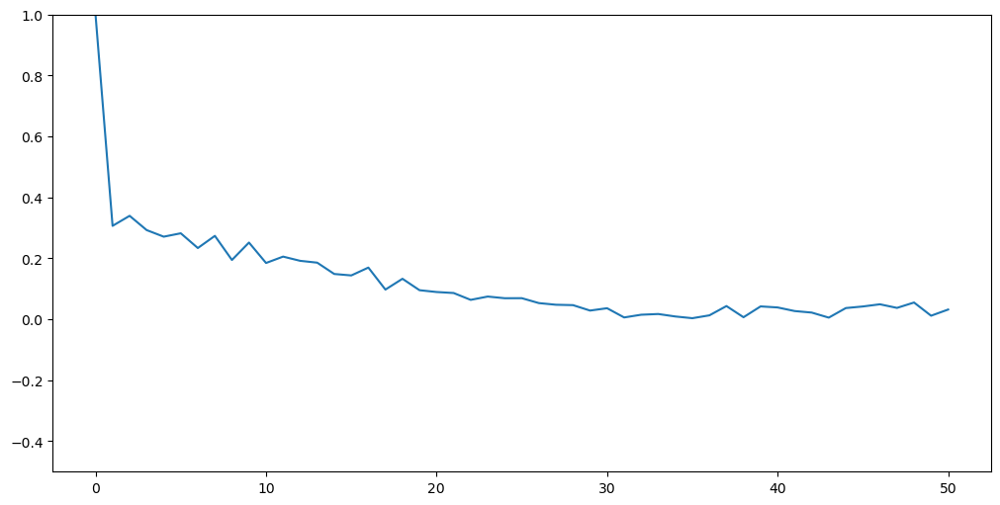

0       0.000000
1       0.004068
2       0.009872
3       0.000337
4       0.005729
          ...   
2512    0.008988
2513    0.006921
2514    0.002419
2515    0.004381
2516    0.002423
Name: pct_return, Length: 2517, dtype: float64

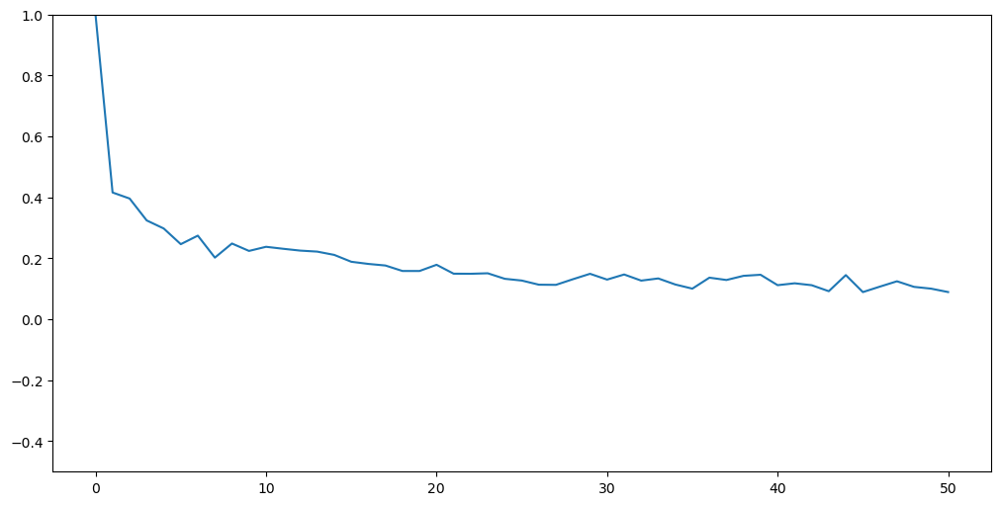

0       0.000000
1       0.014566
2       0.006700
3       0.003613
4       0.001137
          ...   
2512    0.008317
2513    0.006887
2514    0.005249
2515    0.002275
2516    0.004540
Name: pct_return, Length: 2517, dtype: float64

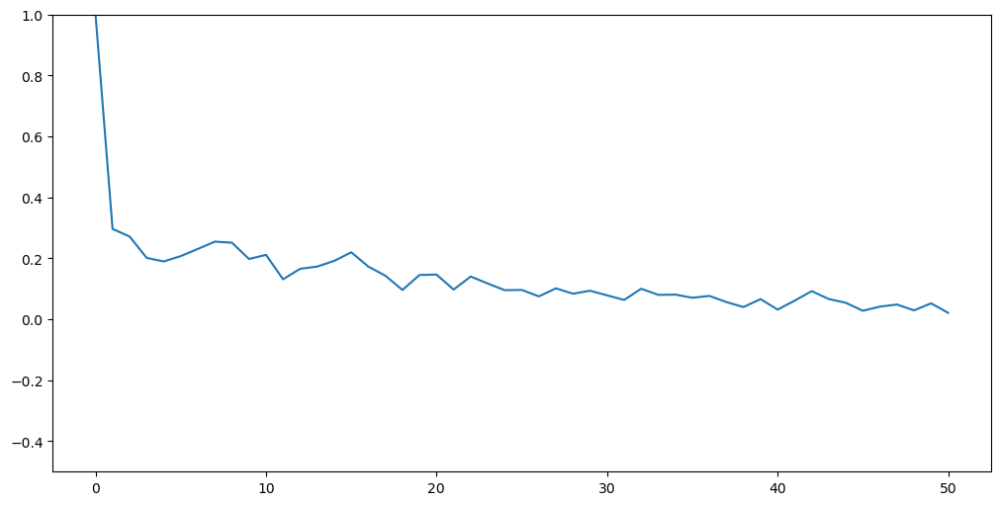

0       0.000000
1       0.017865
2       0.007513
3       0.011775
4       0.008043
          ...   
2512    0.004663
2513    0.001930
2514    0.000550
2515    0.001375
2516    0.005324
Name: pct_return, Length: 2517, dtype: float64

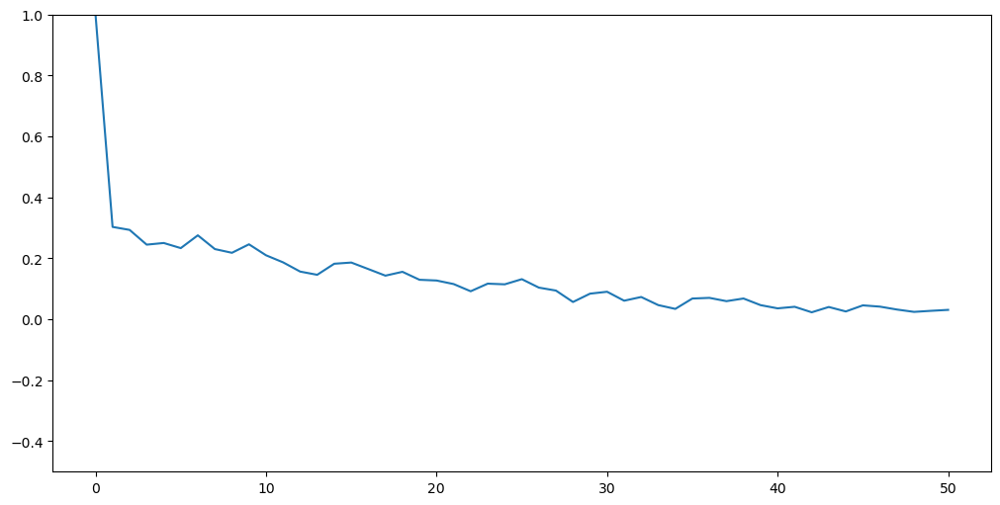

0       0.000000
1       0.013088
2       0.006886
3       0.002861
4       0.001043
          ...   
2512    0.000000
2513    0.000759
2514    0.006829
2515    0.002101
2516    0.005550
Name: pct_return, Length: 2517, dtype: float64

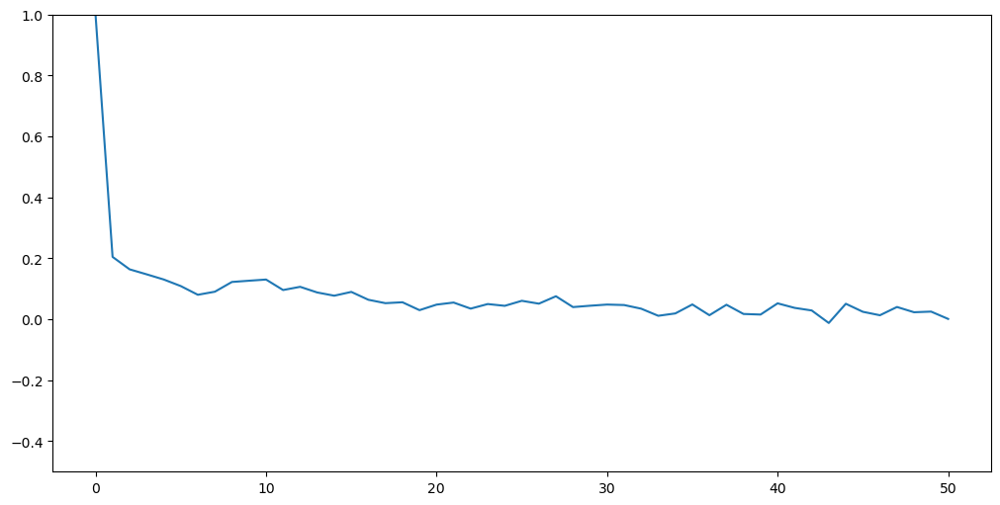

0       0.000000
1       0.006957
2       0.003351
3       0.011003
4       0.012696
          ...   
2512    0.004952
2513    0.013799
2514    0.015944
2515    0.004976
2516    0.003270
Name: pct_return, Length: 2517, dtype: float64

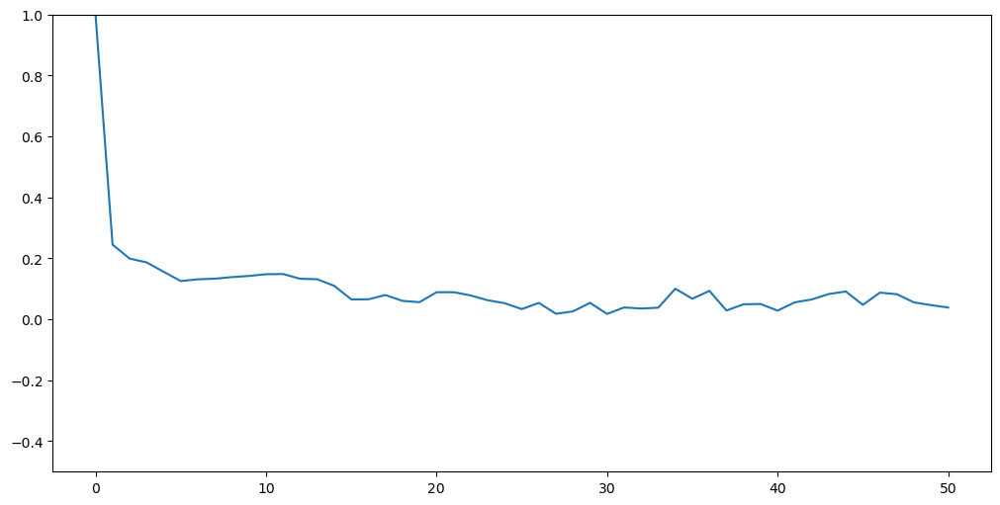

0       0.000000
1       0.010277
2       0.004857
3       0.007068
4       0.003051
          ...   
2512    0.009105
2513    0.014351
2514    0.000490
2515    0.003223
2516    0.010617
Name: pct_return, Length: 2517, dtype: float64

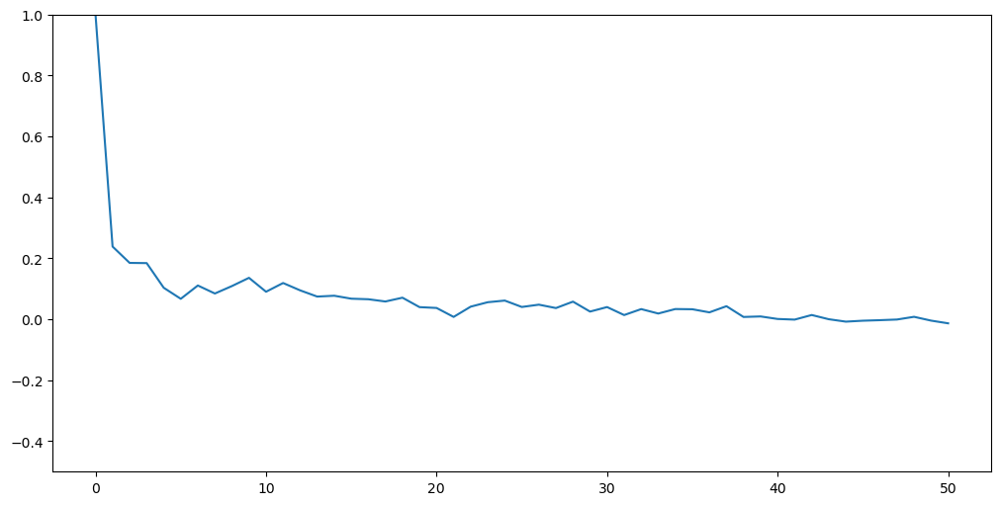

In [32]:
for i,tic in enumerate(tics):
    values=np.abs(data_dict[tic]['pct_return'])
    display(values)
    corr_list=[]
    fig, ax = plt.subplots(1, 1, figsize=(10,5),constrained_layout=True)
#     for n in range(50):
    corr=sm.tsa.acf(values, nlags=50)
        # using shift function to shift the values.
#         dataframe = pd.concat([values.shift(1*n), values], axis=1)

        # using corr() function to compute the correlation
#         result = dataframe.corr().iloc[0,1]
#         result = np.correlate(values, values.shift(1*n), mode='full')
#         display(result)
#         corr_list.append(result)
    ax.plot(corr)
    ax.set_ylim([-0.5, 1])
    plt.show()

# key take away:
1. return and log return behaves similar
2. autocorrelation can be used as a auxiliary metric
3. abs autocorrelation will converge to some postive value

# Conlucsion：
1. use return and abs return auto-correlation as auxiliary metrics

In [48]:
for tic in tics:
    data_dict[tic]['moving_std_252'] = data_dict[tic][['log_rtn']].rolling(window=252).std()
    data_dict[tic]['moving_std_21'] = data_dict[tic][['log_rtn']].rolling(window=21).std()

In [60]:
def linear_regession_plot_with_auxiliary_data(data,tic,y_pred_list,turning_points,low,high,savefig,normalized_coef_list,auxiliary_datas,regime_num=4):
    data=data.reset_index(drop=True)
    fig, ax = plt.subplots(3, 1, figsize=(20, 10),constrained_layout=True)
    ax2=ax[2].twinx()
    for i,auxiliary_data in enumerate(auxiliary_datas):
        ax2.plot(auxiliary_data,label='auxiliary_data_'+str(i))
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    seg1,seg2,seg3=sorted([low,high,0])
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y_pred = y_pred_list[i]
        coef=normalized_coef_list[i]
        flag=regime_flag(regime_num,coef,[seg1,seg2,seg3])
        ax[1].plot(x_seg,y_pred,color=colors[flag], label='cat'+str(flag))
        ax[2].plot(x_seg,data['adjcp'].iloc[turning_points[i]:turning_points[i+1]],color=colors[flag], label='cat'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    ax[0].set_title(tic+'_linear_regression_regime',fontsize=20)
    plt.show()
    if savefig:
        fig.savefig('res/linear_model/'+tic+'.png')

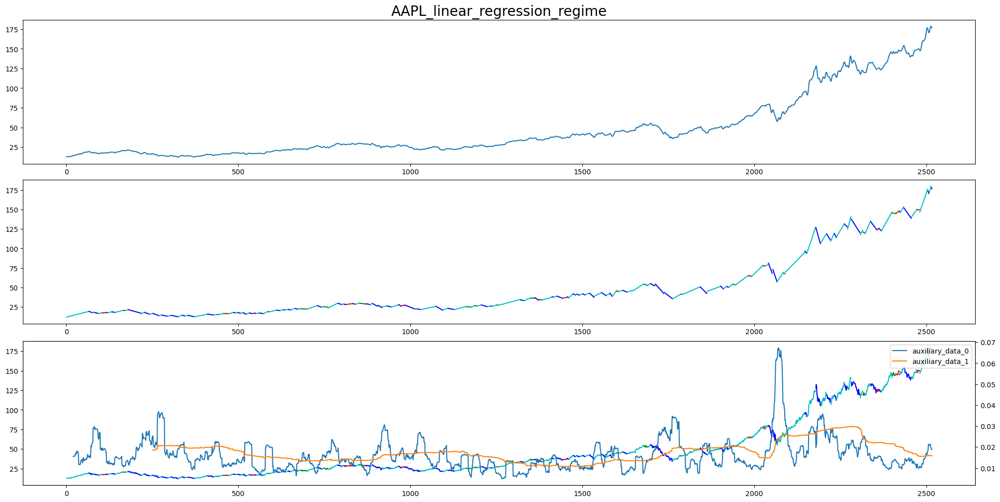

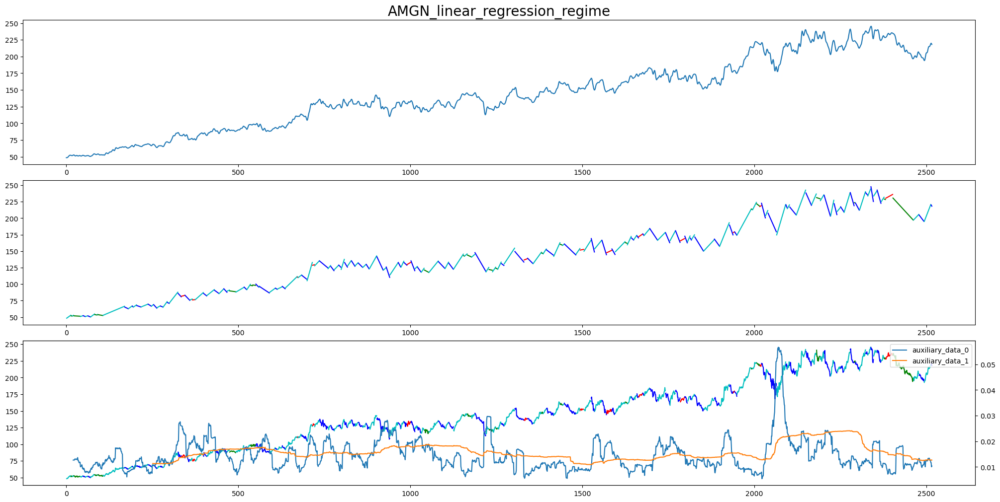

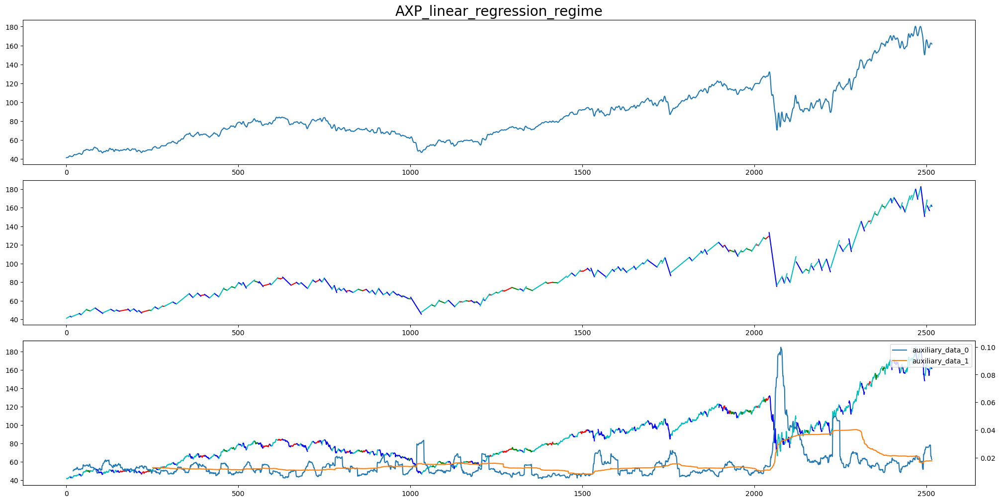

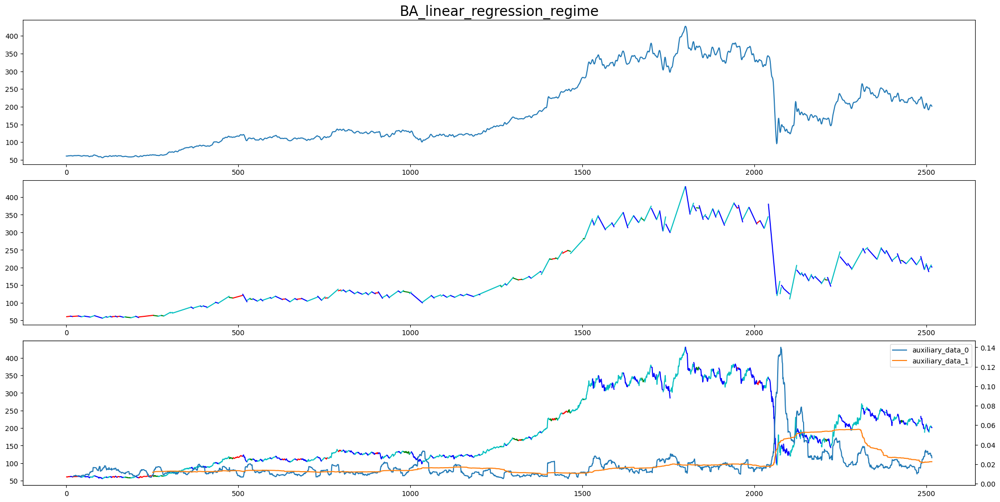

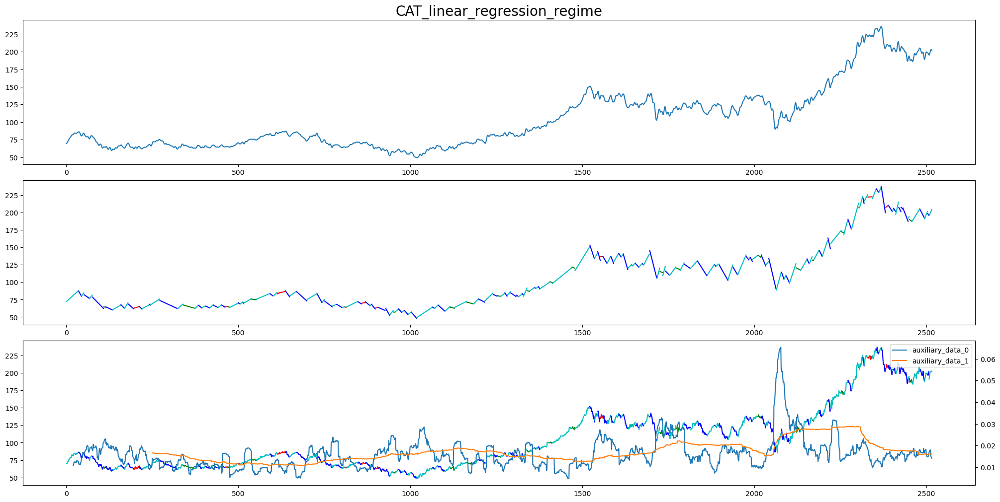

...

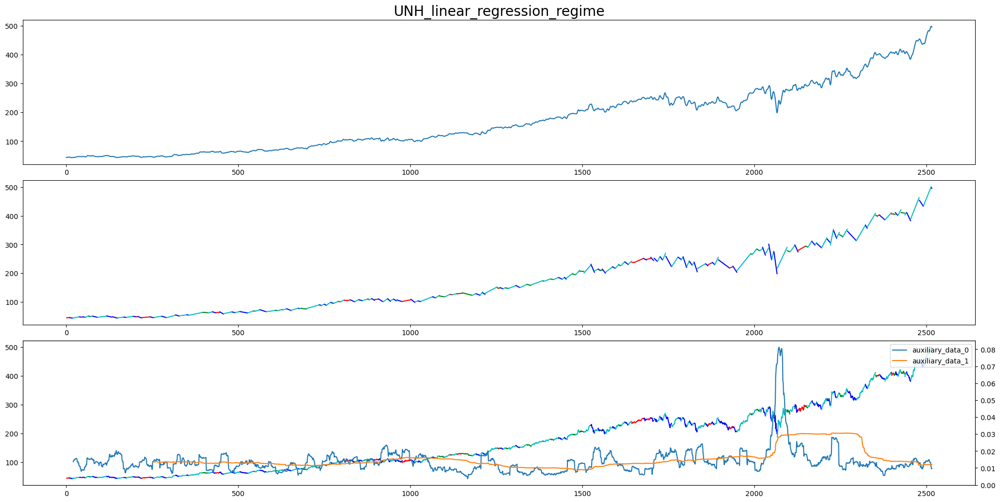

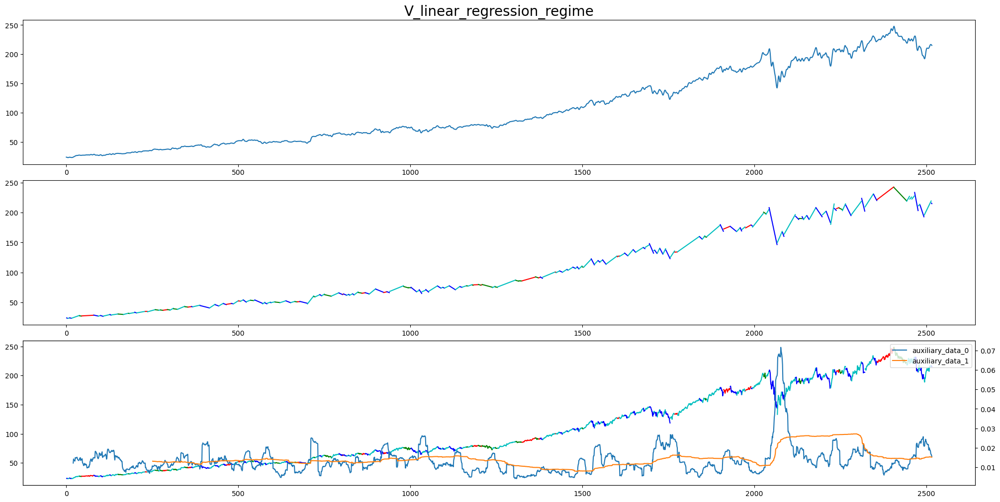

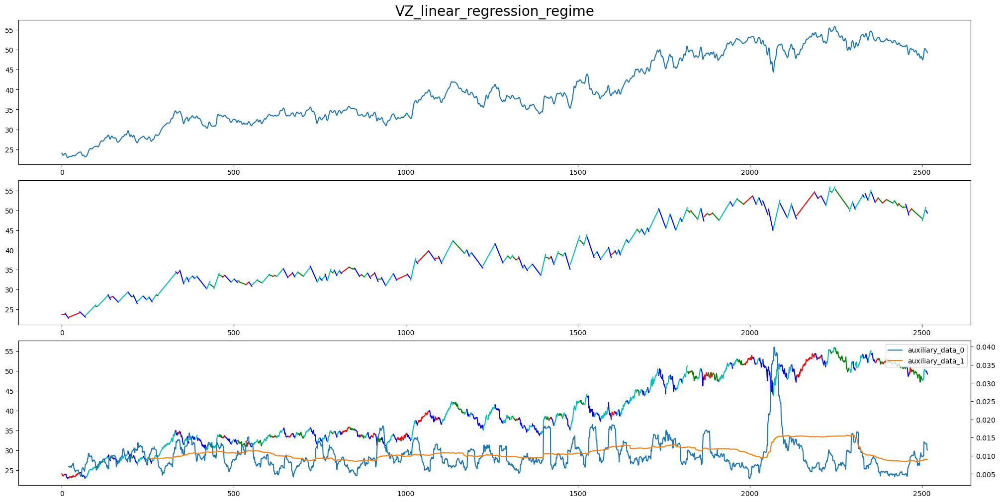

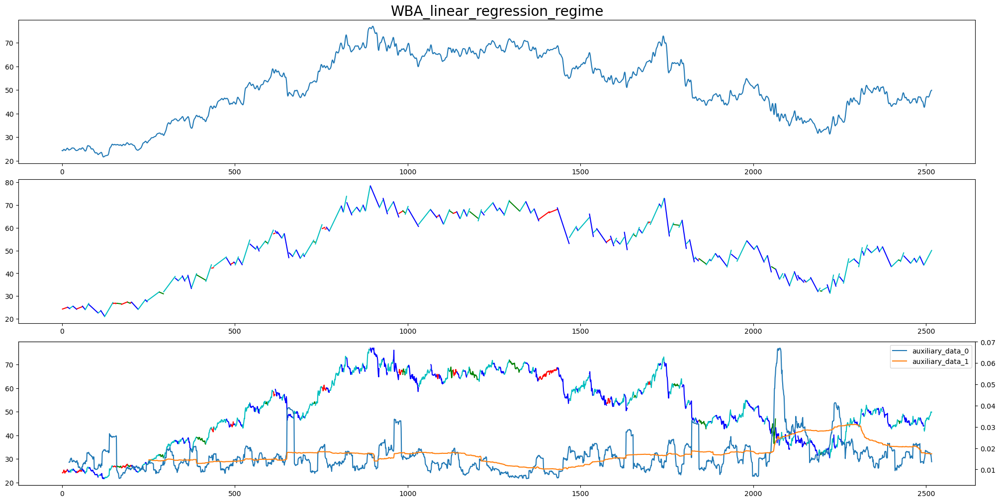

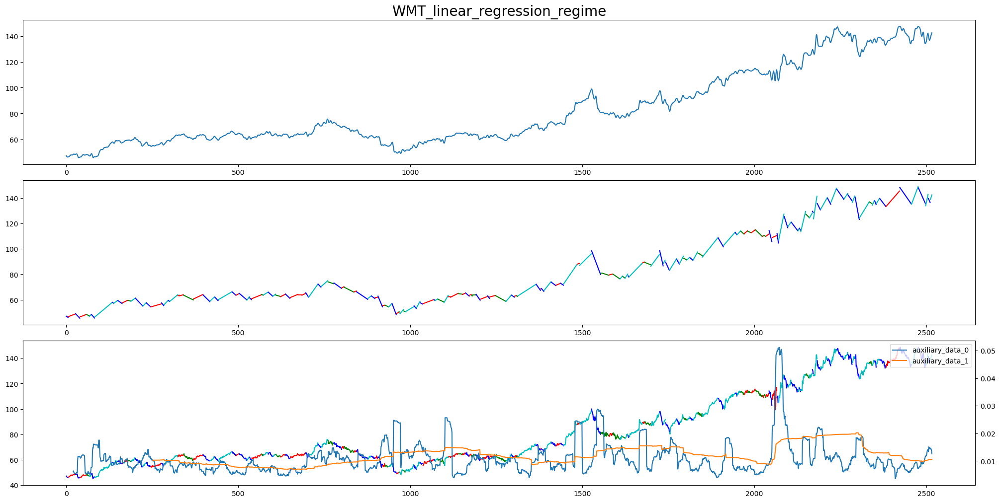

In [61]:
for tic in tics:
    aux_datas=[data_dict[tic]['moving_std_21'],data_dict[tic]['moving_std_252']]
    linear_regession_plot_with_auxiliary_data(data_dict[tic],tic,y_pred_dict[tic],turning_points_dict[tic],-0.25,0.25,False,norm_coef_list_dict[tic],aux_datas)

# key take away:
1.leverage effect is significantly different on different regimes
2.shorter time window works better

# Conlucsion：
1. use time winodow std as a auxiliary loss for different regime

/tmp/ipykernel_2862503/4002919165.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


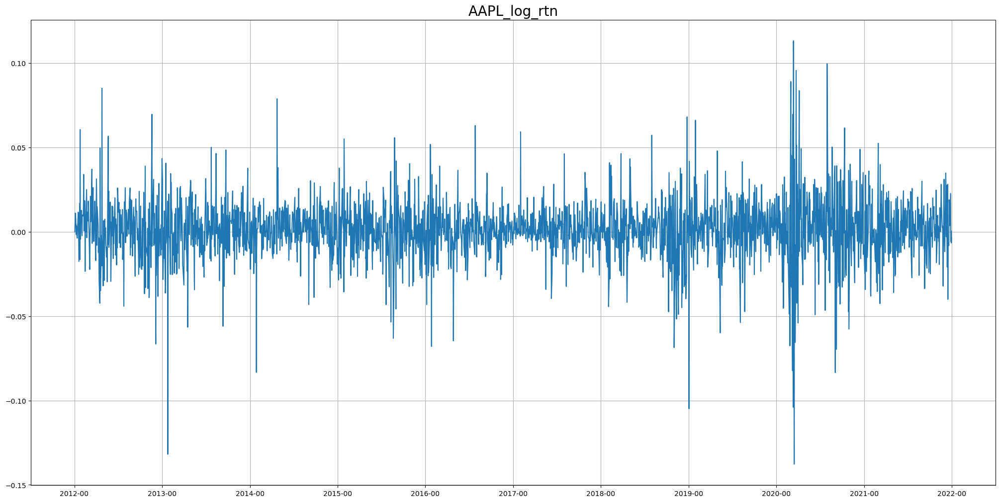

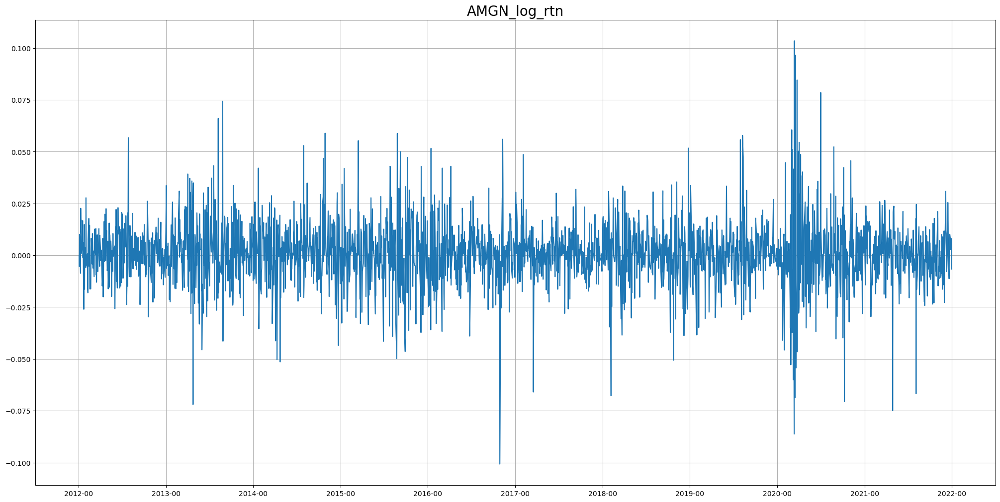

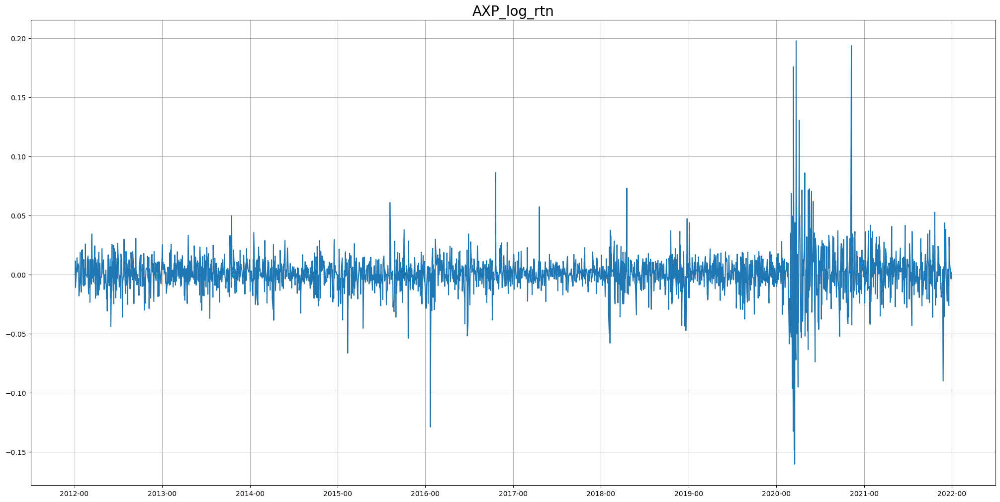

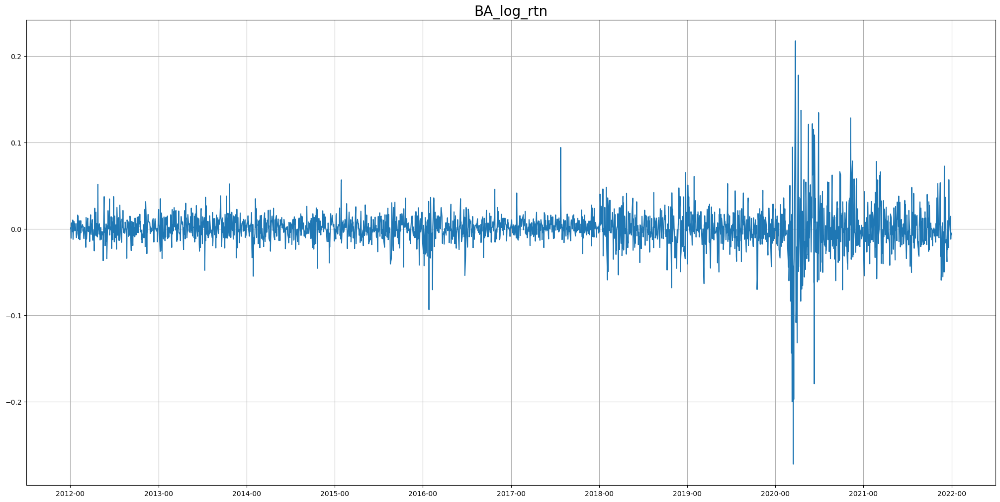

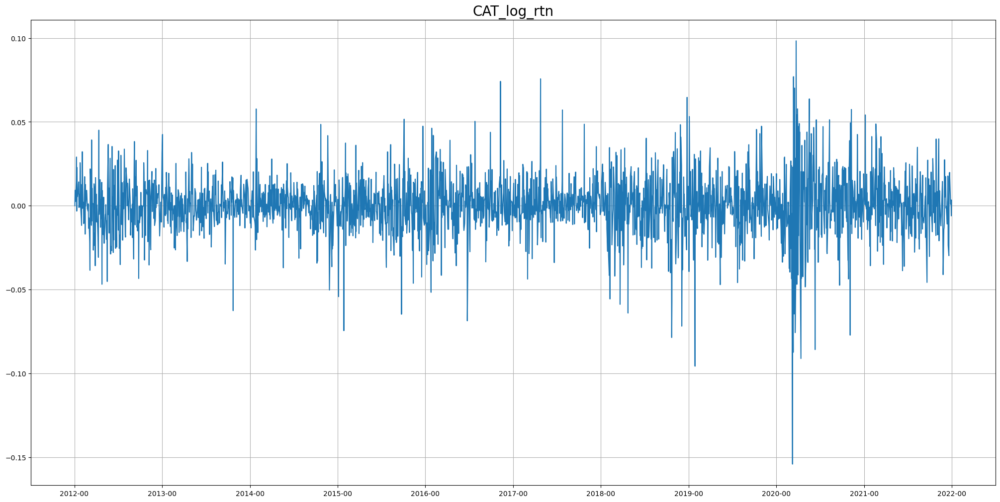

...

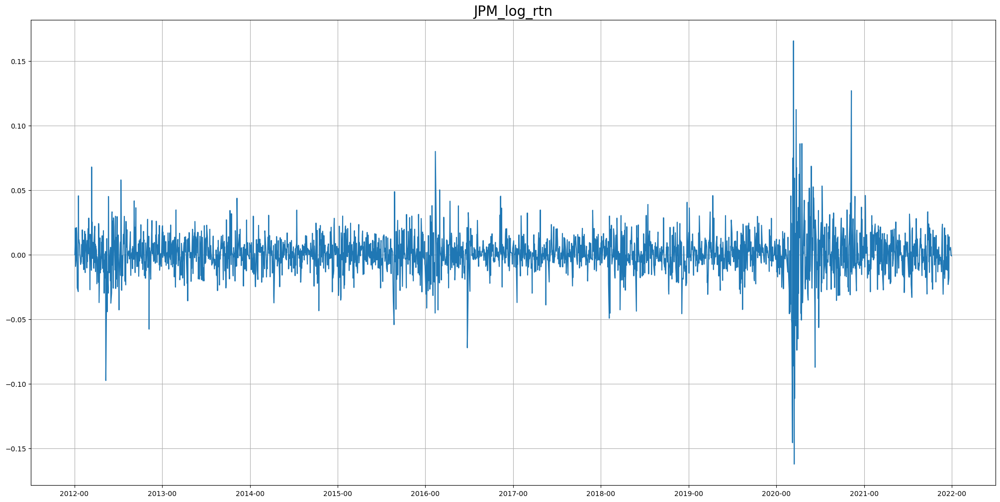

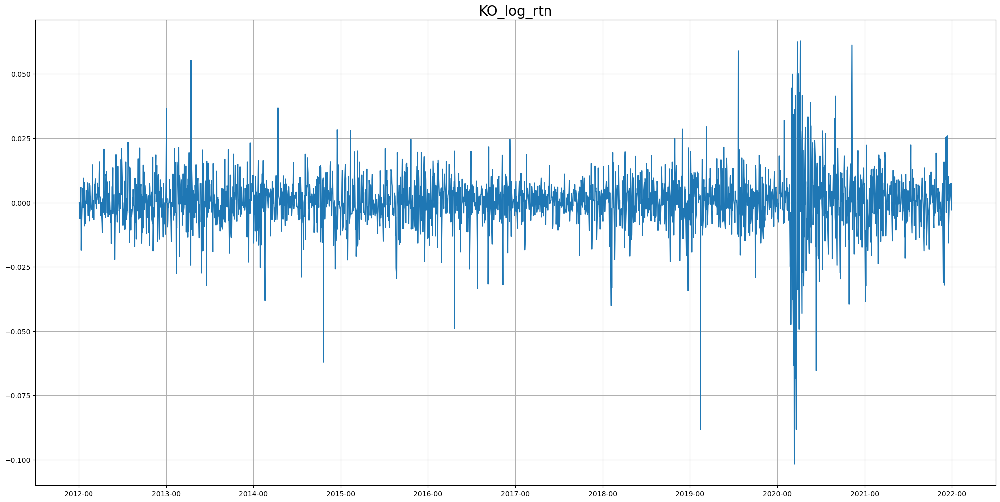

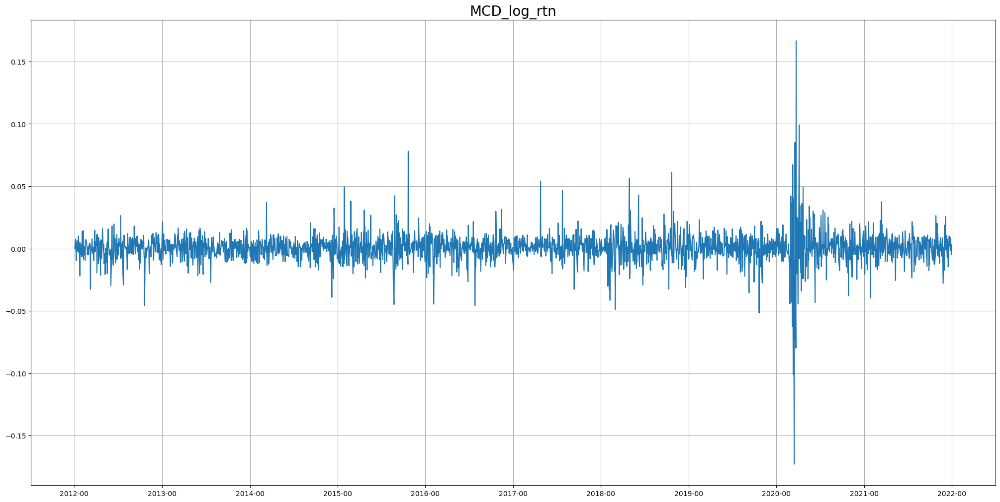

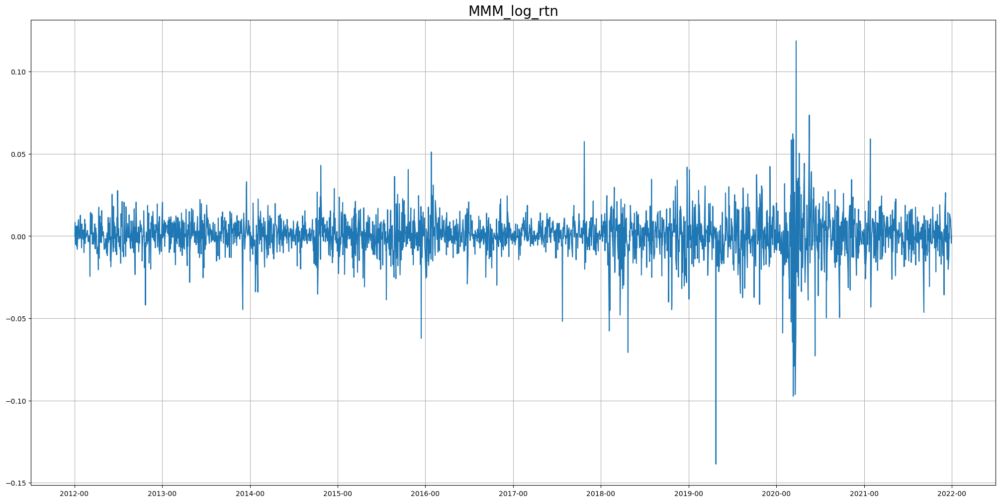

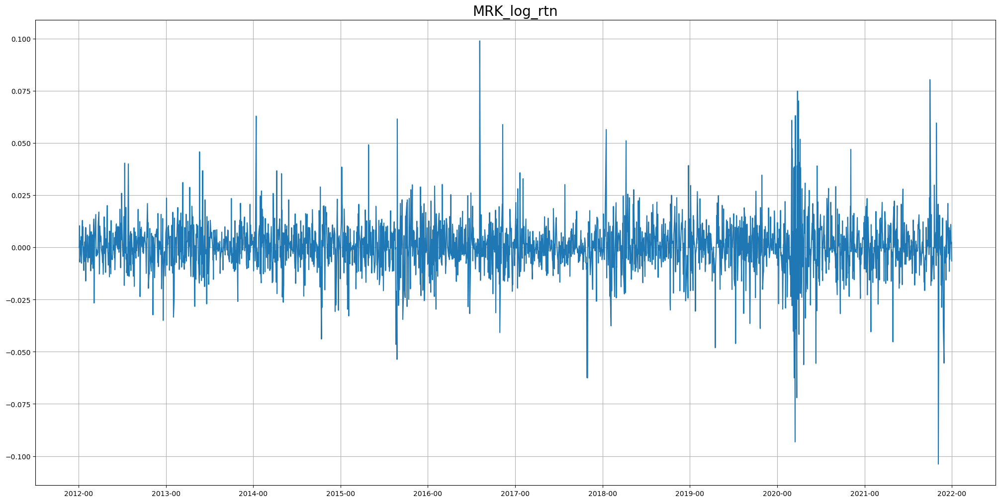

In [ ]:
for tic in tics:
    plot_feature(data_dict[tic],tic,'log_rtn')

/tmp/ipykernel_2862503/4002919165.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


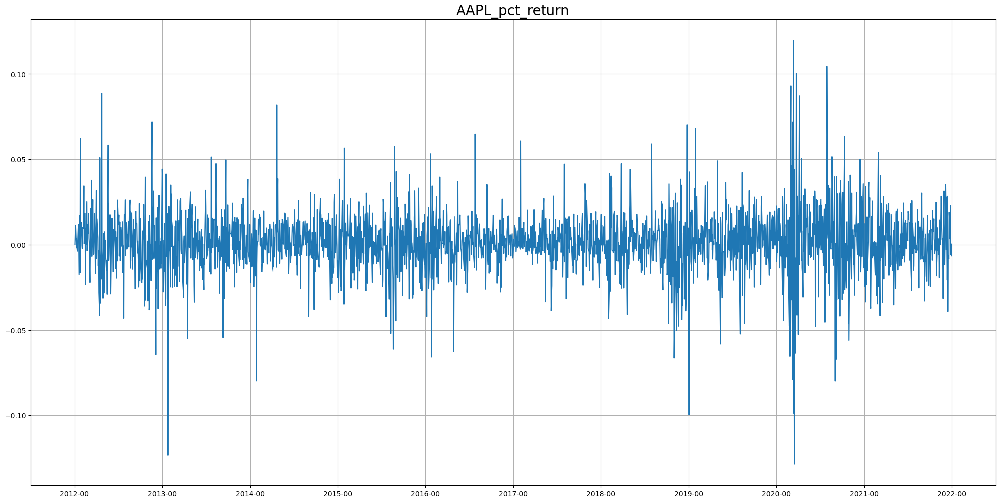

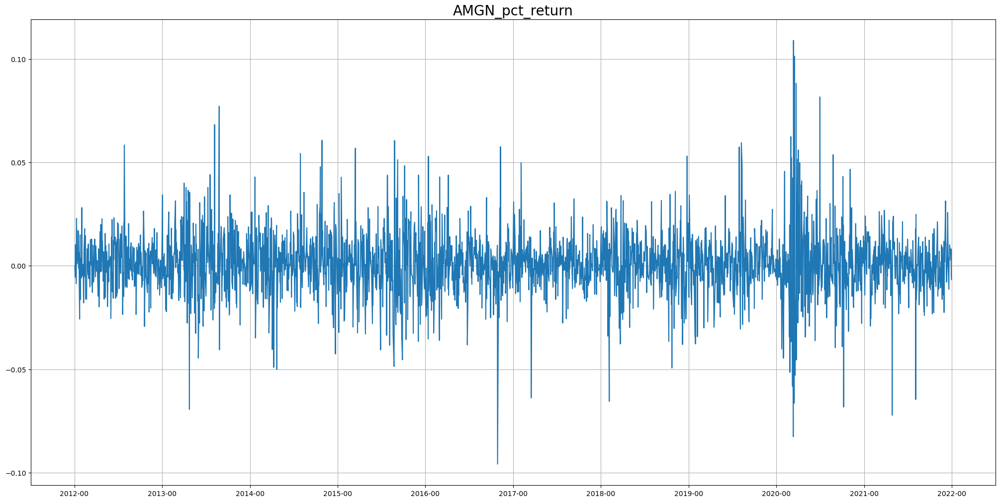

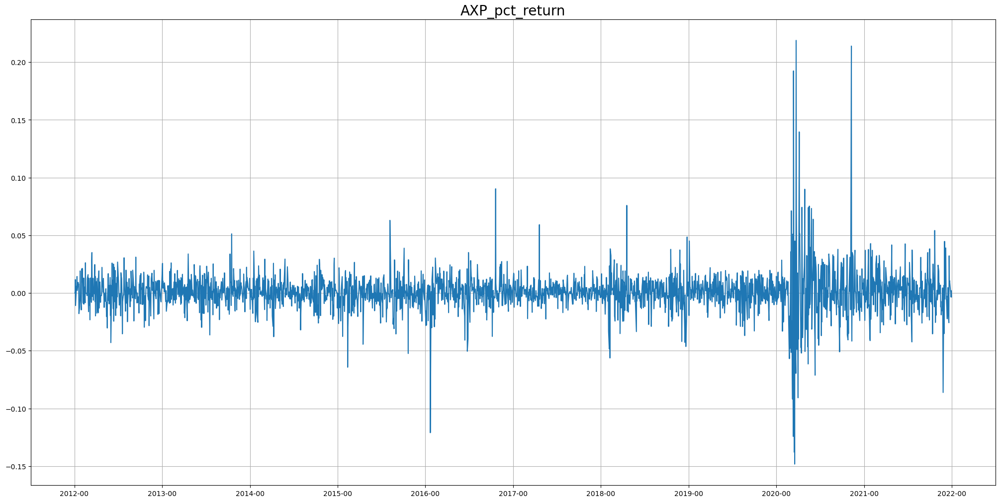

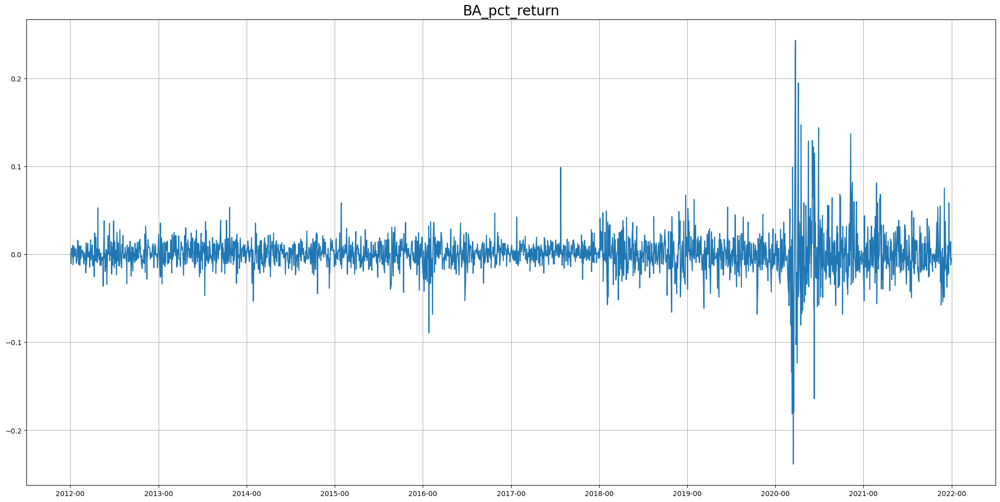

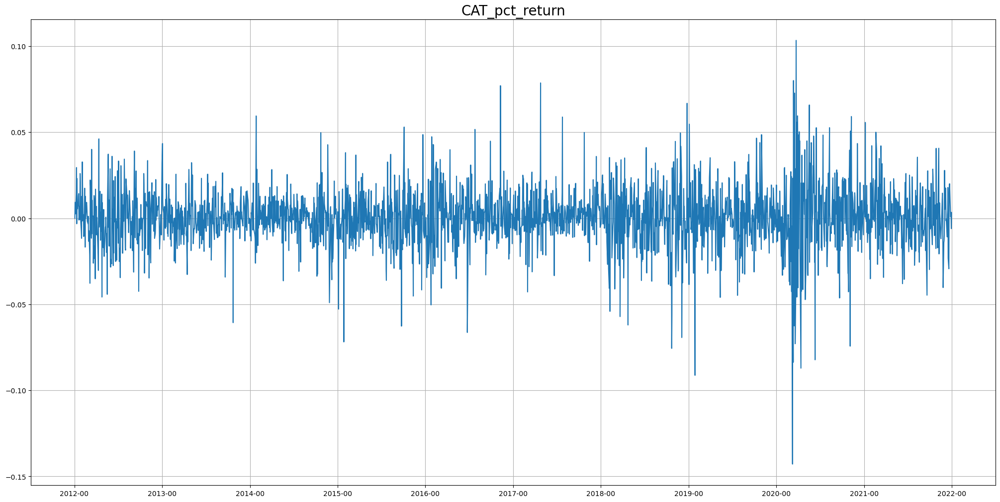

...

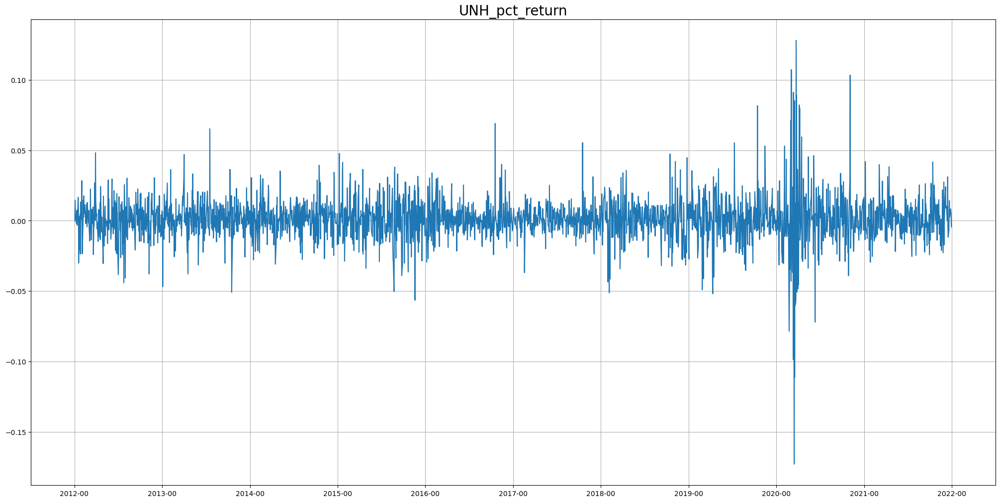

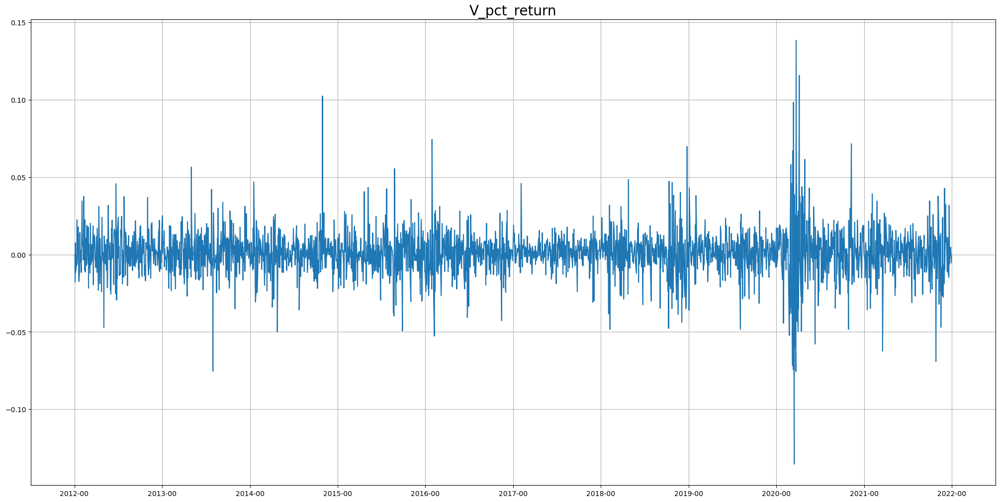

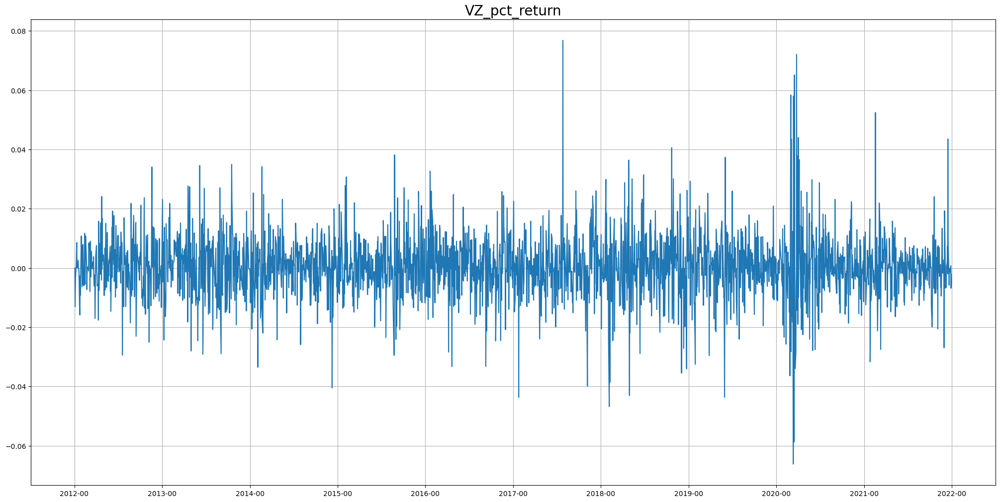

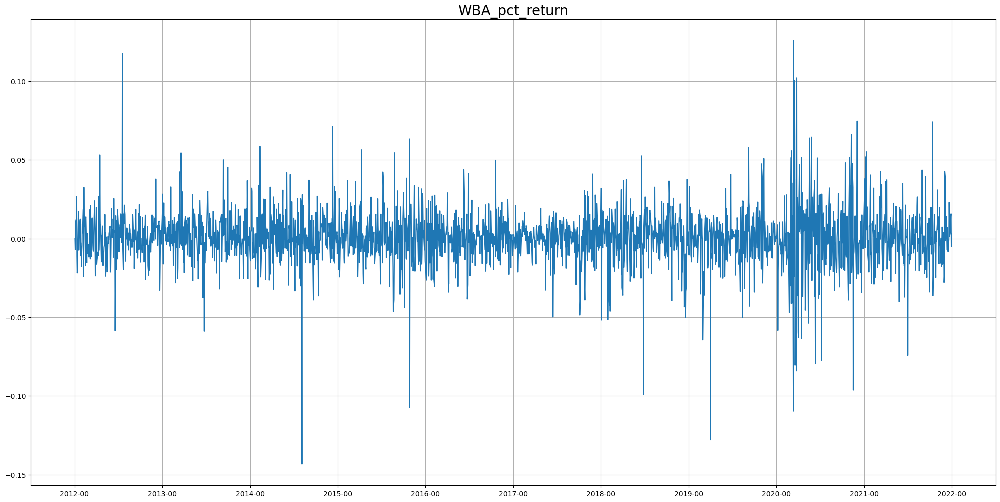

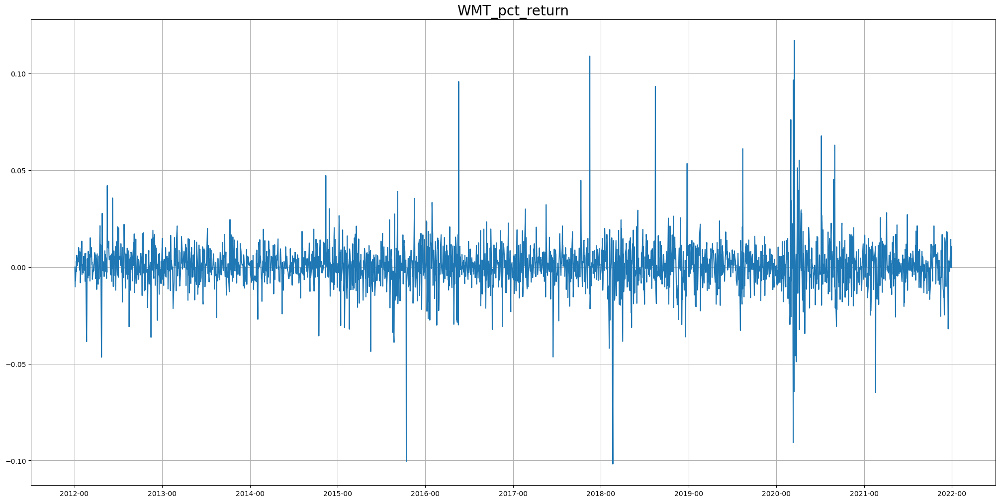

In [19]:
for tic in tics:
    plot_feature(data_dict[tic],tic,'pct_return')